## Scripts to create runoff plots for different (selected) basins 

In [1]:
# updated script version for flattening gfdl-esm2m overshoot stabilisation scenarios from university of Bern 
from oggm import utils
import json
import oggm
import sys
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
# get the correct colors for the different scenarios
from analysis_func import color_scenario, label_scenario, provide_reg_full_name_dict, color_scenario_poster

palette = sns.color_palette(color_scenario.values())
import geopandas as gpd


In [2]:
bc = 'bc_1980_2019'
df_scenario_common_basin = xr.open_dataset(f'common_running_sum_all_basins_oversh_stab_2000_2500_bc_1980_2019.nc').sel(bias_correction=bc)
pd_basin_num = gpd.read_file('/home/www/fmaussion/misc/magicc/basins_shape/glacier_basins.shp')
f = open('/home/www/lschuster/provide/provide_glacier_regions/basin_ids_per_provide_region.json')
basins_per_preg = json.load(f)

df_scenario_common_basin['runoff_51_yr_avg'] = df_scenario_common_basin.runoff.isel(time=slice(0,-1)).rolling(min_periods=51, time=51, center=True).mean()
df_scenario_common_basin['runoff_21_yr_min'] = df_scenario_common_basin.runoff.isel(time=slice(0,-1)).rolling(min_periods=21, time=21, center=True).min()
df_scenario_common_basin['runoff_m_51_yr_avg'] = df_scenario_common_basin.runoff_monthly.isel(time=slice(0,-1)).rolling(min_periods=51, time=51, center=True).mean()
df_scenario_common_basin['melt_off_on_51_yr_avg'] = df_scenario_common_basin.melt_off_on.isel(time=slice(0,-1)).rolling(min_periods=51,
                                                                                                                        time=51, center=True).mean()

pd_runoff_scenario_rel_basin = (100*df_scenario_common_basin/df_scenario_common_basin.sel(time=2025)).runoff_51_yr_avg.to_dataframe('runoff_rel_2000_2050_%').reset_index()
pd_melt_off_on_scenario_rel_basin = (100*df_scenario_common_basin/df_scenario_common_basin.sel(time=2025)).melt_off_on_51_yr_avg.to_dataframe('melt_off_on_rel_2000_2050_%').reset_index()
pd_runoff_scenario_rel_basin_21_yr_min = (100*df_scenario_common_basin/df_scenario_common_basin.sel(time=2010)).runoff_21_yr_min.to_dataframe('runoff_min_rel_2000_2020_%').reset_index()
assert np.all(df_scenario_common_basin.runoff.sel(time=slice(2000,2020)).min(dim='time') == df_scenario_common_basin.sel(time=2010).runoff_21_yr_min)

df_scenario = xr.open_dataset(f'common_running_sum_all_provide_reg_oversh_stab_2000_2500_bc_1980_2019.nc')

df_scenario['runoff_51_yr_avg'] = df_scenario.runoff.isel(time=slice(0,-1)).rolling(min_periods=51,
                                                                                    time=51, center=True).mean()

In [44]:

label_scenario_david = {'stab_T12': '1.2°C Stabilisation',
 'oversh_T30OS15': r'3.0$\rightarrow$1.5°C Overshoot',
 'stab_T15': r'1.5°C Stabilisation',
 'stab_T30': r'3.0°C Stabilisation'}
scenario_ls = {'stab_T12': '-',
 'stab_T15': '-',
 'oversh_T30OS15': '--',
 'stab_T30': '-'}
scenarios = ['stab_T15', 'stab_T30', 'oversh_T30OS15']
list_color_scenario_poster_new_order = [(0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
                                        (0.8, 0.47058823529411764, 0.7372549019607844),
                                        (0.8352941176470589, 0.3686274509803922, 0.0)]
list_style = ['-','--']

**Some overall statistics**

In [4]:
len(pd_basin_num)

75

In [5]:
pd_basin_num.CONTINENT.unique()

array(['Asia', 'South America',
       'North America, Central America and the Caribbean',
       'South-West Pacific', 'Europe'], dtype=object)

In [6]:
len(pd_basin_num.loc[(pd_basin_num.RGI_AREA>30)&(100*pd_basin_num.RGI_AREA/pd_basin_num.AREA_CALC>0.01)])

75

In [7]:
len(pd_basin_num.loc[(pd_basin_num.RGI_AREA>30)&(100*pd_basin_num.RGI_AREA/pd_basin_num.AREA_CALC>0.01)& (pd_basin_num.AREA_CALC>50000)])

39

In [8]:
len(pd_basin_num.loc[(pd_basin_num.RGI_AREA>30)&(100*pd_basin_num.RGI_AREA/pd_basin_num.AREA_CALC>0.01)& (pd_basin_num.AREA_CALC>5000)])

72

In [9]:
100*(pd_basin_num.RGI_AREA/pd_basin_num.AREA_CALC).min()

0.011259669461938704

**compute some statistics for every basin**

In [ ]:
# some basin climate data
pd_clim_all = pd.read_csv('../annual_glob_rgi_reg_basin_temp_precip_timeseries_oversh_stab.csv', index_col = 'Unnamed: 0')
pd_clim_all['precip_51yr_avg'] = pd_clim_all['precip'].rolling(51,center=True, min_periods=51).mean()

In [12]:
## from Ultee, 2022, drought buffer glaciers ...  (her table A1)

basin_names = ['INDUS','TARIM','BRAHMAPUTRA','ARAL SEA','COPPER','GANGES','YUKON','ALSEK','SUSITNA','BALKHASH','STIKINE','SANTA CRUZ',
'FRASER','BAKER','YANGTZE','SALWEEN','COLUMBIA','ISSYK-KUL','AMAZON','COLORADO','TAKU','MACKENZIE','NASS','THJORSA','JOEKULSA A F.',
'KUSKOKWIM','RHONE','SKEENA','OB','OELFUSA','MEKONG','DANUBE','NELSON RIVER','PO','KAMCHATKA','RHINE','GLOMA','HUANG HE','INDIGIRKA',
'LULE','RAPEL','SANTA','SKAGIT','KUBAN','TITICACA','NUSHAGAK','BIOBIO','IRRAWADDY','NEGRO','MAJES','CLUTHA','DAULE-VINCES',
'KALIXAELVEN','MAGDALENA','DRAMSELV','COLVILLE']

basin_glacier_area_km2 = [26893.8, 24645.4, 16606.7, 15176.7, 12998., 11216., 9535.4, 5614.8, 4304., 
3945.4, 3467.6, 3027.8, 2495.1, 2372.3, 2317.4, 2295.9, 1878.4, 1677.3,
1634.1, 1601.2, 1583.6, 1519.2, 1337.3, 1251.8, 1098.6, 1032.8, 904.2, 742.3,
739.5, 683.4, 485.7, 408.4, 374.7, 347.3, 312.7, 285.0, 269.4, 267.9, 248.4,
247.2, 238.1, 198.9, 159.5, 146., 134.5, 86.4, 76.2, 71.2, 64.1, 57.3, 46.5, 
40.6, 37.9, 33.3, 32.1, 31.9]


BasinArea=[1139075,1051731,518011,1233148,64959,1024462,829632,28422,49470,423657,51147,30599,
239678,30760,1745094,258475,668561,191032,5880854,390631,17967,1752001,21211,7527,7311,
118114,97485,42944,2701040,5678,787256,793704,1099380,73066,54103,190522,42862,988062,341227,
25127,15689,11882,7961,58935,107215,29513,24108,411516,130062,18612,17118,41993,
17157,261204,17364,57544] # area of each basin in km2

# Aridity index is a multi-GCM mean over the 1980–2010 historical period
aridity_index = [
    0.54, 0.64, 2.70, 0.45, 8.98, 0.78, 2.95, 8.46, 5.54, 0.55,
    6.18, 3.47, 2.72, 4.00, 1.79, 1.80, 1.54, 0.55, 1.14, 0.56,
    6.10, 1.50, 6.02, 6.70, 8.23, 3.86, 1.90, 4.66, 1.13, 4.85,
    1.37, 1.25, 0.91, 1.57, 3.47, 2.09, 3.62, 1.15, 1.88, 3.56,
    0.67, 1.50, 2.36, 0.96, 1.91, 4.28, 1.15, 1.66, 0.96, 1.34,
    3.07, 3.02, 2.75, 1.80, 4.00, 2.66
] # precipitation vs PET (higher values indicate wetter conditions !!!

pd_basins = pd.DataFrame(index=basin_names, columns=['basin_glacier_area_km2_ultee_2022', 'basin_total_area_km2_ultee_2022', 'aridity_index_ultee_2022'])
pd_basins['basin_glacier_area_km2_ultee_2022'] = basin_glacier_area_km2
pd_basins['basin_total_area_km2_ultee_2022'] = BasinArea
pd_basins['aridity_index_ultee_2022'] = aridity_index
pd_basins['glaciated_perc_ultee_2022'] = 100*pd_basins['basin_glacier_area_km2_ultee_2022'] / pd_basins['basin_total_area_km2_ultee_2022']
pd_basin_num['glaciated_vs_basin_area_RGI6_perc'] = 100*pd_basin_num['RGI_AREA']/pd_basin_num['AREA_CALC']

for _lb in pd_basins.index.values:
    if _lb not in pd_basin_num.RIVER_BASI.values:
        if _lb == 'AMAZON':
            b = 'AMAZON (also AMAZONAS)'
        elif _lb == 'JOEKULSA A F.':
            b = 'JOKULSA A FJOLLUM'
        elif _lb == 'ISSYK-KUL':
            b = 'YSYK-KOL (also ISSYK-KUL)'
        elif _lb == 'BALKHASH':
            b = 'LAKE BALKHASH'
        elif _lb == 'TARIM':
            b = 'TARIM HE (also TALIMU HE)'
        elif _lb == 'OELFUSA':
            b = 'OLFUSA'
        elif _lb == 'NELSON RIVER':
            b = 'NELSON'
        elif _lb == 'GLOMA':
            b = 'GLOMAA'
        elif _lb == 'HUANG HE':
            b = 'YELLOW RIVER'
        elif _lb == 'LULE':
            b = 'LULEALVEN'
        elif _lb == 'NEGRO':
            b = 'NEGRO (Atlantic Ocean)'
        elif _lb == 'DAULE-VINCES':
            print(f'{_lb} is probably in Ecuador but could not be found in the OGGM basin file names ... according to Ultee (2022), not enough glaciated anyways ... ')
        elif _lb == 'KALIXAELVEN':
            b = 'KALIXALVEN'
        elif _lb == 'DRAMSELV':
            b = 'DRAMSELVA'
        else:
            # ok we could rename all except for DAULE-VINCES
            print(_lb)
    else:
        b = _lb
    pd_basin_num.loc[pd_basin_num.RIVER_BASI == b, 'aridity_index_ultee_2022'] = pd_basins.loc[_lb, 'aridity_index_ultee_2022']
pd_basin_num.index = pd_basin_num['RIVER_BASI']

DAULE-VINCES is probably in Ecuador but could not be found in the OGGM basin file names ... according to Ultee (2022), not enough glaciated anyways ... 


In [13]:
pd_basin_num_glac = pd_basin_num.loc[(pd_basin_num.glaciated_vs_basin_area_RGI6_perc>0.1)]
pd_basin_num_glac.AREA_CALC.max()

1563201.7

In [14]:
pd_basin_num_glac.sort_values(by='AREA_CALC')

,MRBID,RIVER_BASI,CONTINENT,OCEAN,SEA,AREA_CALC,Shape_Leng,Shape_Area,RGI_AREA,geometry,glaciated_vs_basin_area_RGI6_perc,aridity_index_ultee_2022
RIVER_BASI,,,,,,,,,,,,
LAGARFLJOT,6104,LAGARFLJOT,Europe,Arctic Ocean,Greenland Sea,3310.7,5.700918,0.635201,154.391,"POLYGON ((-14.225 65.65, -14.22393 65.64654, -...",4.663394,NaN
AZOPARDO,3403,AZOPARDO,South America,Pacific Ocean,South Pacific,3541.6,5.514711,0.493828,30.209,"POLYGON ((-67.6116 -54.33267, -67.60417 -54.33...",0.852976,NaN
SVARTA,6110,SVARTA,Europe,Arctic Ocean,Greenland Sea,3571.4,4.883942,0.690479,277.497,"POLYGON ((-18.15417 65.07083, -18.15452 65.068...",7.769978,NaN
CISNES,3408,CISNES,South America,Pacific Ocean,South Pacific,5145.2,5.762535,0.585461,71.705,"POLYGON ((-71.41667 -44.38333, -71.41575 -44.3...",1.393629,NaN
OLFUSA,6237,OLFUSA,Europe,Atlantic Ocean,North Atlantic,5769.3,6.707480,1.080010,684.206,"MULTIPOLYGON (((-18.92083 64.825, -18.92168 64...",11.859428,4.85
JOKULSA A FJOLLUM,6101,JOKULSA A FJOLLUM,Europe,Arctic Ocean,Greenland Sea,7550.0,7.746186,1.455903,1098.648,"POLYGON ((-16.2875 64.425, -16.30242 64.42465,...",14.551629,8.23
SKAGIT,4426,SKAGIT,"North America, Central America and the Caribbean",Pacific Ocean,North Pacific,8183.1,8.505926,1.000936,181.035,"POLYGON ((-121.15 47.97917, -121.15035 47.9815...",2.212303,2.36
THJORSA,6254,THJORSA,Europe,Atlantic Ocean,North Atlantic,8277.8,9.270847,1.545336,972.419,"POLYGON ((-17.5 64.625, -17.50035 64.60591, -1...",11.747312,6.70
SERRANO,3426,SERRANO,South America,Pacific Ocean,South Pacific,8636.0,6.616997,1.110941,941.320,"POLYGON ((-72.41631 -50.63162, -72.41005 -50.6...",10.899954,NaN


In [15]:
#basin_glac = pd_basin_num.loc[pd_basin_num.glaciated_vs_basin_area_RGI6_perc>0.1].MRBID.values.astype(str)
# let's just look at all basins here 
basin_glac = pd_basin_num.MRBID.values.astype(str)

avg: 21-years
stab_T12 basins runoff below 2000-2020 avg over time 2100-2500: 62 of 75
stab_T12 basins runoff below 2000-2020 avg over time 2200-2500: 62 of 75
stab_T12 basins runoff below 2000-2020 avg over time 2300-2500: 64 of 75
['GANGES' 'INDUS' 'ARAL SEA' 'CHUY (also SHU)' 'TARIM HE (also TALIMU HE)'
 'COLORADO' 'MAGDALENA' 'NEGRO (Atlantic Ocean)' 'AZOPARDO' 'BIOBIO'
 'CISNES' 'HUASCO' 'RAPEL' 'SANTA' 'ALSEK' 'SKAGIT' 'CLUTHA'
 'JOKULSA A FJOLLUM' 'LAGARFLJOT' 'SVARTA' 'KUBAN'
 'TORNEALVEN (also TORNIONJOKI, also TORNIONVAYLA)']
['GANGES' 'INDUS' 'ARAL SEA' 'CHUY (also SHU)' 'TARIM HE (also TALIMU HE)'
 'COLORADO' 'MAGDALENA' 'NEGRO (Atlantic Ocean)' 'AZOPARDO' 'BIOBIO'
 'CISNES' 'HUASCO' 'RAPEL' 'SKAGIT' 'CLUTHA' 'JOKULSA A FJOLLUM'
 'LAGARFLJOT' 'SVARTA' 'KUBAN']
['GANGES' 'INDUS' 'ARAL SEA' 'CHUY (also SHU)' 'TARIM HE (also TALIMU HE)'
 'COLORADO' 'MAGDALENA' 'NEGRO (Atlantic Ocean)' 'AZOPARDO' 'BIOBIO'
 'CISNES' 'HUASCO' 'RAPEL' 'CLUTHA' 'JOKULSA A FJOLLUM' 'LAGARFLJOT'
 'SV

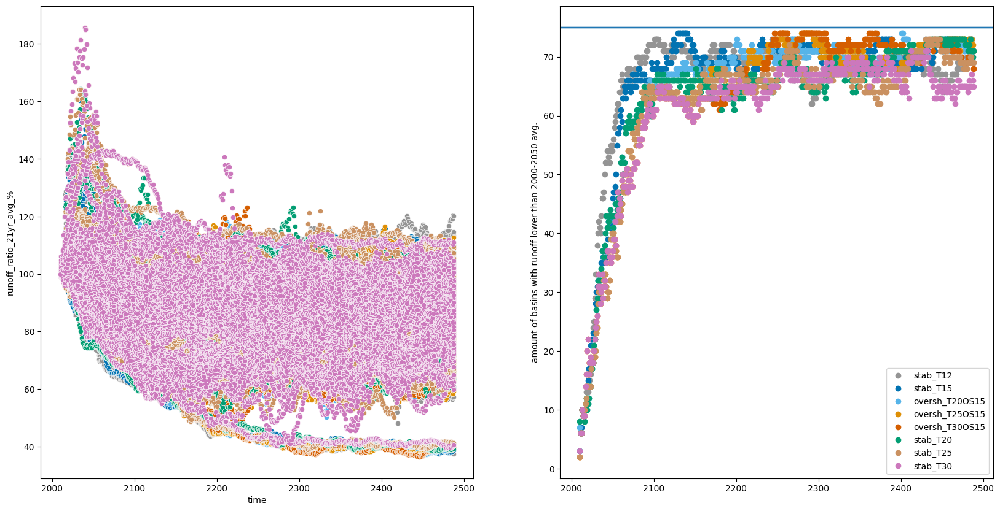

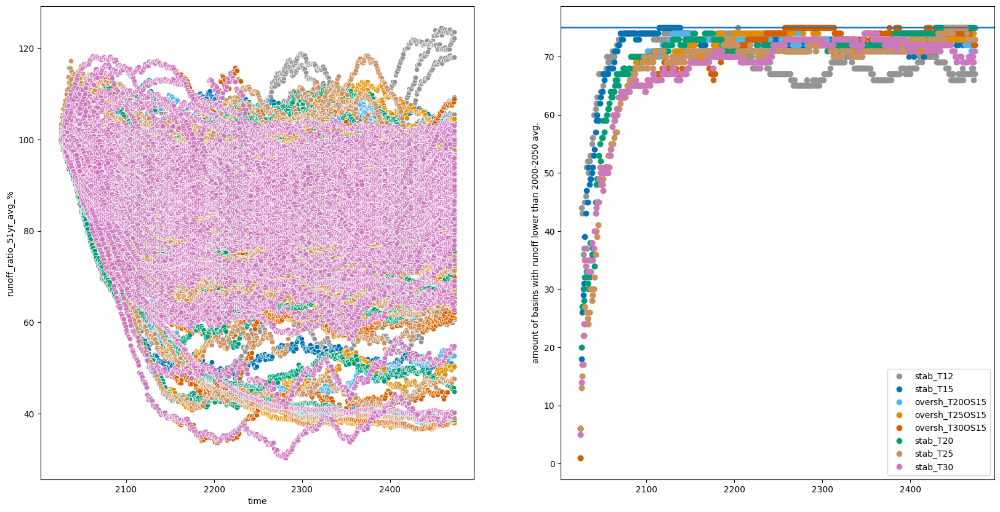

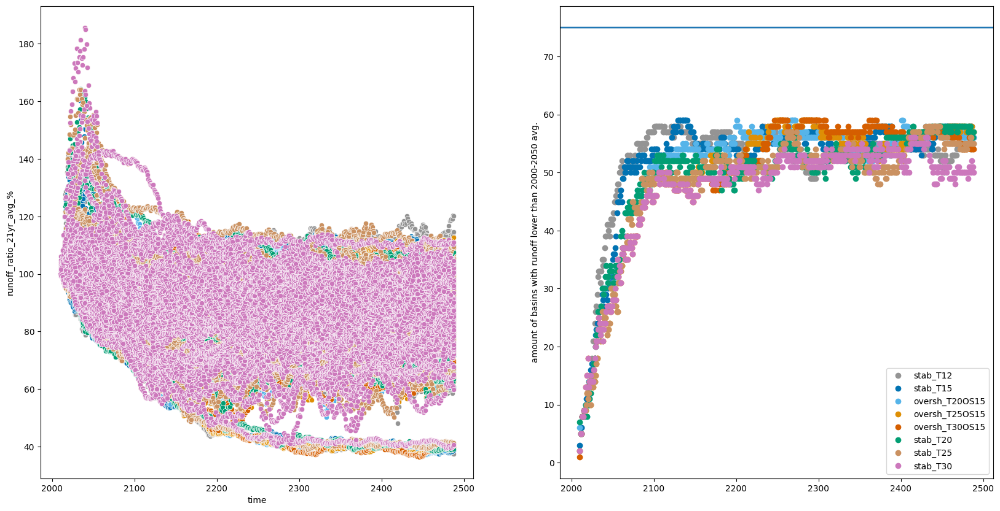

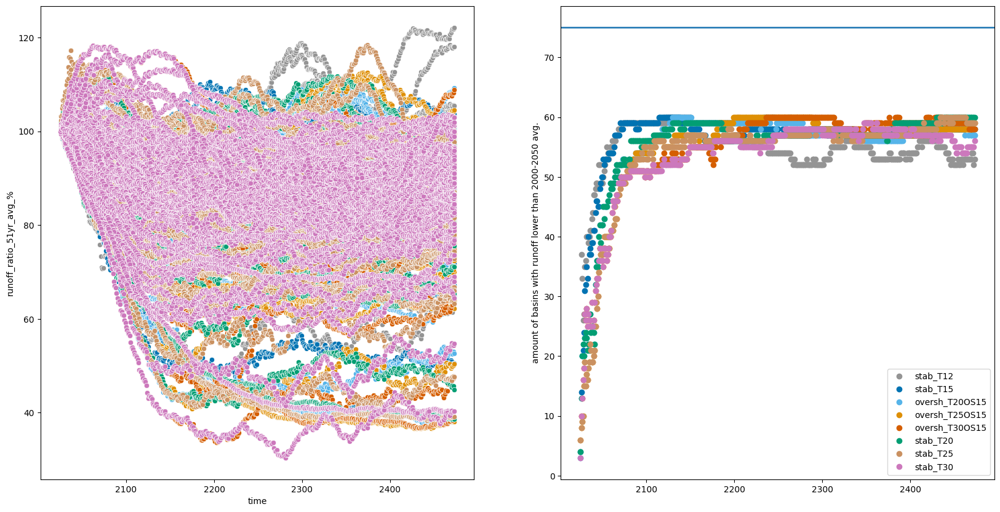

In [16]:
_pd_basin_num = gpd.read_file('/home/www/fmaussion/misc/magicc/basins_shape/glacier_basins.shp')
_pd_basin_num.index = _pd_basin_num.MRBID

for basin_sel in ['all', 'glac>0.1']:
    if basin_sel == 'all':
        basin_ids = pd_basin_num.MRBID.values
    else:
        basin_ids = pd_basin_num.loc[pd_basin_num.glaciated_vs_basin_area_RGI6_perc>=0.1].MRBID.values
    for avg in [21,51]: 

        plt.figure(figsize=(20,10))
        print(f'avg: {avg}-years')
        after_2100 = []
        after_2200 = []
        after_2300 = []
        after_2100_sel = []
        after_2200_sel = []
        if avg == 21:
            baseline = '2000-2020'
        else:
            baseline = '2000-2050'
        for scen in color_scenario.keys():
            basin_XXyr_runoff = df_scenario_common_basin.runoff.isel(time=slice(0,-1)).rolling(min_periods=avg, time=avg, center=True).mean().dropna(dim='time')
            basin_XXyr_runoff = basin_XXyr_runoff.sel(basin = basin_ids.astype(str))
            df_basin_XXyr_runoff_ratio = (100*basin_XXyr_runoff/basin_XXyr_runoff.isel(time=0)).to_dataframe(f'runoff_ratio_{avg}yr_avg_%').reset_index()
            df_basin_XXyr_runoff_ratio_scen= df_basin_XXyr_runoff_ratio.loc[df_basin_XXyr_runoff_ratio.scenario == scen]
            _d = df_basin_XXyr_runoff_ratio_scen.loc[df_basin_XXyr_runoff_ratio_scen[f'runoff_ratio_{avg}yr_avg_%']>=100]

            plt.subplot(121)
            c = color_scenario[scen]
            sns.scatterplot(data=df_basin_XXyr_runoff_ratio_scen, x='time', y = f'runoff_ratio_{avg}yr_avg_%', color=c)
            count_basin_below_init = df_basin_XXyr_runoff_ratio_scen.loc[df_basin_XXyr_runoff_ratio_scen[f'runoff_ratio_{avg}yr_avg_%']<100].groupby('time').count().reset_index()
            plt.subplot(122)
            plt.plot(count_basin_below_init.time, count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'], 'o', label=scen, color=c)
            plt.axhline(len(basin_glac),ls = '-')
            plt.ylabel('amount of basins with runoff lower than 2000-2050 avg.')
            print(scen, f'basins runoff below {baseline} avg over time 2100-2500:' , count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'].loc[count_basin_below_init.time>=2100].min(), 'of', len(basin_ids))
            after_2100.append(count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'].loc[count_basin_below_init.time>=2100].min())
            print(scen, f'basins runoff below {baseline} avg over time 2200-2500:' , count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'].loc[count_basin_below_init.time>=2200].min(), 'of', len(basin_ids))
            after_2200.append(count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'].loc[count_basin_below_init.time>=2200].min())
            
            print(scen, f'basins runoff below {baseline} avg over time 2300-2500:' , count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'].loc[count_basin_below_init.time>=2300].min(), 'of', len(basin_ids))
            after_2300.append(count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'].loc[count_basin_below_init.time>=2300].min())

            print(_pd_basin_num.loc[_d.loc[_d.time>=2100].basin.unique().astype(int)].RIVER_BASI.values)
            print(_pd_basin_num.loc[_d.loc[_d.time>=2200].basin.unique().astype(int)].RIVER_BASI.values)
            print(_pd_basin_num.loc[_d.loc[_d.time>=2300].basin.unique().astype(int)].RIVER_BASI.values)

            #### How many basins have runoff below 2000-2500 average (in 2100/2200)?
            #print((count_basin_below_init.loc[count_basin_below_init.time==2100]/len(basin_glac))['basin'])
            #print((count_basin_below_init.loc[count_basin_below_init.time==2200]/len(basin_glac))['basin'])
            #print(count_basin_below_init.loc[count_basin_below_init.time==2200]['basin'])
            if scen in ['stab_T20', 'stab_T25', 'stab_T30']:
                after_2100_sel.append(count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'].loc[count_basin_below_init.time>=2200].min())
                after_2200_sel.append(count_basin_below_init[f'runoff_ratio_{avg}yr_avg_%'].loc[count_basin_below_init.time>=2200].min())

        print('minimum after 2100', np.array(after_2100).min(), 'of', len(basin_ids))
        print('minimum after 2100 (>=stabT20)', np.array(after_2200_sel).min(), 'of', len(basin_ids))

        print('minimum after 2200', np.array(after_2200).min(), 'of', len(basin_ids))
        print('minimum after 2200 (>=stabT20)', np.array(after_2200_sel).min(), 'of', len(basin_ids))

        print('minimum after 2300', np.array(after_2300).min(), 'of', len(basin_ids))

        print('\n')
        plt.legend()

***Amount of all basins (from 75 basins) where runoff is below baseline after 2100***

In [18]:
(count_basin_below_init.loc[count_basin_below_init.time==2100]/len(basin_glac))['basin']
# 87%

75    0.68
Name: basin, dtype: float64

In [19]:
(count_basin_below_init.loc[count_basin_below_init.time==2200]/len(basin_glac))['basin']
# 93%

175    0.746667
Name: basin, dtype: float64

<BarContainer object of 449 artists>

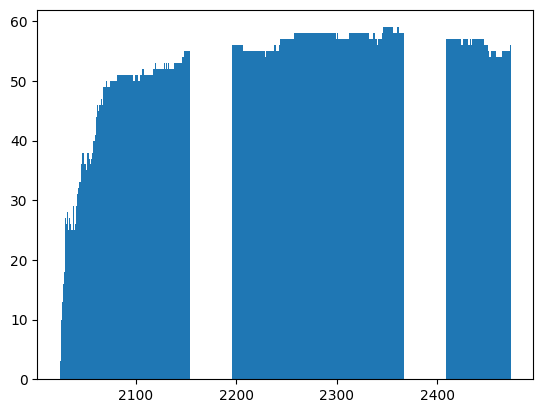

In [20]:
plt.bar(count_basin_below_init.time, count_basin_below_init['runoff_ratio_51yr_avg_%'])

In [22]:
# glaciated basins (from the 54) according to Ultee et al 2022
len(pd_basins.loc[pd_basins.glaciated_perc_ultee_2022>=0.1])

43

In [23]:
len(pd_basin_num.loc[pd_basin_num.AREA_CALC>5000])

72

In [25]:
# glaciated basins according to pd_basin_num (from the 75)
len(pd_basin_num.loc[pd_basin_num.glaciated_vs_basin_area_RGI6_perc>=0.1])

60

**get basin glacier volume and amount of glaciers per basin**

In [26]:
df_itmix = pd.read_hdf(oggm.utils.get_demo_file('rgi62_itmix_df.h5'))
print(len(df_itmix))
f = open('/home/www/fmaussion/misc/magicc/rgi_ids_per_basin.json')
t = json.load(f)

frgi = utils.file_downloader('https://cluster.klima.uni-bremen.de/~oggm/rgi/rgi62_stats.h5')
#frgi = '/home/users/lschuster/glacierMIP/rgi62_stats.h5'
odf = pd.read_hdf(frgi, index_col=0)

for basin in pd_basin_num.MRBID:
    rgis_basin = t[str(basin)]
    # remove connectivity level 2 glaciers only important for P03 (Greenland)
    rgis_basin = odf.loc[rgis_basin].loc[odf.loc[rgis_basin].Connect <2].index.values
    rgis_basin = list(set(rgis_basin))

    pd_basin_num.loc[pd_basin_num.MRBID==basin,'n glaciers'] = int(len(rgis_basin))
    vol_ratio = 100*df_itmix.loc[rgis_basin]['vol_itmix_m3'].sum()/df_itmix['vol_itmix_m3'].sum()
    pd_basin_num.loc[pd_basin_num.MRBID==basin,'Initial basin glacier volume relative to global volume (%)'] = np.round(vol_ratio,2)

pd_basin_num['n glaciers'] = pd_basin_num['n glaciers'].astype(int)

216502


In [27]:
# function to correctly find the largest continuous span of years in a list
def find_largest_continuous_span(years):
    max_span_start = years[0]
    max_span_end = years[0]
    current_span_start = years[0]
    current_span_end = years[0]

    for i in range(1, len(years)):
        if years[i] == current_span_end + 1:
            current_span_end = years[i]
        else:
            if (current_span_end - current_span_start) > (max_span_end - max_span_start):
                max_span_start = current_span_start
                max_span_end = current_span_end
            current_span_start = years[i]
            current_span_end = years[i]

        if (current_span_end - current_span_start) > (max_span_end - max_span_start):
            max_span_start = current_span_start
            max_span_end = current_span_end

    return (max_span_start, max_span_end)

def get_basin_trough_water_stats(sel_stab, sel_oversh, 
                                 runoff_var = 'runoff_dry3m_rel_2000_2050_%'):

    # “Trough water” occurs if the 51-year average annual runoff from the 
    # “Overshoot 3.0°C -> 1.5°C” scenario is at least 5\% smaller than (i) in the “Stabilisation 1.5°C” scenario for 20 years 
    # and  (ii) than in the baseline period 
    # (initial steady state for the idealised experiments, 2000--2020 or 2000--2050 climate for the projections with the ESM).
    # --> the second condition just means it has to be smaller than or equal to 95% 
    
    # arguments: 
    # sel_stab, sel_oversh: (pd.DataFrame)
    #    Table with runoff_var of the stabilisation or overshoot scenario for a specific basin 
    # runoff_var: str
    #    one of the three runoff variables ('runoff_rel_2000_2050_%', 'melt_off_on_rel_2000_2050_%', 'runoff_dry3m_rel_2000_2050_%')

    # returns array with: 
    # - amount of trough water years (also if they are non-continuous)
    # - cumulative runoff difference during trough water years
    # - year where trough water is strongest (year w. largest difference)
    # - largest difference of Stabilisation minus Overshoot during trough water
    # - first year and last year of potential trough water (has to be checked for discontinuoties when plotted )
    

    sel_oversh.index = sel_oversh.time
    sel_stab.index = sel_stab.time
    condi_i = (sel_stab[runoff_var] - sel_oversh[runoff_var]) >= 5 #difference has to be larger thatn 5% 
    condi_ii = sel_oversh[runoff_var].dropna()<=95
    condi = condi_i & condi_ii
    
    yrs_trough = sel_stab.where(condi).dropna(how='all').index
    # check if largest continuos span with 5% difference is at least 20 years 
    if len(yrs_trough)>1:
        x0,x1 = find_largest_continuous_span(yrs_trough)
        condi_20_yrs = len(np.arange(x0,x1,+1))>=20
    else:
        condi_20_yrs = False
    
    if condi_20_yrs:
        #print(x0,x1)
        trough_water_years = len(yrs_trough)
        # difference stabilisation vs overshoot
        diff = (sel_stab.loc[yrs_trough][runoff_var] - sel_oversh.loc[yrs_trough][runoff_var])
        water_trough_min_yr = int(diff.idxmax())
        water_trough_max_diff = diff.max()
        # years of potential trough water
        yrs_trough_start_end = f'{yrs_trough[0]}_{yrs_trough[-1]}'
        runoff_diff_trough = diff.sum()
    else:
        trough_water_years = 0
        water_trough_min_yr = np.NaN
        water_trough_max_diff = np.NaN
        yrs_trough_start_end = np.NaN
        runoff_diff_trough = np.NaN

    return np.array([trough_water_years, runoff_diff_trough,
                     water_trough_min_yr, water_trough_max_diff, yrs_trough_start_end])


In [30]:
runoff_var = 'runoff_rel_2000_2050_%'
water_trough_stats_basins = pd.DataFrame(index = pd_runoff_scenario_rel_basin.basin.unique(),
                                  columns= ['yrs_with_trough_water',  'cumulative_runoff_diff_trough', 
                                            'trough_water_min_year', 'trough_water_max_diff',
                                            'trough_water_pot_start_end'])
for basin in pd_runoff_scenario_rel_basin.basin.unique():
    pd_runoff_scenario_rel_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin==basin]
    # overshoot runoff smaller than 0.95 times stabilisation runoff (both use 501r avg. runoff)
    sel_oversh = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='oversh_T30OS15']
    sel_stab = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='stab_T15']
    _output = get_basin_trough_water_stats(sel_stab, sel_oversh, 
                                 runoff_var = runoff_var)
    water_trough_stats_basins.loc[basin] = _output

print('amount of basins with annual runoff trough water: n=', len(water_trough_stats_basins.dropna()))


from sklearn.linear_model import LinearRegression

for basin in water_trough_stats_basins.index:
    pd_clim_sel_basin = pd_clim_all.loc[pd_clim_all.region ==f'basin_{basin}_glacier']
    pd_clim_sel_basin_oversh = pd_clim_sel_basin.loc[pd_clim_sel_basin.scenario=='oversh_T30OS15'].dropna()
    pd_clim_sel_basin_oversh.index = pd_clim_sel_basin_oversh.year
    pd_clim_sel_basin_stab = pd_clim_sel_basin.loc[pd_clim_sel_basin.scenario=='stab_T15'].dropna()
    pd_clim_sel_basin_stab.index = pd_clim_sel_basin_stab.year
    
    cumsum_temp_diff_oversh_stab_bef2350 = (pd_clim_sel_basin_oversh['temp_21yr_avg'].loc[2100:2350] - pd_clim_sel_basin_stab['temp_21yr_avg'].loc[2100:2350]).sum()
    cumsum_temp_diff_oversh_stab_aft2350 = (pd_clim_sel_basin_oversh['temp_21yr_avg'].loc[2350:] - pd_clim_sel_basin_stab['temp_21yr_avg'].loc[2350:]).sum()
    regional_warming_aft2350 = pd_clim_sel_basin_stab['temp_21yr_avg'].loc[2350:].mean()  - pd_clim_sel_basin_stab['temp_21yr_avg'].loc[2010].mean()
    diff = (pd_clim_sel_basin_oversh['temp_21yr_avg'].loc[2050:2350] - pd_clim_sel_basin_stab['temp_21yr_avg'].loc[2050:2350])
    yr_max = diff.idxmax()
    peak_temp_diff_oversh_vs_stab_bef2350 = diff.loc[yr_max]

    water_trough_stats_basins.loc[basin, 'peak_temp_diff_oversh_vs_stab_bef2350'] = peak_temp_diff_oversh_vs_stab_bef2350
    water_trough_stats_basins.loc[basin, 'yr_peak_temp_diff_oversh_vs_stab_bef2350'] = yr_max
    water_trough_stats_basins.loc[basin, 'regional_warming_aft2350'] = regional_warming_aft2350

    water_trough_stats_basins.loc[basin, 'cumsum_temp_diff_oversh_stab_bef2350']= cumsum_temp_diff_oversh_stab_bef2350
    water_trough_stats_basins.loc[basin, 'cumsum_temp_diff_oversh_stab_aft2350'] = cumsum_temp_diff_oversh_stab_aft2350
    #cumsum_precip_diff_oversh_stab_bef2350 = (pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2050:2350] - pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2050:2350]).sum()
    #cumsum_precip_diff_oversh_stab_aft2350 = (pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2350:] - pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2350:]).sum()

    mean_precip_change_perc_oversh_vs_stab_bef2350 = ((pd_clim_sel_basin_oversh['precip_21yr_avg'].loc[2100:2350] / pd_clim_sel_basin_stab['precip_21yr_avg'].loc[2100:2350]).mean() -1)*100
    mean_precip_change_perc_oversh_vs_stab_aft2350 = ((pd_clim_sel_basin_oversh['precip_21yr_avg'].loc[2350:] / pd_clim_sel_basin_stab['precip_21yr_avg'].loc[2350:]).mean() - 1)*100
    
    water_trough_stats_basins.loc[basin, 'mean_precip_change_perc_oversh_vs_stab_bef2350'] = mean_precip_change_perc_oversh_vs_stab_bef2350
    water_trough_stats_basins.loc[basin, 'mean_precip_change_perc_oversh_vs_stab_aft2350'] = mean_precip_change_perc_oversh_vs_stab_aft2350
    
    
    water_trough_stats_basins.loc[basin, 'corr_coef_oversh_temp_precip'] = np.corrcoef(pd_clim_sel_basin_oversh['temp_21yr_avg'], pd_clim_sel_basin_oversh['precip_21yr_avg'])[0][1]
    
    model = LinearRegression()
    model.fit(pd_clim_sel_basin_oversh['temp_21yr_avg'].values.reshape(-1,1), pd_clim_sel_basin_oversh['precip_21yr_avg'])
    slope = model.coef_[0]
    # slope_oversh_temp_precip describes how the precipiation changes with temperature, if positive, it means that prcp. increases, if positive it means it decreases with warmer temperatures ... 
    water_trough_stats_basins.loc[basin, 'slope_oversh_temp_precip'] = slope
    #ratio_change = (pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2050:2350] / pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2050:2350]) - 1
    #yr_ratio_max = np.abs(ratio_change).idxmax()
    #peak_precip_change_perc_oversh_stab_bef2350 = (ratio_change.loc[yr_ratio_max])*100

    #ratio_change = (pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2400:] / pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2400:]) - 1
    #yr_ratio_max = np.abs(ratio_change).idxmax()
    #peak_precip_change_perc_oversh_stab_aft2400 = (ratio_change.loc[yr_ratio_max])*100
    
# to compute basins where overshoot creates at least 10 % volume difference 
df_scenario_common_basin['melt_off_on_51yr_avg'] = df_scenario_common_basin.melt_off_on.isel(time=slice(0,-1)).rolling(min_periods=51, time=51, center=True).mean()
df_volume_rel = 100 * df_scenario_common_basin.volume.dropna(dim='time') / df_scenario_common_basin.volume.dropna(dim='time').sel(time=2020)
df_runoff_rel = 100 * df_scenario_common_basin.runoff_51_yr_avg.dropna(dim='time') / df_scenario_common_basin.runoff_51_yr_avg.dropna(dim='time').isel(time=0)
df_melt_off_on_rel = 100 * df_scenario_common_basin.melt_off_on_51yr_avg.dropna(dim='time') / df_scenario_common_basin.melt_off_on_51yr_avg.dropna(dim='time').isel(time=0)
df_runoff_rel_sel = df_runoff_rel.drop_sel(scenario='stab_T12')

rel_volume_basin = 100*df_scenario_common_basin.volume/df_scenario_common_basin.volume.sel(time=2020)
# only select those years where overshoot results in smaller volume
max_volume_diff = (rel_volume_basin.sel(scenario='stab_T15') - rel_volume_basin.sel(scenario='oversh_T30OS15')).max(dim='time').squeeze().to_dataframe('Values')
yr_w_max_volume_diff = (rel_volume_basin.sel(scenario='stab_T15') - rel_volume_basin.sel(scenario='oversh_T30OS15')).idxmax(dim='time').squeeze().to_dataframe('Values')

final_volume_diff_stab_T15_T30 = (rel_volume_basin.sel(scenario='stab_T15') - rel_volume_basin.sel(scenario='stab_T30')).sel(time=2499).squeeze().to_dataframe('Values')
water_trough_stats_basins.loc[max_volume_diff.index, 'max_volume_diff_perc_stab_T15_vs_oversh30'] = max_volume_diff['Values']
water_trough_stats_basins.loc[yr_w_max_volume_diff.index, 'yr_with_max_volume_diff_stab_T15_vs_oversh30'] = yr_w_max_volume_diff['Values']

water_trough_stats_basins.loc[max_volume_diff.index, 'final_volume_diff_stab_T15_T30'] = final_volume_diff_stab_T15_T30['Values']

water_trough_stats_basins['trough_water_max_diff'] = water_trough_stats_basins.trough_water_max_diff.astype(float)
water_trough_stats_basins['max_volume_diff_perc_stab_T15_vs_oversh30'] = water_trough_stats_basins.max_volume_diff_perc_stab_T15_vs_oversh30.astype(float)
water_trough_stats_basins['yrs_with_trough_water'] = water_trough_stats_basins.yrs_with_trough_water.astype(float)
water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350'] = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] / water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_aft2350']

water_trough_stats_basins.loc[pd_basin_num.MRBID.values.astype(str), 'basin_name'] = pd_basin_num.index


# at least 0.1% glaciation 
basin_glac_ind = pd_basin_num.where(pd_basin_num['glaciated_vs_basin_area_RGI6_perc']>=0.1).dropna(how='all').MRBID.astype(int).astype(str).values
water_trough_stats_basins_sel = water_trough_stats_basins.loc[basin_glac_ind].copy()
print(f'basins 0.1% glaciated:n = {len(water_trough_stats_basins_sel)}')


condi_after_2150 = water_trough_stats_basins_sel['yr_with_max_volume_diff_stab_T15_vs_oversh30']>2150 #2150#2100
condi_vol_diff = water_trough_stats_basins_sel['max_volume_diff_perc_stab_T15_vs_oversh30']>10
print('basins that get an at least 10% larger glacier mass after the global overshoot:')
print(len(water_trough_stats_basins_sel['max_volume_diff_perc_stab_T15_vs_oversh30'].where(condi_vol_diff & condi_after_2150).dropna(how='all')))

# assert np.all(water_trough_stats_basins_sel.water_trough_min_year.astype(float).dropna(how='all') > 2170)
condi_water_trough_2170 = water_trough_stats_basins_sel.trough_water_min_year.astype(float).dropna(how='all') > 2170
condi_trough = water_trough_stats_basins_sel.yrs_with_trough_water>=20
print('basins that are 0.1% glaciated, have at least a mass difference of 10% and create a trough water:')
print(len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff).dropna(how='all')))
# check if the water trough occurs after overshoot 
print('basins that are 0.1% glaciated, have at least a mass difference of 10% after the global overshoot and create a trough water:')
print(len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff & condi_after_2150).dropna(how='all')))

# all that have a trough and have at least 10%  lager glacier volume 
print('basins that are 0.1% glaciated, and create a trough water after the year 2170:')
print(len(water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170).dropna(how='all')))

# all that have a trough and have at least 10%  lager glacier volume 
print('basins that are 0.1% glaciated, have at least a mass difference of 10% after the global overshoot and create a trough water after the year 2170:')
print(len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff & condi_after_2150 & condi_water_trough_2170).dropna(how='all')))
#print(water_trough_stats_basins_sel.dropna())
#assert len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff & condi_after_2150).dropna()) == len(water_trough_stats_basins_sel.where(condi_trough).dropna())




amount of basins with annual runoff trough water: n= 37
basins 0.1% glaciated:n = 60
basins that get an at least 10% larger glacier mass after the global overshoot:
46
basins that are 0.1% glaciated, have at least a mass difference of 10% and create a trough water:
32
basins that are 0.1% glaciated, have at least a mass difference of 10% after the global overshoot and create a trough water:
25
basins that are 0.1% glaciated, and create a trough water after the year 2170:
31
basins that are 0.1% glaciated, have at least a mass difference of 10% after the global overshoot and create a trough water after the year 2170:
24


**THese are the numbers used in the main manuscript text**:
- Overall, annual glacier runoff trough water occurs in 31 of 60 glaciated basins after the year 2170 (Supplementary Fig...).
- Of those, 24 basins show a trough water attributable to glacier mass regrowth after the temperature overshoot.

In [34]:
#### basins 0.1% glaciated, that get an at least 10% larger glacier volume and create a trough water:
len(water_trough_stats_basins_sel.where(condi_trough).dropna())  # trough water minimum can be before 2150 

32

In [35]:
#### basins 0.1% glaciated, that get an at least 10% larger glacier volume and create a trough water:
len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff).dropna())  # trough water minimum can be before 2150 

32

In [36]:
###  basins 0.1\% glaciated, that get an at least 10\% larger glacier volume and create a trough water after the year 2170
len(water_trough_stats_basins_sel.where(condi_trough & condi_water_trough_2170).dropna())

31

In [37]:
###  basins 0.1\% glaciated, that get an at least 10\% larger glacier volume and create a trough water after the year 2170
len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff  & condi_water_trough_2170).dropna())

31

- five out of the seven driest basins are included here !!! 

In [38]:
len(water_trough_stats_basins_sel.loc[water_trough_stats_basins_sel.max_volume_diff_perc_stab_T15_vs_oversh30>=10])

56

In [40]:
pd_h = pd.read_csv('/home/www/lschuster/provide/gfdl-esm2m_oversh_stab_uni_bern/analysis_notebooks/schuster_el_al_phd_paper_2_overshoot_glaciers/data_from_others/hanus_et_al_coordinates_outlet_basins_huss_fixed_gl_area.csv')

In [41]:
len(pd_h.where(pd_h.Gl_Perc >=0.001).dropna())

44

#### also compute the melt water stuff (just as comparison)    

In [45]:

runoff_var = 'melt_off_on_rel_2000_2050_%'
melt_water_trough_stats_basins = pd.DataFrame(index = pd_melt_off_on_scenario_rel_basin.basin.unique(),
                                              columns= ['yrs_with_melt_trough_water',  'cumulative_melt_off_on_diff_trough', 
                                            'melt_trough_water_min_year', 'melt_trough_water_max_diff',
                                            'melt_trough_water_pot_start_end'])
for basin in pd_melt_off_on_scenario_rel_basin.basin.unique():
    pd_melt_off_on_scenario_rel_basin_sel = pd_melt_off_on_scenario_rel_basin.loc[pd_melt_off_on_scenario_rel_basin.basin==basin].copy()
    sel_oversh = pd_melt_off_on_scenario_rel_basin_sel.loc[pd_melt_off_on_scenario_rel_basin_sel.scenario=='oversh_T30OS15']
    sel_stab = pd_melt_off_on_scenario_rel_basin_sel.loc[pd_melt_off_on_scenario_rel_basin_sel.scenario=='stab_T15']
    _output = get_basin_trough_water_stats(sel_stab, sel_oversh, 
                                 runoff_var = runoff_var)
    melt_water_trough_stats_basins.loc[basin] = _output
    
print('amount of basins with melt water trough water: n=', len(melt_water_trough_stats_basins.dropna()))


amount of basins with melt water trough water: n= 59


### **create some overview plots of annual runoff trough water for every basin**

In [48]:
pd_clim_all['precip_51yr_avg'] = pd_clim_all['precip_51yr_avg'].where((pd_clim_all.year>=2025) & (pd_clim_all.year<=2474))

In [51]:
pd_runoff_scenario_rel_basin['stab_vs_oversh'] = 'oversh'
pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin['scenario'].apply(lambda x: 'stab' in x).values, 'stab_vs_oversh'] = 'stab'

In [144]:
var = 'precip_51yr_avg'
for Preg in df_scenario.provide_region.values:
    basins = basins_per_preg[Preg]
    preg_name = provide_reg_full_name_dict[Preg]
    preg_name.replace('\n','')
        
    if len(basins)<1:
        continue
        
    plt.rc('font', size=22)

    plt.figure(figsize=(32,35)) #, sharey=True, sharex=True)
    plt.subplot(5,4,1)
    ax = plt.gca()

    ax.set_ylabel('Annual runoff\n(% rel. to 2000-2050)', weight='bold')

    basin = basins[0]
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]
    basin_name = f'{preg_name} ({Preg})'
    plt.suptitle(basin_name)
    plt.text(0.97,0.97, f'{basin_n}:\n{basin}',
             transform=ax.transAxes,ha='right',va='top',
            color='grey', fontsize=22)

    sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=list_color_scenario_poster_new_order,
                 style='stab_vs_oversh', style_order=['stab', 'oversh'],
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_21yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = scenario_ls[scenario],
                 lw=1, color = color_scenario[scenario], label=label_scenario_david[scenario])
    ax2.set_ylabel('')
    if var != 'temp_21yr_avg':
        ticks = np.arange(95,125,5)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)

    ax2.set_ylim([75,128]);
    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax.set_ylim([40,145]);


    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles_2[0:len(scenarios)], # here stab 112 is handle 0 (but invisible)
                    labels_2[:len(scenarios)], title='Scenarios', fontsize=20, title_fontsize=22, loc = 'upper left')
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[1], handles_2[0]], ['Runoff (left)',
                                                  'Precipitation (right)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('grey')
    ax.add_artist(leg)

    try:
        y0,y1 = water_trough_stats_basins['trough_water_pot_start_end'].loc[str(basin)].split('_')
        pd_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)].dropna()
        pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
        pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time
        nyears,water_trough_max_diff  = water_trough_stats_basins[['yrs_with_trough_water',
                                                            'trough_water_max_diff']].loc[str(basin)]
        water_trough_max_diff = np.round(float(water_trough_max_diff),0)
        add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'
        
        condi_5perc = (pd_basin_sel_oversh_T30OS15_runoff['runoff_rel_2000_2050_%']-pd_basin_sel_stab_T15_runoff['runoff_rel_2000_2050_%']).loc[float(y0):float(y1)+1]<=-5
        # pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'].where(condi_5perc)
        # important -> keep the NaNs to show the potential incontinuoties ... 
        ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time.where(condi_5perc),  
                         pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'].where(condi_5perc), 
                         pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'].where(condi_5perc),
                         alpha = 0.15, color='cyan', zorder=-1, label='trough water\n'+add_label)
        
        handles_x, labels_x = ax.get_legend_handles_labels()
        leg3 = ax.legend([handles_x[-1]], [labels_x[-1]], loc='lower left',fontsize=18)
        #ax.add_artist(leg3)
        ax.add_artist(leg2)
    except AttributeError:
        pass
    

    for j, basin in enumerate(basins[1:]):
        basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]

        plt.subplot(5,4,j+2)
        x_j = np.arange(3,20,4)
        x2_j = np.arange(2,20,4)
            
        ax = plt.gca()
        sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
                     hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                     style='stab_vs_oversh',style_order=['stab', 'oversh'],
                     palette=list_color_scenario_poster_new_order,
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        #ax.set_title(f'{Preg}: {basin}')
        plt.text(0.97,0.97, f'{basin_n}:\n{basin}',
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)

        if j in x_j:
            plt.ylabel(f'Annual runoff\n(% rel. to 2000-2050)', weight='bold')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        #ax.set_ylim([70,1439.9]);


        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            if var == 'temp_21yr_avg':
                var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
            else:
                var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 1, 
                    ls = scenario_ls[scenario],
                     lw=1, color = color_scenario_poster[scenario], label=label_scenario_david[scenario])
        if var != 'temp_21yr_avg':
            ticks = np.arange(95,125,5)
            ax2.set_yticks(ticks=ticks,
                            labels=ticks, alpha=0.6)  
            ylabel = 'Precipitation\n(% rel. to 2000-2019)'

        else:
            ax2.set_yticks(ticks=[0,1,2,3,4,5],
                       labels=[0,1,2,3,4,5], alpha=0.6)
            ylabel = r'$\Delta$T'+'(°C) rel. to 2000-2019\n(glacier-area weighted)'

        if j in x2_j:
            ax2.set_ylabel(ylabel,
                          alpha = 0.6)
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        #ax2.set_ylim([-0.9,5.9]);
        ax2.set_ylim([75,128]);

        if j >5:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
        ax.set_ylim([40,145]);
        
        try:
            y0,y1 = water_trough_stats_basins['trough_water_pot_start_end'].loc[str(basin)].split('_')
            pd_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)].dropna()
            pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
            pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
            pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
            pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time
            nyears,water_trough_max_diff  = water_trough_stats_basins[['yrs_with_trough_water',
                                                                'trough_water_max_diff']].loc[str(basin)]
            water_trough_max_diff = np.round(float(water_trough_max_diff),0)
            add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'

            condi_5perc = (pd_basin_sel_oversh_T30OS15_runoff['runoff_rel_2000_2050_%']-pd_basin_sel_stab_T15_runoff['runoff_rel_2000_2050_%']).loc[float(y0):float(y1)+1]<=-5
            # pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'].where(condi_5perc)
            # important -> keep the NaNs to show the potential incontinuoties ... 
            ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time.where(condi_5perc),  
                             pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'].where(condi_5perc), 
                             pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'].where(condi_5perc),
                             alpha = 0.15, color='cyan', zorder=-1, label='trough water\n'+add_label)
            handles_x, labels_x = ax.get_legend_handles_labels()
            leg3 = ax.legend([handles_x[-1]], [labels_x[-1]], loc='lower left',fontsize=18)
        except AttributeError:
            pass
        
    plt.tight_layout()
    plt.savefig(f'figures/figures_basins/3_{Preg}_basin_runoff_{bc}_vs_prcp_poster_iugg_precip_51yr_avg.png')
    plt.close()

In [58]:
old_def = False
if old_def: 
    # Definition:
    # “Trough water” occurs if the 51-year average annual runoff from the 
    # “Overshoot 3.0°C -> 1.5°C” scenario is at least 5\% smaller than (i) in the “Stabilisation 1.5°C” scenario for 20 years 
    # and  (ii) than in the baseline period 
    # (initial steady state for the idealised experiments, 2000--2020 or 2000--2050 climate for the projections with the ESM).
    ### --> the second condition just means it has to be smaller than or equal to 95% 
    runoff_var = 'runoff_rel_2000_2050_%'
    water_trough_stats_basins = pd.DataFrame(index = pd_runoff_scenario_rel_basin.basin.unique(),
                                      columns= ['yrs_with_water_trough',  'cumulative_runoff_diff_trough', 
                                                'water_trough_min_year', 'water_trough_max_diff',
                                                'water_trough_start_end'])
    for basin in pd_runoff_scenario_rel_basin.basin.unique():

        yrs_trough,_yrs_trough = [],[]
        pd_runoff_scenario_rel_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin==basin].copy()
        # overshoot runoff smaller than 0.95 times stabilisation runoff (both use 50yr avg. runoff)
        sel_oversh = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='oversh_T30OS15']
        sel_oversh.index = sel_oversh.time
        sel_stab = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='stab_T15']
        sel_stab.index = sel_stab.time

        ### this is equaleverwhere 
        condi_i = (sel_stab[runoff_var] - sel_oversh[runoff_var]) >= 5 #difference has to be larger than 5% 
        condi_ii = sel_oversh[runoff_var].dropna()<=95
        condi = condi_i & condi_ii
        # estimate years with water trough
        yrs_trough = sel_stab.where(condi).dropna(how='all').index
        #print(len(yrs_trough))
        # CONDITION: yrs_trough 
        if len(yrs_trough)<20:
            print(basin, len(yrs_trough))
            yrs_trough = []
            continue
        elif (yrs_trough[-1] - yrs_trough[0]) == len(yrs_trough):
            # continuous trough water 
            pass
        else:
            try:
                print(yrs_trough)
                # check if the trough water is more or less continuus,
                yrs_miss = list(set(np.arange(yrs_trough[0], yrs_trough[-1]))-set(yrs_trough))
                yrs_miss.sort()
                if len(yrs_miss)<1:
                    _yrs_trough= yrs_trough
                # cut the first or last years out ... 
                elif (yrs_miss[-1] - yrs_trough[0] < 10):
                    _yrs_trough = np.arange(yrs_miss[-1]+1, yrs_trough[-1])
                elif (yrs_trough[-1] - yrs_miss[-1] < 10):
                    _yrs_trough = np.arange(yrs_trough[0], yrs_miss[-1]-1)
                else:
                    # use all anyways ...  and check afterwards if it is ok 
                    _yrs_trough= np.arange(yrs_trough[0], yrs_trough[-1]+1)

                # estimate runoff differences inside of potential water trough
                _diff = (sel_stab.loc[_yrs_trough][runoff_var] - sel_oversh.loc[_yrs_trough][runoff_var])
                assert len(_diff.loc[_diff<=0])<=5
                #print(basin,yrs_miss, len(_yrs_trough), '_nc')
            except:
                print(basin,pd_basin_num_glac.loc[pd_basin_num_glac.MRBID==int(basin)].index.values)
                # if not, choose just one period, i.e. the period where it is the most continuous
                yrs_trough_min, yrs_trough_max = find_largest_continuous_span(yrs_trough)
                _yrs_trough = np.arange(yrs_trough_min, yrs_trough_max+1,1)     
            # CONDITION: yrs_trough 
            if len(_yrs_trough) <20:
                print('non-continuous', basin, len(_yrs_trough))
                _yrs_trough = []
            yrs_trough = _yrs_trough

        # estimate runoff differences inside of water trough
        diff = (sel_stab.loc[yrs_trough][runoff_var] - sel_oversh.loc[yrs_trough][runoff_var])

        try:
            # len(diff.loc[diff<0]<=5)
            assert len(diff.loc[diff<=0])<=5
            if np.any(diff<=0) and len(diff.loc[diff<=0])<=5:
                print(basin, 'yrs_trough: ', yrs_trough[0], yrs_trough[-1])
            water_trough_min_yr = int(diff.idxmax())
            water_trough_max_diff = diff.max()
            yrs_trough_start_end = f'{yrs_trough[0]}_{yrs_trough[-1]}'
            runoff_diff_trough = diff.sum()
        except:
            water_trough_min_yr = np.NaN
            water_trough_max_diff = np.NaN
            yrs_trough_start_end = np.NaN
            print('nan', basin, diff.values)
            yrs_trough = [] # not a continuous period ... 
            runoff_diff_trough = np.NaN
        water_trough_stats_basins.loc[basin] = np.array([len(yrs_trough), runoff_diff_trough,
                                                 water_trough_min_yr, water_trough_max_diff, yrs_trough_start_end])

    len(water_trough_stats_basins.dropna())#.loc[water_trough_stats_basins.dropna().yrs_with_water_trough.astype(int)>50]
    
    

    runoff_var = 'melt_off_on_rel_2000_2050_%'
    melt_water_trough_stats_basins = pd.DataFrame(index = pd_melt_off_on_scenario_rel_basin.basin.unique(),
                                      columns= ['yrs_with_melt_water_trough',  'cumulative_melt_off_on_diff_trough', 
                                                'melt_water_trough_min_year', 'melt_water_trough_max_diff',
                                                'melt_water_trough_start_end'])
    for basin in pd_melt_off_on_scenario_rel_basin.basin.unique():

        pd_melt_off_on_scenario_rel_basin_sel = pd_melt_off_on_scenario_rel_basin.loc[pd_melt_off_on_scenario_rel_basin.basin==basin].copy()
        # overshoot melt off on smaller than 0.95 times stabilisation melt off on (both use 51yr avg. melt off on )
        sel_oversh = pd_melt_off_on_scenario_rel_basin_sel.loc[pd_melt_off_on_scenario_rel_basin_sel.scenario=='oversh_T30OS15']
        sel_oversh.index = sel_oversh.time
        sel_stab = pd_melt_off_on_scenario_rel_basin_sel.loc[pd_melt_off_on_scenario_rel_basin_sel.scenario=='stab_T15']
        sel_stab.index = sel_stab.time

        #### this is eaxctly the same as for annual runoff ... 
        condi_i = (sel_stab[runoff_var] - sel_oversh[runoff_var]) >= 5 #difference has to be larger thatn 5% 
        condi_ii = sel_oversh[runoff_var].dropna()<=95
        condi = condi_i & condi_ii
        # estimate years with water trough
        yrs_trough = sel_stab.where(condi).dropna(how='all').index
        #print(len(yrs_trough))
        # CONDITION: yrs_trough 
        if len(yrs_trough)<20:
            print(basin, len(yrs_trough))
            yrs_trough = []
            continue
        elif (yrs_trough[-1] - yrs_trough[0]) == len(yrs_trough):
            # continuous trough water 
            pass
        else:
            try:
                # check if the trough water is more or less continuus,
                yrs_miss = list(set(np.arange(yrs_trough[0], yrs_trough[-1]))-set(yrs_trough))
                yrs_miss.sort()
                if len(yrs_miss)<1:
                    _yrs_trough= yrs_trough
                # cut the first or last years out ... 
                elif (yrs_miss[-1] - yrs_trough[0] < 10):
                    _yrs_trough = np.arange(yrs_miss[-1]+1, yrs_trough[-1])
                elif (yrs_trough[-1] - yrs_miss[-1] < 10):
                    _yrs_trough = np.arange(yrs_trough[0], yrs_miss[-1]-1)
                else:
                    # use all anyways ...  and check afterwards if it is ok 
                    _yrs_trough= np.arange(yrs_trough[0], yrs_trough[-1]+1)

                # estimate runoff differences inside of potential water trough
                _diff = (sel_stab.loc[_yrs_trough][runoff_var] - sel_oversh.loc[_yrs_trough][runoff_var])
                assert len(_diff.loc[_diff<=0])<=5
                #print(basin,yrs_miss, len(_yrs_trough), '_nc')
            except:
                print(basin,pd_basin_num_glac.loc[pd_basin_num_glac.MRBID==int(basin)].index.values)
                # if not, choose just one period, i.e. the period where it is the most continuous
                yrs_trough_min, yrs_trough_max = find_largest_continuous_span(yrs_trough)
                _yrs_trough = np.arange(yrs_trough_min, yrs_trough_max+1,1)     
            # CONDITION: yrs_trough 
            if len(_yrs_trough) <20:
                print('non-continuous', basin, len(_yrs_trough))
                _yrs_trough = []
            yrs_trough = _yrs_trough

        # estimate runoff differences inside of water trough
        diff = (sel_stab.loc[yrs_trough][runoff_var] - sel_oversh.loc[yrs_trough][runoff_var])

        try:
            # len(diff.loc[diff<0]<=5)
            assert len(diff.loc[diff<=0])<=5
            if np.any(diff<=0) and len(diff.loc[diff<=0])<=5:
                print(basin, 'yrs_trough: ', yrs_trough[0], yrs_trough[-1])
            water_trough_min_yr = int(diff.idxmax())
            water_trough_max_diff = diff.max()
            yrs_trough_start_end = f'{yrs_trough[0]}_{yrs_trough[-1]}'
            runoff_diff_trough = diff.sum()
        except:
            water_trough_min_yr = np.NaN
            water_trough_max_diff = np.NaN
            yrs_trough_start_end = np.NaN
            print('nan', basin, diff.values)
            yrs_trough = [] # not a continuous period ... 
            runoff_diff_trough = np.NaN

        melt_water_trough_stats_basins.loc[basin] = np.array([len(yrs_trough), runoff_diff_trough,
                                                 water_trough_min_yr, water_trough_max_diff, yrs_trough_start_end])
        #np.array([len(yrs_trough), melt_off_on_diff_trough,
        #                                         water_trough_min_yr, water_trough_max_diff, yrs_trough_start_end])

    len(melt_water_trough_stats_basins.dropna())#.loc[water_trough_stats_basins.dropna().yrs_with_water_trough.astype(int)>50]

**Let's just choose the 7 most arid basins that are at least 0.9% glaciated** (can only choose from the 56 basins with aridity index from Ultee et al...)

From the 7 most arid basins that are at least 0.9% glaciated, 5 create a trough water for more than 100 years after the temperature overshoot

In [59]:
pd_basins_arid_glac_num = pd_basin_num.loc[(pd_basin_num.aridity_index_ultee_2022 <2) & (pd_basin_num.glaciated_vs_basin_area_RGI6_perc >0.9)].sort_values(by='glaciated_vs_basin_area_RGI6_perc', ascending = False)

In [60]:
pd_basins_arid_glac_num

,MRBID,RIVER_BASI,CONTINENT,OCEAN,SEA,AREA_CALC,Shape_Leng,Shape_Area,RGI_AREA,geometry,glaciated_vs_basin_area_RGI6_perc,aridity_index_ultee_2022,n glaciers,Initial basin glacier volume relative to global volume (%)
RIVER_BASI,,,,,,,,,,,,,,
INDUS,2309,INDUS,Asia,Indian Ocean,Arabian Sea,865012.6,81.286291,82.852275,27206.546,"MULTIPOLYGON (((67.44167 23.97006, 67.44028 23...",3.145220,0.54,23424,1.49
SANTA,3425,SANTA,South America,Pacific Ocean,South Pacific,11979.2,8.161008,0.980699,354.427,"POLYGON ((-77.1875 -9.8375, -77.18715 -9.85659...",2.958687,1.50,409,0.01
YSYK-KOL (also ISSYK-KUL),2919,YSYK-KOL (also ISSYK-KUL),Asia,---,---,21918.0,8.855285,2.401350,507.862,"POLYGON ((79.21667 42.41667, 79.2125 42.41667,...",2.317100,0.55,807,0.01
RAPEL,3423,RAPEL,South America,Pacific Ocean,South Pacific,13784.5,6.920319,1.351493,234.273,"POLYGON ((-70.02917 -34.2875, -70.02864 -34.28...",1.699539,0.67,246,0.01
TARIM HE (also TALIMU HE),2914,TARIM HE (also TALIMU HE),Asia,---,---,1563201.7,93.222224,163.124573,26142.022,"POLYGON ((98.90833 38.2875, 98.88924 38.28715,...",1.672338,0.64,20791,1.22
RHONE,6243,RHONE,Europe,Atlantic Ocean,Mediterranean Sea,96637.6,28.004916,11.197342,917.302,"POLYGON ((6.84167 47.82083, 6.84167 47.81667, ...",0.949219,1.90,1169,0.04
ARAL SEA,2902,ARAL SEA,Asia,---,---,1372516.9,126.456933,146.833583,12558.726,"POLYGON ((60.0375 48.5625, 60.02674 48.56215, ...",0.915014,0.45,16211,0.53


#### 51 yr average prcp and runoff of selected basins

[<matplotlib.lines.Line2D object at 0x7f00820064a0>, <matplotlib.lines.Line2D object at 0x7f0082005bd0>, <matplotlib.lines.Line2D object at 0x7f0082005480>, <matplotlib.lines.Line2D object at 0x7f0082006ad0>, <matplotlib.lines.Line2D object at 0x7f0082006d70>, <matplotlib.lines.Line2D object at 0x7f00820070d0>, <matplotlib.lines.Line2D object at 0x7f00820048e0>]
no trough water: 3425


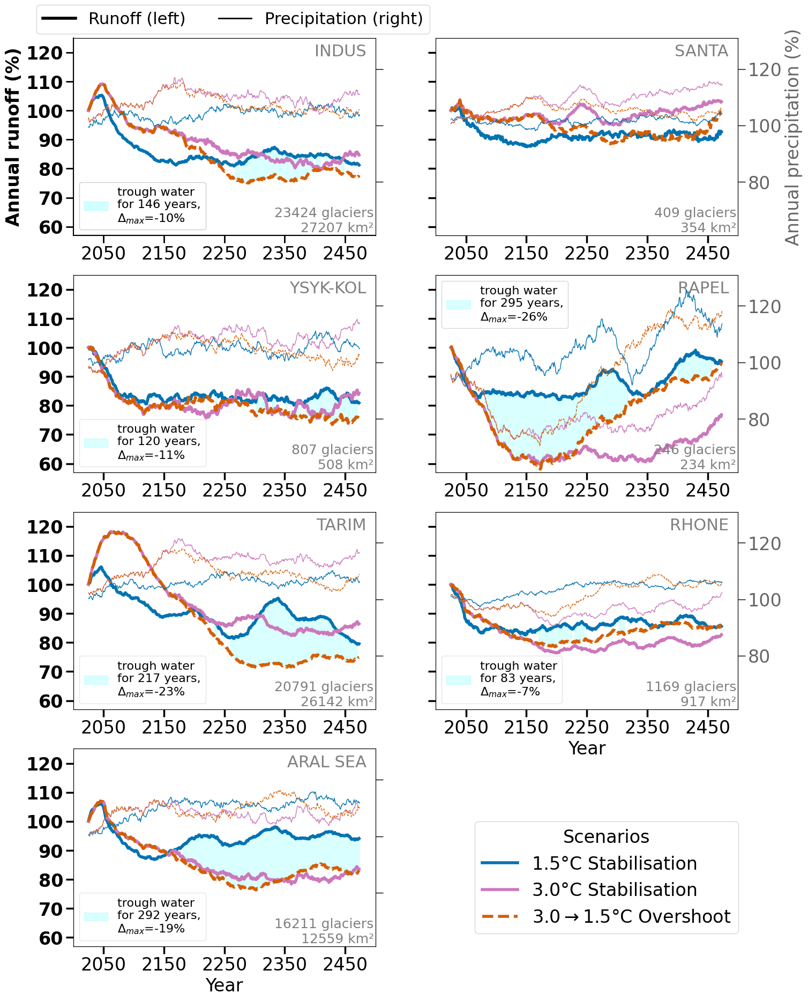

In [62]:
var = 'precip_51yr_avg'
basins = pd_basins_arid_glac_num.MRBID.values

plt.rc('font', size=24)

plt.figure(figsize=(16,22)) #, sharey=True, sharex=True)
plt.subplot(4,2,1)
ax = plt.gca()

ax.set_ylabel('Annual runoff (%)', weight='bold') # rel. to 2000-2050

basin = basins[0]
basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()#[0]
n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
glac_area = int(pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'RGI_AREA'].values.round(0))

continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
#basin_name = f'{continent_n}: {basin_n}'
basin_name = f'{basin_n}'

#ax.set_title(basin_name)
sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
             palette=list_color_scenario_poster_new_order,
             style = 'stab_vs_oversh',
             style_order=['stab', 'oversh'],
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=np.arange(0,150,10),
              labels=np.arange(0,150,10), weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = scenario_ls[scenario],
             lw=1, color = color_scenario[scenario], label=label_scenario_david[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(80,131,20)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6) 
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

ax.set_ylim([57,125]);
ax2.set_ylim([61,131]);


### add legends
handles, labels = ax.get_legend_handles_labels()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                fontsize=20, title_fontsize=22,loc = 'lower left', bbox_to_anchor=(-0.02,1.11), ncol=3)
for l in leg.get_lines():
    l.set_linewidth(4)
    

leg2 = ax.legend([handles[1], handles_2[0]], ['Runoff (left)',
                                              f'Precipitation (right)'],
                 loc='lower left', fontsize=22, bbox_to_anchor=(-0.15,0.98), ncol=2)
print(handles)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('black')
    
ax.get_legend().remove()

# let's not show again the legend ...
#ax.add_artist(leg)

plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

plt.text(0.995,0.005, f'{n_glaciers} glaciers\n{glac_area} km²',
     transform=ax.transAxes,ha='right',va='bottom',
     color='grey', fontsize=18, zorder=-1)

y0,y1 = water_trough_stats_basins['trough_water_pot_start_end'].loc[str(basin)].split('_')
pd_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)].dropna()
pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time

nyears,water_trough_max_diff  = water_trough_stats_basins[['yrs_with_trough_water',
                                                    'trough_water_max_diff']].loc[str(basin)]

water_trough_max_diff = np.round(float(water_trough_max_diff),0)
add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'
condi_5perc = (pd_basin_sel_oversh_T30OS15_runoff['runoff_rel_2000_2050_%']-pd_basin_sel_stab_T15_runoff['runoff_rel_2000_2050_%']).loc[float(y0):float(y1)+1]<=-5
# pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'].where(condi_5perc)
# important -> keep the NaNs to show the potential incontinuoties ... 
ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time.where(condi_5perc),  
                 pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'].where(condi_5perc), 
                 pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'].where(condi_5perc),
                 alpha = 0.15, color='cyan', zorder=-1, label='trough water\n'+add_label)

handles_x, labels_x = ax.get_legend_handles_labels()
leg3 = ax.legend([handles_x[-1]], [labels_x[-1]], loc='lower left',fontsize=16)
ax.add_artist(leg3)
ax.add_artist(leg2)



axs = []
for j, basin in enumerate(basins[1:]):
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()[0]
    n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
    glac_area = int(pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'RGI_AREA'].values.round(0))
    if basin_n=='TARIM HE (also TALIMU HE)':
        basin_n = 'TARIM' #\n(also TALIMU HE)'
    elif basin_n =='YSYK-KOL (also ISSYK-KUL)':
        basin_n =  'YSYK-KOL'
    continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
    #basin_name = f'{continent_n}: {basin_n}'
    basin_name = f'{basin_n}'

    plt.subplot(4,2,j+2)
    x_j = np.arange(1,20,2)
    x2_j = np.arange(0,20,2)

    ax = plt.gca()
    basin_runoff_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)]
    sns.lineplot(data=basin_runoff_sel,
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%',  
                 palette=list_color_scenario_poster_new_order,
                 style = 'stab_vs_oversh',
                 style_order=['stab', 'oversh'],
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)
    #ax.set_title(f'{Preg}: {basin}')

    plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)
    
    plt.text(0.995,0.005, f'{n_glaciers} glaciers\n{glac_area} km²',
     transform=ax.transAxes,ha='right',va='bottom',
     color='grey', fontsize=18, zorder=10)
    ax.set_ylabel('')
    if j in x_j:
        #plt.ylabel(f'annual runoff\n(% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=np.arange(0,150,10),
                   labels=np.arange(0,150,10), weight='bold')
    else:
        ax.set_yticks(ticks=np.arange(0,150,10),
                   labels=np.arange(0,150,10), alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);

    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_21yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g
        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = scenario_ls[scenario],
                 lw=1, color = color_scenario[scenario], label=label_scenario_david[scenario])
    if var != 'temp_21yr_avg':
        ticks = np.arange(80,131,20)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = 'Annual precipitation (%)' # rel. to 2000-2019)' #, glacier-area weighted)'
    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) rel. to 2000-2019\n(glacier-area weighted)'

    if j in x2_j:
        pass
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    if j == 0:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
    #ax2.set_ylim([-0.9,5.9]);

    if j >4:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([57,125]);
    ax2.set_ylim([61,131]);

    try:

        y0,y1 = water_trough_stats_basins['trough_water_pot_start_end'].loc[str(basin)].split('_')
        pd_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)].dropna()
        pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
        pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time

        nyears,water_trough_max_diff  = water_trough_stats_basins[['yrs_with_trough_water',
                                                            'trough_water_max_diff']].loc[str(basin)]

        water_trough_max_diff = np.round(float(water_trough_max_diff),0)
        add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'
        condi_5perc = (pd_basin_sel_oversh_T30OS15_runoff['runoff_rel_2000_2050_%']-pd_basin_sel_stab_T15_runoff['runoff_rel_2000_2050_%']).loc[float(y0):float(y1)+1]<=-5
        # pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'].where(condi_5perc)
        # important -> keep the NaNs to show the potential incontinuoties ... 
        ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time.where(condi_5perc),  
                         pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'].where(condi_5perc), 
                         pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'].where(condi_5perc),
                         alpha = 0.15, color='cyan', zorder=-1, label='trough water\n'+add_label)
        
        if basin_n == 'RAPEL':
            leg_t=ax.legend(loc='upper left', fontsize=16)        
        else:
            leg_t = ax.legend(loc='lower left', fontsize=16, framealpha = 0.5)
    except:
        print(f'no trough water: {basin}')
    axs.append(ax)
#plt.tight_layout()

from matplotlib.lines import Line2D
lines = []
#for k in color_scenario_poster.keys():
#    line = Line2D([0], [0], label=label_scenario[k], color=color_scenario_poster[k], lw=4)
#    lines.append(line)
for k in scenarios:
    line = Line2D([0], [0], ls=scenario_ls[k], label=label_scenario_david[k], color=color_scenario_poster[k], lw=4)
    lines.append(line)
axs[-2].set_xlabel('Year')
ax.legend(handles=lines, loc = 'lower left', bbox_to_anchor=(1.3,0.02), title = 'Scenarios')
ax.add_artist(leg_t)
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_51yr_avg_runoff_{bc}_vs_prcp_precip_51yr_avg.png')
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_51yr_avg_runoff_{bc}_vs_prcp_precip_51yr_avg.pdf')


**51-year average melt off/on**

In [ ]:
melt_water_trough_stats_basins

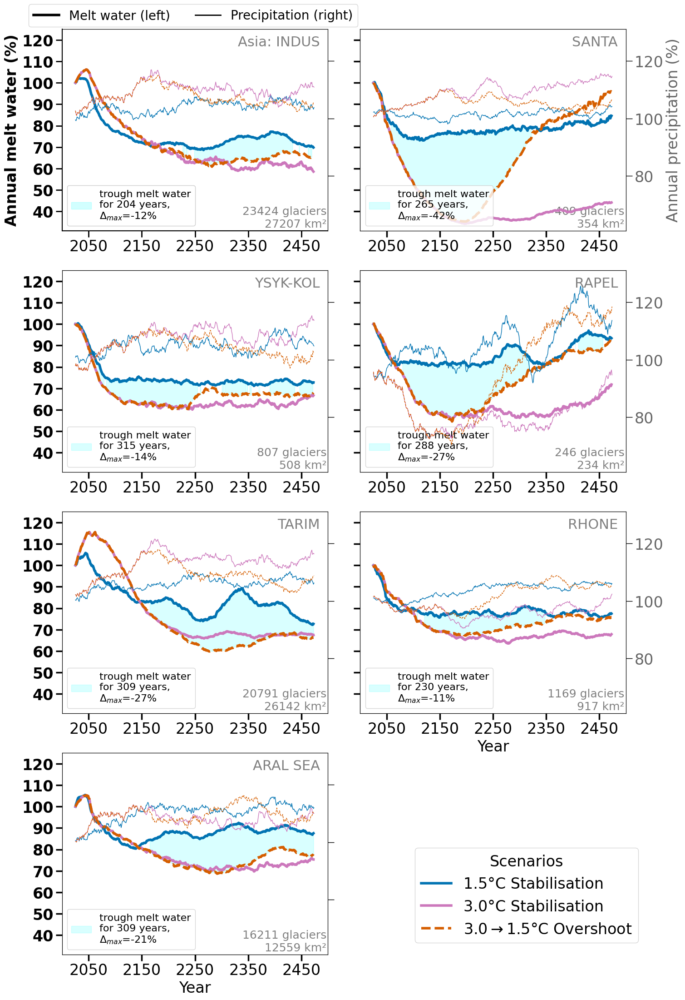

In [66]:
pd_melt_off_on_scenario_rel_basin['stab_vs_oversh'] = 'oversh'
pd_melt_off_on_scenario_rel_basin.loc[pd_melt_off_on_scenario_rel_basin['scenario'].apply(lambda x: 'stab' in x).values, 'stab_vs_oversh'] = 'stab'

var = 'precip_51yr_avg'
basins = pd_basins_arid_glac_num.MRBID.values

plt.rc('font', size=24)

plt.figure(figsize=(16,22)) #, sharey=True, sharex=True)
plt.subplot(4,2,1)
ax = plt.gca()

ax.set_ylabel('Annual melt water (%)', weight='bold') #relative to 2000-2050)'

basin = basins[0]
basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()#[0]
n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
glac_area = int(pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'RGI_AREA'].values.round(0))
continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
basin_name = f'{continent_n}: {basin_n}'
#ax.set_title(basin_name)
sns.lineplot(data=pd_melt_off_on_scenario_rel_basin.loc[pd_melt_off_on_scenario_rel_basin.basin == str(basin)],
             hue='scenario', x='time', y= 'melt_off_on_rel_2000_2050_%', 
             palette=list_color_scenario_poster_new_order,
             style = 'stab_vs_oversh',
             style_order=['stab', 'oversh'],
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=np.arange(0,150,10),
              labels=np.arange(0,150,10), weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = scenario_ls[scenario],
             lw=1, color = color_scenario[scenario], label=label_scenario_david[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(80,131,20)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6) 
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

ax.set_ylim([31,125]);
ax2.set_ylim([61,131]);


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                fontsize=20, title_fontsize=22,loc = 'lower left', bbox_to_anchor=(-0.02,1.11), ncol=3)
for l in leg.get_lines():
    l.set_linewidth(4)
    

leg2 = ax.legend([handles[1], handles_2[0]], ['Melt water (left)',
                                              f'Precipitation (right)'], #changes
                 loc='lower left', fontsize=20, bbox_to_anchor=(-0.15,0.98), ncol=2)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('black')
# let's not show again the legend ...
#ax.add_artist(leg)

plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

plt.text(0.995,0.005, f'{n_glaciers} glaciers\n{glac_area} km²',
     transform=ax.transAxes,ha='right',va='bottom',
     color='grey', fontsize=18, zorder=-1)

########
y0,y1 = melt_water_trough_stats_basins['melt_trough_water_pot_start_end'].loc[str(basin)].split('_')
pd_basin_sel = pd_melt_off_on_scenario_rel_basin.loc[pd_melt_off_on_scenario_rel_basin.basin == str(basin)].dropna()
pd_basin_sel_stab_T15_melt_off_on = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
pd_basin_sel_stab_T15_melt_off_on.index = pd_basin_sel_stab_T15_melt_off_on.time
pd_basin_sel_oversh_T30OS15_melt_off_on = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
pd_basin_sel_oversh_T30OS15_melt_off_on.index = pd_basin_sel_oversh_T30OS15_melt_off_on.time

nyears,water_trough_max_diff  = melt_water_trough_stats_basins[['yrs_with_melt_trough_water',
                                                    'melt_trough_water_max_diff']].loc[str(basin)]

water_trough_max_diff = np.round(float(water_trough_max_diff),0)
add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'
condi_5perc = (pd_basin_sel_oversh_T30OS15_melt_off_on['melt_off_on_rel_2000_2050_%']-pd_basin_sel_stab_T15_melt_off_on['melt_off_on_rel_2000_2050_%']).loc[float(y0):float(y1)+1]<=-5
# pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'].where(condi_5perc)
# important -> keep the NaNs to show the potential incontinuoties ... 
ax.fill_between(pd_basin_sel_stab_T15_melt_off_on.loc[float(y0):float(y1)+1].time.where(condi_5perc),  
                 pd_basin_sel_stab_T15_melt_off_on.loc[float(y0):float(y1)+1]['melt_off_on_rel_2000_2050_%'].where(condi_5perc), 
                 pd_basin_sel_oversh_T30OS15_melt_off_on.loc[float(y0):float(y1)+1]['melt_off_on_rel_2000_2050_%'].where(condi_5perc),
                 alpha = 0.15, color='cyan', zorder=-1, label='trough melt water\n'+add_label)

handles_x, labels_x = ax.get_legend_handles_labels()
leg3 = ax.legend([handles_x[-1]], [labels_x[-1]], loc='lower left',fontsize=16)
ax.add_artist(leg3)
ax.add_artist(leg2)

axs = []
axs2 = []
for j, basin in enumerate(basins[1:]):
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()[0]
    n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
    glac_area = int(pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'RGI_AREA'].values.round(0))

    if basin_n=='TARIM HE (also TALIMU HE)':
        basin_n = 'TARIM'
    elif basin_n =='YSYK-KOL (also ISSYK-KUL)':
        basin_n = 'YSYK-KOL'
    #continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
    basin_name = f'{basin_n}'
    plt.subplot(4,2,j+2)
    x_j = np.arange(1,20,2)
    x2_j = np.arange(0,20,2)

    ax = plt.gca()
    basin_melt_off_on_sel = pd_melt_off_on_scenario_rel_basin.loc[pd_melt_off_on_scenario_rel_basin.basin == str(basin)]
    sns.lineplot(data=basin_melt_off_on_sel,
             hue='scenario', x='time', y= 'melt_off_on_rel_2000_2050_%',  
             palette=list_color_scenario_poster_new_order,
             style = 'stab_vs_oversh',
             style_order=['stab', 'oversh'],
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)

    #ax.set_title(f'{Preg}: {basin}')

    plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)
    plt.text(0.995,0.005, f'{n_glaciers} glaciers\n{glac_area} km²',
     transform=ax.transAxes,ha='right',va='bottom',
     color='grey', fontsize=18, zorder=-1)

    if j in x_j:
        plt.ylabel(f'annual melt water\n(% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=np.arange(0,150,10),
                   labels=np.arange(0,150,10), weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=np.arange(0,150,10),
                   labels=np.arange(0,150,10), alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);


    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g
        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = scenario_ls[scenario],
                 lw=1, color = color_scenario[scenario], label=label_scenario_david[scenario])
    if var != 'temp_20yr_avg':
        ticks = np.arange(80,131,20)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = 'Annual precipitation (%)' # relative to 2000-2019)' #, glacier-area weighted)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

    if j in x2_j:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

    #ax2.set_ylim([-0.9,5.9]);

    if j >6:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([31,125]);
    ax2.set_ylim([61,131]);

    try:
        y0,y1 = melt_water_trough_stats_basins['melt_trough_water_pot_start_end'].loc[str(basin)].split('_')
        pd_basin_sel = pd_melt_off_on_scenario_rel_basin.loc[pd_melt_off_on_scenario_rel_basin.basin == str(basin)].dropna()
        pd_basin_sel_stab_T15_melt_off_on = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_stab_T15_melt_off_on.index = pd_basin_sel_stab_T15_melt_off_on.time
        pd_basin_sel_oversh_T30OS15_melt_off_on = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_oversh_T30OS15_melt_off_on.index = pd_basin_sel_oversh_T30OS15_melt_off_on.time

        nyears,water_trough_max_diff  = melt_water_trough_stats_basins[['yrs_with_melt_trough_water',
                                                            'melt_trough_water_max_diff']].loc[str(basin)]

        water_trough_max_diff = np.round(float(water_trough_max_diff),0)
        add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'
        condi_5perc = (pd_basin_sel_oversh_T30OS15_melt_off_on['melt_off_on_rel_2000_2050_%']-pd_basin_sel_stab_T15_melt_off_on['melt_off_on_rel_2000_2050_%']).loc[float(y0):float(y1)+1]<=-5
        # pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'].where(condi_5perc)
        # important -> keep the NaNs to show the potential incontinuoties ... 
        ax.fill_between(pd_basin_sel_stab_T15_melt_off_on.loc[float(y0):float(y1)+1].time.where(condi_5perc),  
                         pd_basin_sel_stab_T15_melt_off_on.loc[float(y0):float(y1)+1]['melt_off_on_rel_2000_2050_%'].where(condi_5perc), 
                         pd_basin_sel_oversh_T30OS15_melt_off_on.loc[float(y0):float(y1)+1]['melt_off_on_rel_2000_2050_%'].where(condi_5perc),
                         alpha = 0.15, color='cyan', zorder=-1, label='trough melt water\n'+add_label)
        leg_t = ax.legend(loc='lower left', fontsize=16)        

        add_normal_trough_water = False
        if add_normal_trough_water:
            y0,y1 = water_trough_stats_basins['water_trough_start_end'].loc[str(basin)].split('_')
            pd_basin_sel = pd_melt_off_on_scenario_rel_basin.loc[pd_melt_off_on_scenario_rel_basin.basin == str(basin)].dropna()
            pd_basin_sel_stab_T15_melt_off_on = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
            pd_basin_sel_stab_T15_melt_off_on.index = pd_basin_sel_stab_T15_melt_off_on.time
            pd_basin_sel_oversh_T30OS15_melt_off_on = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
            pd_basin_sel_oversh_T30OS15_melt_off_on.index = pd_basin_sel_oversh_T30OS15_melt_off_on.time

            nyears,water_trough_max_diff  = water_trough_stats_basins[['yrs_with_water_trough',
                                                                'water_trough_max_diff']].loc[str(basin)]

            water_trough_max_diff = np.round(float(water_trough_max_diff),0)
            add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'
            ax.fill_between(pd_basin_sel_stab_T15_melt_off_on.loc[float(y0):float(y1)+1].time, 
                             pd_basin_sel_stab_T15_melt_off_on.loc[float(y0):float(y1)+1]['melt_off_on_rel_2000_2050_%'], 
                             pd_basin_sel_oversh_T30OS15_melt_off_on.loc[float(y0):float(y1)+1]['melt_off_on_rel_2000_2050_%'],
                             alpha = 0.1, color='cyan', zorder=-1, label='trough water\n'+add_label)
        #if basin_n == 'RAPEL':
        #else:
        #ax.legend(loc='lower left', fontsize=20)
    except:
        print(f'no trough water: {basin}')
    axs.append(ax)
    axs2.append(ax2)
axs[0].set_title('blub')
plt.tight_layout()


from matplotlib.lines import Line2D
lines = []
#for k in color_scenario_poster.keys():
#    line = Line2D([0], [0], label=label_scenario[k], color=color_scenario_poster[k], lw=4)
#    lines.append(line)
for k in scenarios:
    line = Line2D([0], [0], ls=scenario_ls[k], label=label_scenario_david[k], color=color_scenario_poster[k], lw=4)
    lines.append(line)
axs[-2].set_xlabel('Year')
ax.legend(handles=lines, loc = 'lower left', bbox_to_anchor=(1.3,0.02), title = 'Scenarios')
ax.add_artist(leg_t)
    
    
axs[-2].set_xlabel('Year')
axs[-1].set_xlabel('Year')

for axi in axs[1:]:
    axi.set_ylabel('')
for ax2i in axs2[1:]:
    ax2i.set_ylabel('')
axs[0].set_title('')
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_51yr_avg_melt_off_on_{bc}_vs_prcp_precip_51yr_avg.png')
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_51yr_avg_melt_off_on_{bc}_vs_prcp_precip_51yr_avg.pdf')


## ***Some comparisons to precipitation effects*** (now again for all basins and looking at annual runoff)

In [67]:
basin_glac_ind = pd_basin_num.where(pd_basin_num['RGI_AREA'] / pd_basin_num['AREA_CALC']> 0.001).dropna(how='all').MRBID.astype(int).astype(str).values
water_trough_stats_basins_sel = water_trough_stats_basins.loc[basin_glac_ind].copy()

In [68]:
len(water_trough_stats_basins_sel.where(condi_vol_diff).dropna(how='all'))

56

In [69]:
len(water_trough_stats_basins_sel.where(condi_vol_diff& condi_after_2150).dropna(how='all'))

46

In [70]:
len(water_trough_stats_basins_sel.where(condi_trough).dropna(how='all'))

32

In [71]:
water_trough_stats_basins.corr_coef_oversh_temp_precip

4110    0.829802
4123    0.818637
4125    0.201568
4401    0.829818
4406    0.455459
          ...   
3423   -0.881893
3426    0.481697
3428   -0.794695
3429   -0.780485
5406    0.623385
Name: corr_coef_oversh_temp_precip, Length: 75, dtype: float64

In [72]:
len(water_trough_stats_basins_sel.dropna(how='all'))

60

In [73]:
condi_slope_clear = water_trough_stats_basins.corr_coef_oversh_temp_precip**2>0.3
condi_slope_pos = water_trough_stats_basins['slope_oversh_temp_precip'] > 10  # 3% increase on average between 2050 and 2350
condi_slope_neg = water_trough_stats_basins['slope_oversh_temp_precip'] < -10

print(len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_slope_pos& condi_slope_clear).dropna()), len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_slope_neg& condi_slope_clear).dropna()))

9 15


In [76]:
# precipitation decreases with increasing temperatures 
water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna().where(water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna()['slope_oversh_temp_precip']<0)['trough_water_max_diff'].quantile([0.25,0.5,0.75])

0.25    12.875462
0.50    16.772171
0.75    22.947390
Name: trough_water_max_diff, dtype: float64

In [78]:
# precipitation increases with increasing temperatures 
water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna().where(water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna()['slope_oversh_temp_precip']>0)['trough_water_max_diff'].quantile([0.25,0.5,0.75])

0.25     8.715115
0.50     9.731586
0.75    14.813953
Name: trough_water_max_diff, dtype: float64

In [79]:
len(water_trough_stats_basins_sel.where(condi_slope_clear).dropna())

25

12
17
32


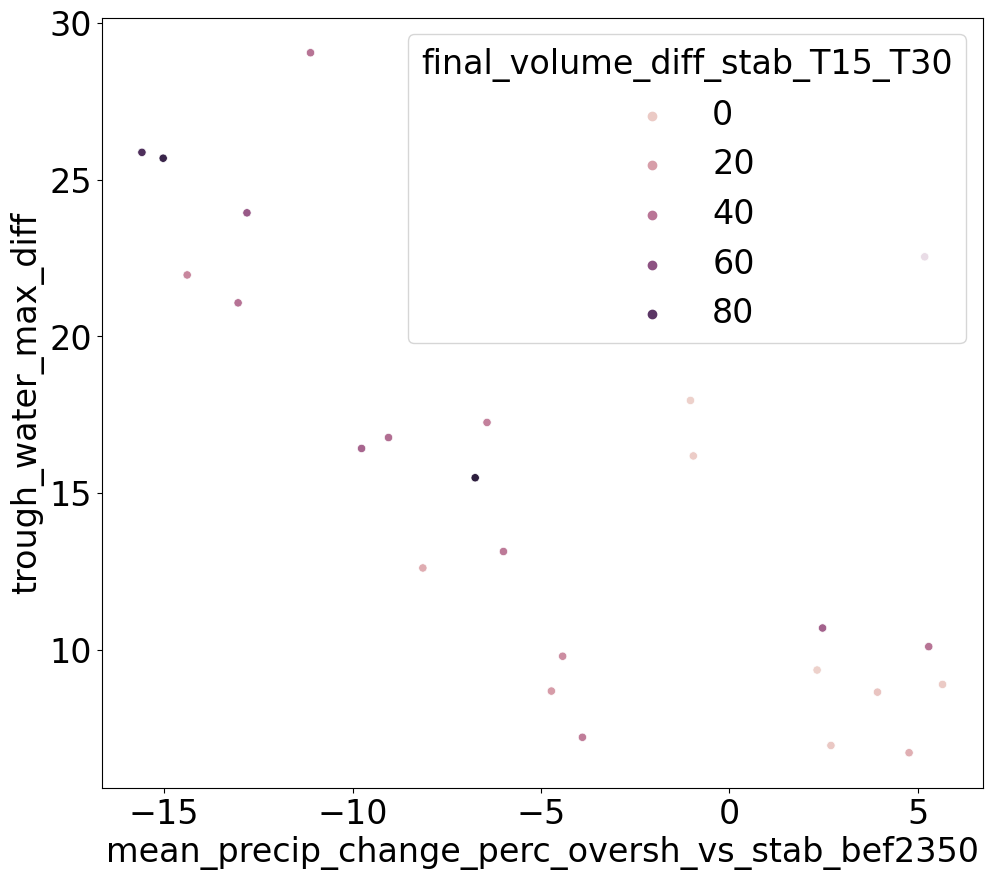

In [81]:
plt.figure(figsize=(25,10))
plt.subplot(121)
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_slope_clear).dropna(),
                y='trough_water_max_diff',
                x='mean_precip_change_perc_oversh_vs_stab_bef2350',
                color='red', hue= 'final_volume_diff_stab_T15_T30') #, label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 

condi_prcp_increase = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] > 1  # 3% increase on average between 2050 and 2350
condi_prcp_decrease = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] < -1

print(len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna()))
print(len(water_trough_stats_basins_sel.where(condi_vol_diff &  condi_prcp_decrease).dropna()))
print(len(water_trough_stats_basins_sel.trough_water_max_diff.dropna()))

In [83]:
water_trough_stats_basins_sel['trough_water_max_diff_no_NaNs'] = water_trough_stats_basins_sel['trough_water_max_diff'].copy()
water_trough_stats_basins_sel['yrs_with_trough_water_no_NaNs'] = water_trough_stats_basins_sel['yrs_with_trough_water'].copy()

water_trough_stats_basins_sel['cumulative_runoff_diff_trough_no_NaNs'] = water_trough_stats_basins_sel['cumulative_runoff_diff_trough'].astype(float)
water_trough_stats_basins_sel.loc[water_trough_stats_basins_sel.trough_water_max_diff_no_NaNs.isna(),'trough_water_max_diff_no_NaNs'] = 0
water_trough_stats_basins_sel.loc[water_trough_stats_basins_sel.yrs_with_trough_water_no_NaNs.isna(),'yrs_with_trough_water_no_NaNs'] = 0

water_trough_stats_basins_sel.loc[water_trough_stats_basins_sel.cumulative_runoff_diff_trough_no_NaNs.isna(),'cumulative_runoff_diff_trough_no_NaNs'] = 0


In [84]:
len(water_trough_stats_basins_sel.where(water_trough_stats_basins_sel['trough_water_max_diff_no_NaNs'].dropna()>0).dropna(how='all'))

32

In [85]:
len(water_trough_stats_basins_sel)

60

31 24
31 24
46


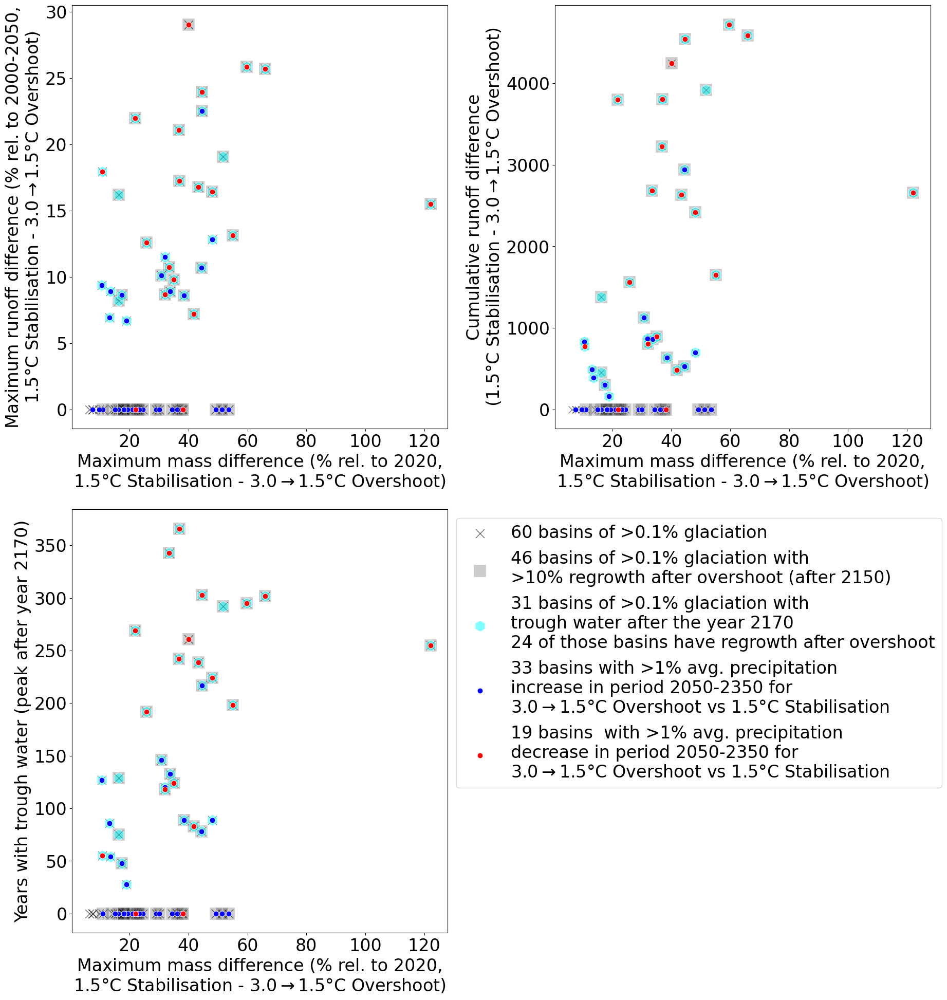

In [89]:
plt.figure(figsize=(20,20))

condi_prcp_increase = water_trough_stats_basins_sel['mean_precip_change_perc_oversh_vs_stab_bef2350'] > 1  # 3% increase on average between 2050 and 2350
condi_prcp_decrease = water_trough_stats_basins_sel['mean_precip_change_perc_oversh_vs_stab_bef2350'] < -1
plt.subplot(221)
x = 'max_volume_diff_perc_stab_T15_vs_oversh30'
y = 'trough_water_max_diff_no_NaNs'
n=len(water_trough_stats_basins_sel[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel[[y,x]].dropna(how='all'), #.where(condi_trough).dropna(),
                y=y, x=x, color='black', 
                alpha = 0.6, marker='x', s= 150,
                label=f'{n} basins of >0.1% glaciation') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[[y,x]].dropna(how='all'), #.where(condi_trough).dropna(),
                y=y, x=x, color='black', 
                alpha = 0.2, marker='s', s= 300,
                label=f'{n} basins of >0.1% glaciation with\n>10% regrowth after 2150') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)


n=len(water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170)[[y,x]].dropna(how='all'))
n2=len(water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170& condi_after_2150 & condi_vol_diff)[[y,x]].dropna(how='all'))
print(n,n2)

sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170)[[y,x]].dropna(how='all'), #.where(condi_trough).dropna(),
                y=y, x=x, color='cyan', 
                alpha = 0.5, marker='h', s= 250,
                label=f'{n} basins of >0.1% glaciation with\ntrough water after the year 2170\n{n2} of those basins have regrowth after overshoot') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)


n=len(water_trough_stats_basins_sel.where(condi_prcp_increase)[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_increase)[[y,x]].dropna(how='all'),
                y=y, x=x,s=60,
                 color='blue',
                label=f'{n} basins with >1% avg. precipitation\nincrease in period 2050-2350 for\n'+r'3.0$\rightarrow$1.5°C Overshoot vs 1.5°C Stabilisation')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_prcp_decrease)[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_decrease)[[y,x]].dropna(how='all'),
                y=y, x=x, s= 60,
                color='red', label=f'{n} basins  with >1% avg. precipitation\ndecrease in period 2050-2350 for\n'+r'3.0$\rightarrow$1.5°C Overshoot vs 1.5°C Stabilisation') 
leg = plt.legend(fontsize=18)
leg.remove()
plt.ylabel('Maximum runoff difference (% rel. to 2000-2050,\n'+r'1.5°C Stabilisation - 3.0$\rightarrow$1.5°C Overshoot)')
plt.xlabel('Maximum mass difference (% rel. to 2020,\n'+r'1.5°C Stabilisation - 3.0$\rightarrow$1.5°C Overshoot)')


plt.subplot(222)
x = 'max_volume_diff_perc_stab_T15_vs_oversh30'
y = 'cumulative_runoff_diff_trough_no_NaNs'
n=len(water_trough_stats_basins_sel[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel[[y,x]].dropna(how='all'), #.where(condi_trough).dropna(),
                y=y, x=x, color='black', 
                alpha = 0.6, marker='x', s= 100,
                label=f'{n} basins of >0.1% glaciation') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[[y,x]].dropna(how='all'), #.where(condi_trough).dropna(),
                y=y, x=x, color='black', 
                alpha = 0.2, marker='s', s= 300,
                label=f'{n} basins of >0.1% glaciation with\n>10% regrowth after 2150') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)



n=len(water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170)[[y,x]].dropna(how='all'))
n2=len(water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170& condi_after_2150 & condi_vol_diff)[[y,x]].dropna(how='all'))
print(n,n2)
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170)[['cumulative_runoff_diff_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'), #.where(condi_trough).dropna(),
               y=y, x=x, color='cyan', 
                alpha = 0.5, marker='h', s= 250,
                label=f'{n} basins of >0.1% glaciation with\ntrough water after the year 2170\n{n2} of those basins have regrowth after overshoot') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)


n=len(water_trough_stats_basins_sel.where(condi_prcp_increase)[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_increase)[[y,x]].dropna(how='all'),
                y=y, x=x,s=60,
                color='blue', label=f'{n} basins with >1% avg. precipitation\nincrease in period 2050-2350 for\n'+r'3.0$\rightarrow$1.5°C Overshoot vs 1.5°C Stabilisation')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_prcp_decrease)[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_decrease)[[y,x]].dropna(how='all'),
                y=y, x=x, s= 60,
                color='red', label=f'{n} basins  with >1% avg. precipitation\ndecrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation') 
leg = plt.legend(fontsize=18)
leg.remove()
plt.ylabel('Cumulative runoff difference\n'+r'(1.5°C Stabilisation - 3.0$\rightarrow$1.5°C Overshoot)')
plt.xlabel('Maximum mass difference (% rel. to 2020,\n'+r'1.5°C Stabilisation - 3.0$\rightarrow$1.5°C Overshoot)')


plt.subplot(223)
x = 'max_volume_diff_perc_stab_T15_vs_oversh30'
y = 'yrs_with_trough_water_no_NaNs'
n=len(water_trough_stats_basins_sel[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel[[y,x]].dropna(how='all'), #.where(condi_trough).dropna(),
                y=y, x=x, color='black', 
                alpha = 0.6, marker='x', s= 150,
                label=f'{n} basins of >0.1% glaciation') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[[y,x]].dropna(how='all'))
print(n)
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[[y,x]].dropna(how='all'), #.where(condi_trough).dropna(),
                y=y, x=x, color='black', 
                alpha = 0.2, marker='s', s= 300,
                label=f'{n} basins of >0.1% glaciation with\n>10% regrowth after overshoot (after 2150)') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)


## all that have a trough and have at least 10%  lager glacier volume 
#print('basins that are 0.1% glaciated, and create a trough water after the year 2170:')
#print(len(water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170).dropna(how='all')))

# all that have a trough and have at least 10%  lager glacier volume 
#print('basins that are 0.1% glaciated, have at least a mass difference of 10% after the global overshoot and create a trough water after the year 2170:')
#print(len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff & condi_after_2150 & condi_water_trough_2170).dropna(how='all')))

n=len(water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170)[[y,x]].dropna(how='all'))
n2=len(water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170& condi_after_2150 & condi_vol_diff)[[y,x]].dropna(how='all'))

sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough  & condi_water_trough_2170)[[y,x]].dropna(how='all'), #.where(condi_trough).dropna(),
                y=y, x=x,color='cyan', 
                alpha = 0.5, marker='h', s= 250,
                label=f'{n} basins of >0.1% glaciation with\ntrough water after the year 2170\n{n2} of those basins have regrowth after overshoot') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)


n=len(water_trough_stats_basins_sel.where(condi_prcp_increase&condi_vol_diff)[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_increase&condi_vol_diff)[[y,x]].dropna(how='all'),
                y=y, x=x,s=60,
                color='blue', label=f'{n} basins with >1% avg. precipitation\nincrease in period 2050-2350 for\n'+r'3.0$\rightarrow$1.5°C Overshoot vs 1.5°C Stabilisation')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_prcp_decrease&condi_vol_diff)[[y,x]].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_decrease&condi_vol_diff)[[y,x]].dropna(how='all'),
                y=y, x=x, s= 60,
                color='red', label=f'{n} basins  with >1% avg. precipitation\ndecrease in period 2050-2350 for\n'+r'3.0$\rightarrow$1.5°C Overshoot vs 1.5°C Stabilisation') 

plt.ylabel('Years with trough water (peak after year 2170)')
plt.xlabel('Maximum mass difference (% rel. to 2020,\n'+r'1.5°C Stabilisation - 3.0$\rightarrow$1.5°C Overshoot)')
plt.tight_layout()
plt.legend(fontsize=24, bbox_to_anchor=(1,1), loc = 'upper left')
plt.savefig('figures/figures_basins/3_suppl_trough_water_basins_analysis.png')
plt.savefig('figures/figures_basins/3_suppl_trough_water_basins_analysis.pdf')

In [90]:
with open('basin_glac_cluster_fig3_dictionary.json', 'r') as json_file:
    basin_glac_clus_dict = json.load(json_file)

In [91]:
pd_basin_glac_clus = pd.DataFrame(basin_glac_clus_dict.values(), columns=['basin_glac_cluster_fig3'], index = basin_glac_clus_dict.keys())

In [92]:
water_trough_stats_basins_sel.loc[pd_basin_glac_clus.index, 'basin_glac_cluster_fig3'] = pd_basin_glac_clus.basin_glac_cluster_fig3

In [93]:
cols = sns.color_palette(['black','C8','C8','C5'])

In [94]:
water_trough_stats_basins_sel.loc[water_trough_stats_basins_sel.basin_glac_cluster_fig3 == 0]

,yrs_with_trough_water,cumulative_runoff_diff_trough,trough_water_min_year,trough_water_max_diff,trough_water_pot_start_end,peak_temp_diff_oversh_vs_stab_bef2350,yr_peak_temp_diff_oversh_vs_stab_bef2350,regional_warming_aft2350,cumsum_temp_diff_oversh_stab_bef2350,cumsum_temp_diff_oversh_stab_aft2350,...,slope_oversh_temp_precip,max_volume_diff_perc_stab_T15_vs_oversh30,yr_with_max_volume_diff_stab_T15_vs_oversh30,final_volume_diff_stab_T15_T30,mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350,basin_name,trough_water_max_diff_no_NaNs,yrs_with_trough_water_no_NaNs,cumulative_runoff_diff_trough_no_NaNs,basin_glac_cluster_fig3
4401,0.0,NaN,NaN,NaN,NaN,1.763256,2179.0,0.671886,219.600523,22.809479,...,120.954992,10.958569,2250.0,18.073639,-2.004019,ALSEK,0.0,0.0,0.0,0.0
4408,0.0,NaN,NaN,NaN,NaN,2.111167,2179.0,0.681674,268.601112,30.377593,...,85.130012,18.003635,2250.0,28.034710,-4.403761,COPPER,0.0,0.0,0.0,0.0
4414,0.0,NaN,NaN,NaN,NaN,2.607044,2179.0,0.680704,338.952428,25.081157,...,45.618759,24.441326,2242.0,25.858887,32.449789,KUSKOKWIM,0.0,0.0,0.0,0.0
4416,0.0,NaN,NaN,NaN,NaN,2.147287,2179.0,0.809032,276.580270,25.436358,...,113.761792,15.111809,2098.0,14.692422,-2.027672,NASS,0.0,0.0,0.0,0.0
4418,0.0,NaN,NaN,NaN,NaN,2.692178,2179.0,0.688907,342.431031,24.291771,...,43.594681,9.630787,2190.0,7.980759,11.228445,NUSHAGAK,0.0,0.0,0.0,0.0
4428,0.0,NaN,NaN,NaN,NaN,2.070715,2179.0,0.764599,266.572216,25.839203,...,119.496792,17.973942,2188.0,25.974354,-2.214376,STIKINE,0.0,0.0,0.0,0.0
4430,0.0,NaN,NaN,NaN,NaN,2.526665,2221.0,0.665723,332.821529,24.151059,...,39.597041,22.695934,2244.0,26.533960,-18.201734,SUSITNA,0.0,0.0,0.0,0.0
4431,0.0,NaN,NaN,NaN,NaN,2.007027,2179.0,0.737150,257.851308,25.639776,...,116.105631,18.041462,2369.0,27.579624,-2.120314,TAKU,0.0,0.0,0.0,0.0
4435,0.0,NaN,NaN,NaN,NaN,2.176566,2179.0,0.669143,284.214888,27.154411,...,68.665628,23.195908,2242.0,30.618952,-3.860716,YUKON,0.0,0.0,0.0,0.0


Text(0.5, 0, 'Maximum mass difference (% rel. to 2020,\n1.5°C Stabilisation - 3.0°C->1.5°C Overshoot)')

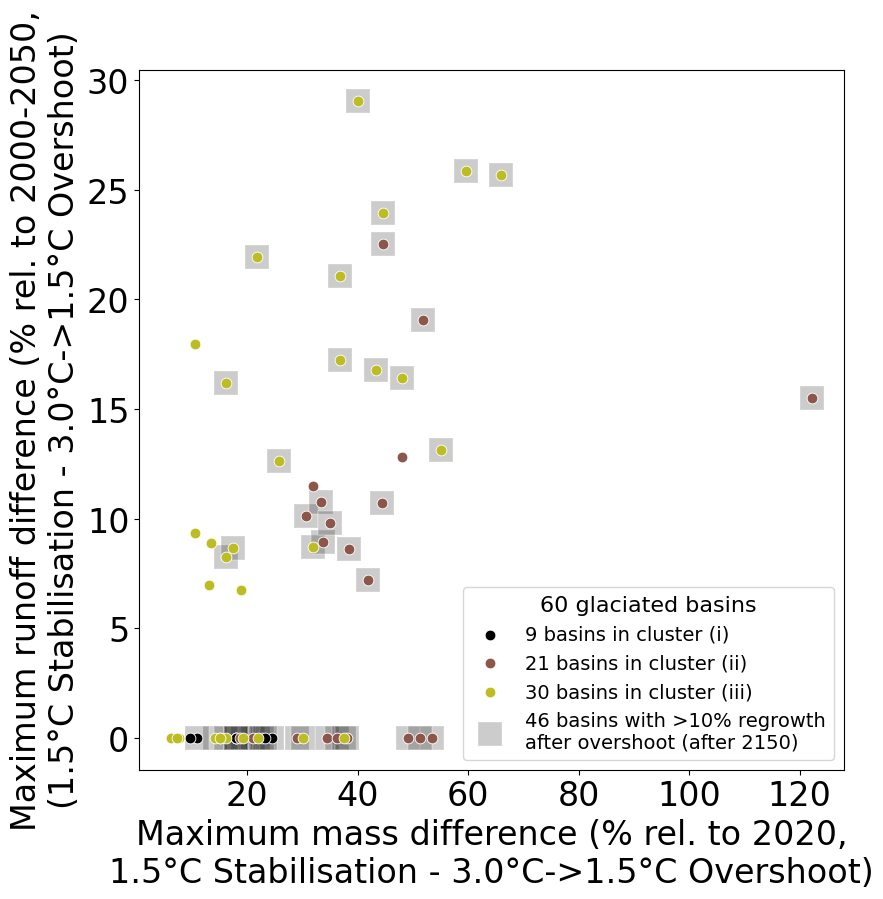

In [95]:
plt.figure(figsize=(20,20))

condi_clus_black = water_trough_stats_basins_sel['basin_glac_cluster_fig3'] == 0  # 3% increase on average between 2050 and 2350
condi_clus_yellow = (water_trough_stats_basins_sel['basin_glac_cluster_fig3'] == 1) #| (water_trough_stats_basins_sel['basin_glac_cluster_fig3'] == 2)
condi_clus_brown = water_trough_stats_basins_sel['basin_glac_cluster_fig3'] == 2

plt.subplot(221)
#n=len(water_trough_stats_basins_sel[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'))
#sns.scatterplot(data = water_trough_stats_basins_sel[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'), #.where(condi_trough).dropna(),
#                y='water_trough_max_diff_no_NaNs',
#                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
#                alpha = 0.6, marker='x', s= 150,
#                label=f'{n} basins of >0.1% glaciation') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)


n=len(water_trough_stats_basins_sel.where(condi_clus_black)[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_clus_black)[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'),
                y='trough_water_max_diff_no_NaNs',s=60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color=cols[0],
                label = f'{n} basins in cluster (i)') #, label=f'{n} basins with >1% avg. precipitation\nincrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_clus_brown)[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_clus_brown)[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'),
                y='trough_water_max_diff_no_NaNs', s= 60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color=cols[-1], label = f'{n} basins in cluster (ii)') # , label=f'{n} basins  with >1% avg. precipitation\ndecrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation') 


n=len(water_trough_stats_basins_sel.where(condi_clus_yellow)[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_clus_yellow)[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'),
                y='trough_water_max_diff_no_NaNs', s= 60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color=cols[1], label = f'{n} basins in cluster (iii)') # , label=f'{n} basins  with >1% avg. precipitation\ndecrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation') 


n=len(water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(how='all'), #.where(condi_trough).dropna(),
                y='trough_water_max_diff_no_NaNs',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
                alpha = 0.2, marker='s', s= 300,
                label=f'{n} basins with >10% regrowth\nafter overshoot (after 2150)', zorder=-1) #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)


leg = plt.legend(title = '60 glaciated basins', fontsize=14, loc = 'lower right', title_fontsize=16)#leg.remove()
plt.ylabel('Maximum runoff difference (% rel. to 2000-2050,\n(1.5°C Stabilisation - 3.0°C->1.5°C Overshoot)')
plt.xlabel('Maximum mass difference (% rel. to 2020,\n1.5°C Stabilisation - 3.0°C->1.5°C Overshoot)')



### Decreasing vs increasing prcp analysis

12
17
32
water trough intensity ratio of decreasing vs increasing prcp basins:
1.8353683532076506


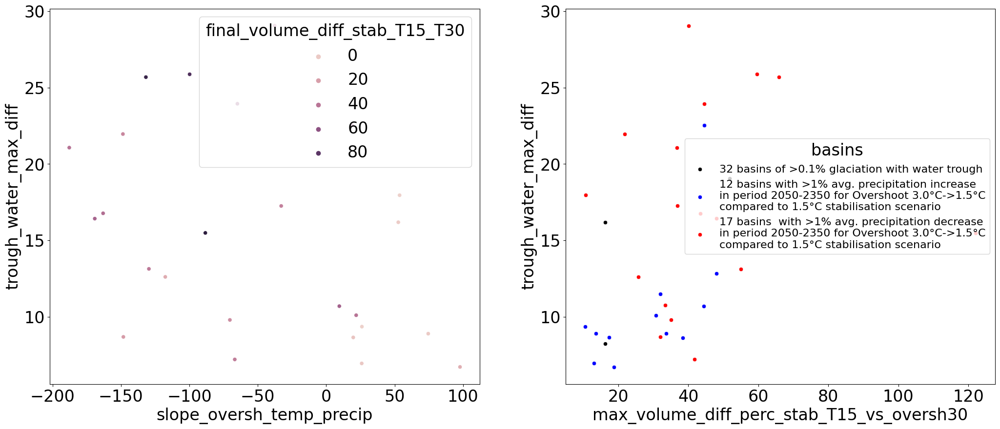

In [102]:
plt.figure(figsize=(25,10))
plt.subplot(121)
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna(),
                y='trough_water_max_diff',
                x='slope_oversh_temp_precip',
                color='red', hue= 'final_volume_diff_stab_T15_T30') #, label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 

condi_prcp_increase = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] > 1  # 3% increase on average between 2050 and 2350
condi_prcp_decrease = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] < -1

print(len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna()))
print(len(water_trough_stats_basins_sel.where(condi_vol_diff &  condi_prcp_decrease).dropna()))
print(len(water_trough_stats_basins_sel.trough_water_max_diff.dropna()))

plt.subplot(122)
n=len(water_trough_stats_basins_sel.where(condi_trough).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough).dropna(),
                y='trough_water_max_diff',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', label=f'{n} basins of >0.1% glaciation with water trough') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_trough & condi_prcp_increase).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough & condi_prcp_increase).dropna(),
                y='trough_water_max_diff',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='blue', label=f'{n} basins with >1% avg. precipitation increase\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_trough & condi_prcp_decrease).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough & condi_prcp_decrease).dropna(),
                y='trough_water_max_diff',
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color='red', label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 
#, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax

plt.legend(title='basins', fontsize=16)
print(f'water trough intensity ratio of decreasing vs increasing prcp basins:')
print(water_trough_stats_basins_sel.where(condi_trough & condi_prcp_decrease).dropna().trough_water_max_diff.median() / water_trough_stats_basins_sel.where(condi_trough & condi_prcp_increase).dropna().trough_water_max_diff.median())

<AxesSubplot:xlabel='mean_precip_change_perc_oversh_vs_stab_bef2350', ylabel='trough_water_max_diff'>

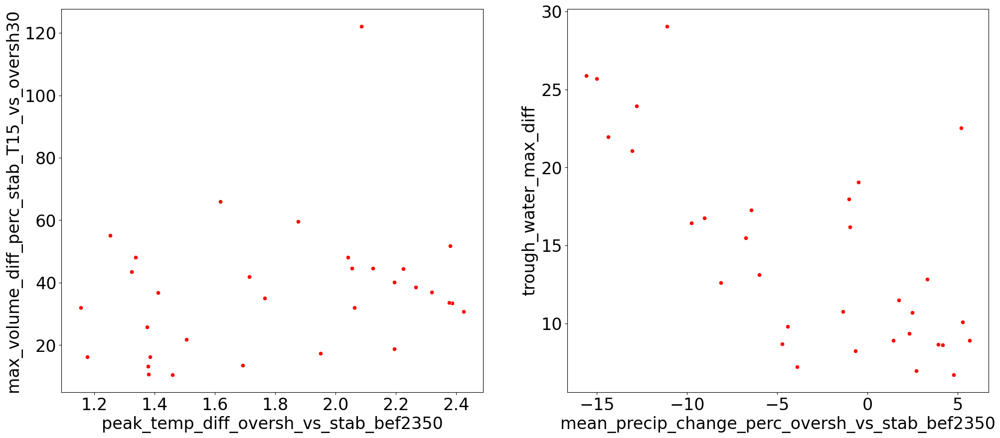

In [104]:
plt.figure(figsize=(24,10))
plt.subplot(121)
#no relation ... 
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough).dropna(),
                y='max_volume_diff_perc_stab_T15_vs_oversh30',
                x='peak_temp_diff_oversh_vs_stab_bef2350',
                color='red') 
plt.subplot(122)
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough).dropna(),
                y='trough_water_max_diff',
                x='mean_precip_change_perc_oversh_vs_stab_bef2350',
                color='red') #, 
#label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 f
#or Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 

#, label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 

In [105]:
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna().trough_water_max_diff.median()

9.138313293457031

In [106]:
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna().trough_water_max_diff.median()

16.772171020507812

In [107]:
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna().trough_water_max_diff.median() / water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna().trough_water_max_diff.median()

1.8353683532076506

In [108]:
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna().trough_water_max_diff.median() / water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna().trough_water_max_diff.median()

1.8353683532076506

In [109]:
water_trough_stats_basins_sel['cumulative_runoff_diff_trough'] = water_trough_stats_basins_sel.cumulative_runoff_diff_trough.astype(float)
water_trough_stats_basins_sel['yrs_with_trough_water'] = water_trough_stats_basins_sel.yrs_with_trough_water.astype(float)
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna().cumulative_runoff_diff_trough.median() / water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna().cumulative_runoff_diff_trough.median()

3.9817929545068598

**The water trough maximum is around 2 times larger for basins where precipitation decreases for warmer temperatures and the cumulative runoff difference is 4 times larger ...** 

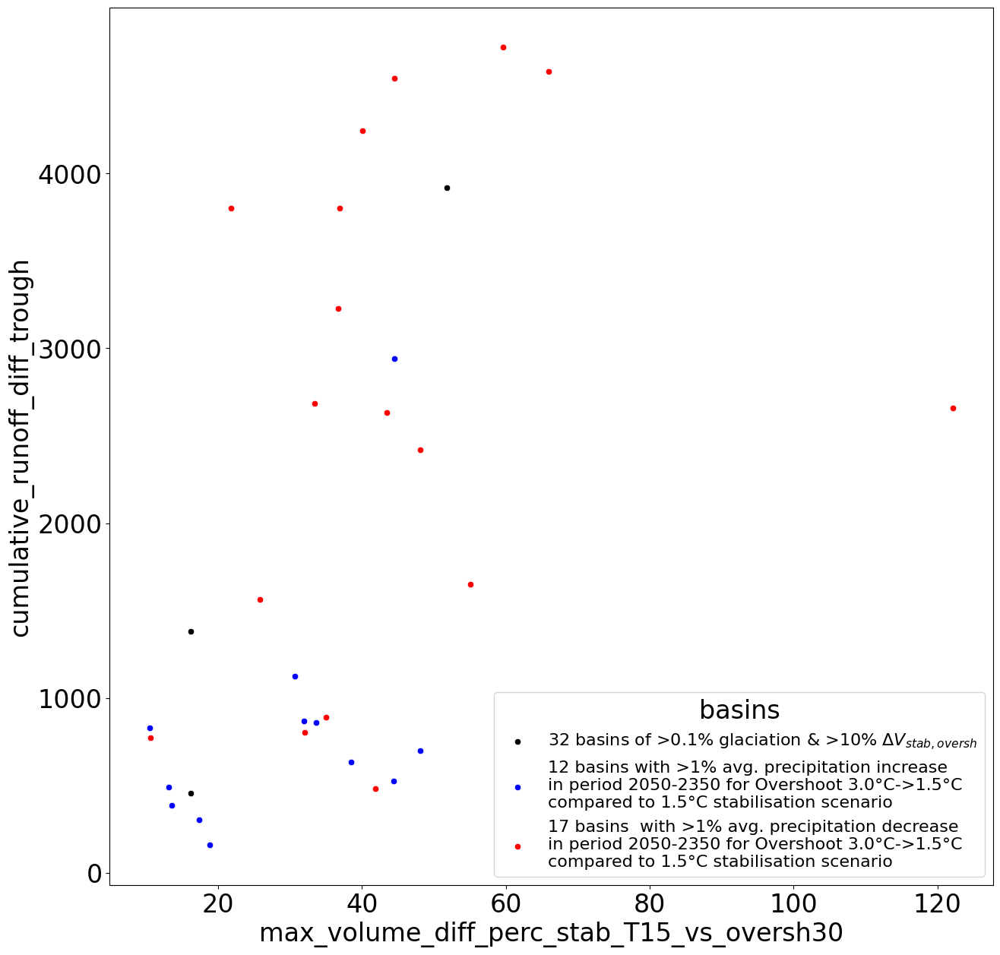

In [110]:
plt.figure(figsize=(15,15))
n=len(water_trough_stats_basins_sel.where(condi_vol_diff).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff).dropna(),
                y='cumulative_runoff_diff_trough',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black',
                label=f'{n} basins of >0.1% glaciation & >10%'+r' $\Delta V_{stab,oversh}$') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna(),
                y='cumulative_runoff_diff_trough',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='blue',
                label=f'{n} basins with >1% avg. precipitation increase\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna(),
                y='cumulative_runoff_diff_trough',
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color='red', label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 
#, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax

plt.legend(title='basins', fontsize=16)

## Selected three driest consecutive months

The three-month period precipitation seasonality was computed by three-month rolling average basin precipitation which is then for each month averaged over the 30-year period. Subsequently, the six-month period with the highest melt within a year was estimated from the glacier simulations, during which the driest three-month period was selected. 

In [111]:
#**I was confused why I get negative values out of a rollling sum of positive values ...**
# the issue was numerical instabiliity of rolling.sum or rolling.mean ... : https://github.com/pydata/xarray/issues/7128
xr.set_options(use_bottleneck=False)

In [112]:
pd_clim_basin_new = pd.read_csv('../annual_basin_glacier_mask_temp_precip_timeseries_oversh_stab.csv', index_col=0)

In [113]:
pd_clim_basin_new

,temp,temp_20yr_avg,temp_21yr_avg,precip,precip_20yr_avg,precip_21yr_avg,precip_3mdriest_avg_per_day,precip_3mdriest_avg_per_day_51yr_avg,month_precip_3mdriest_past_W5E5,region,scenario,year
0,260.653936,NaN,NaN,524.905004,NaN,NaN,0.452952,NaN,4,basin_2103_glacier,stab_T12,1979
1,259.565625,NaN,NaN,435.133124,NaN,NaN,0.603950,NaN,4,basin_2103_glacier,stab_T12,1980
2,259.495012,NaN,NaN,532.624292,NaN,NaN,0.837969,NaN,4,basin_2103_glacier,stab_T12,1981
3,260.754168,NaN,NaN,468.480691,NaN,NaN,0.739654,NaN,4,basin_2103_glacier,stab_T12,1982
4,261.707755,NaN,NaN,488.840548,NaN,NaN,0.859279,NaN,4,basin_2103_glacier,stab_T12,1983
...,...,...,...,...,...,...,...,...,...,...,...,...
312595,272.739685,NaN,NaN,720.887939,NaN,NaN,1.129198,NaN,4,basin_6255_glacier,stab_T30,2495
312596,273.370209,NaN,NaN,713.723694,NaN,NaN,2.026617,NaN,4,basin_6255_glacier,stab_T30,2496
312597,275.010162,NaN,NaN,855.125183,NaN,NaN,1.665413,NaN,4,basin_6255_glacier,stab_T30,2497
312598,274.026367,NaN,NaN,781.618164,NaN,NaN,1.092794,NaN,4,basin_6255_glacier,stab_T30,2498


In [114]:
#www_lschuster/provide/gfdl-esm2m_oversh_stab_uni_bern/analysis_notebooks/schuster_el_al_phd_paper_2_overshoot_glaciers/1x_extract_RGIregion_basin_drymonths.ipynb
basin_stats_driest = pd.read_csv('/home/www/lschuster/provide/gfdl-esm2m_oversh_stab_uni_bern/analysis_notebooks/schuster_el_al_phd_paper_2_overshoot_glaciers/basin_driest_months.csv')

def func_sel_months(basin_id, opt = 'last_3m_driest_month_seasonal_avg'):
    _sel = basin_stats_driest.loc[basin_stats_driest.MRBID==int(basin_id)]
    last_month_of_3m_driest = int(_sel[opt].values)
    return last_month_of_3m_driest
    #basin_stats_driest

df_scenario_common_basins_runoff_drymonths = df_scenario_common_basin[['runoff_monthly','melt_off_on_monthly']].copy()
df_scenario_common_basins_runoff_drymonths.coords['year'] = df_scenario_common_basins_runoff_drymonths.coords['time'].astype(int)
df_scenario_common_basins_runoff_drymonths.coords['month'] = df_scenario_common_basins_runoff_drymonths.month_2d
df_scenario_common_basins_runoff_drymonths = df_scenario_common_basins_runoff_drymonths.stack(year_month = ("time","month_2d"))
df_scenario_common_basins_runoff_drymonths['year_month'] = df_scenario_common_basins_runoff_drymonths.year + (df_scenario_common_basins_runoff_drymonths.month-1)/12
assert np.all(df_scenario_common_basins_runoff_drymonths['runoff_monthly'].min()>=0)
# Check for negative values in the 'runoff_monthly' DataArray
no_negative_values = df_scenario_common_basins_runoff_drymonths['runoff_monthly'] >= 0
assert no_negative_values.all()

df_scenario_common_basins_runoff_drymonths['runoff_monthly'] = df_scenario_common_basins_runoff_drymonths['runoff_monthly'].rolling(year_month=3, #center=True,
                             min_periods=3).mean()
df_scenario_common_basins_runoff_drymonths['melt_off_on_monthly'] = df_scenario_common_basins_runoff_drymonths['melt_off_on_monthly'].rolling(year_month=3,
                                                                                                                                              min_periods=3).mean()
assert np.all(df_scenario_common_basins_runoff_drymonths['runoff_monthly'].min()>=0)
assert np.all(df_scenario_common_basins_runoff_drymonths['melt_off_on_monthly'].min()>=0)

df_scenario_common_basins_runoff_drymonths['runoff_monthly'] = df_scenario_common_basins_runoff_drymonths['runoff_monthly'].dropna(dim='year_month')
df_scenario_common_basins_runoff_drymonths['melt_off_on_monthly'] = df_scenario_common_basins_runoff_drymonths['melt_off_on_monthly'].dropna(dim='year_month')

assert df_scenario_common_basins_runoff_drymonths.runoff_monthly.dropna(dim='year_month').year_month[0].values == 2000 + (3-1)/12 # just t make sure that the month corresponds to the last month ... 
assert df_scenario_common_basins_runoff_drymonths.melt_off_on_monthly.dropna(dim='year_month').year_month[0].values == 2000 + (3-1)/12 # just t make sure that the month corresponds to the last month ... 



In [115]:
# volume should be basically the same between scenario in first 20 years (as all use W5E5)
assert (df_scenario_common_basin.sel(time=slice(2000,2020)).volume.std(dim='scenario')/df_scenario_common_basin.sel(time=slice(2000,2020)).volume.mean(dim='scenario')).max() <0.01

_sel = df_scenario_common_basins_runoff_drymonths.melt_off_on_monthly.sel(year_month=slice(2000 + 2/12,2020 + 1/12))#.sel(scenario=scenarios)
# we do the average over the scenarios as each scenario is abit different due to the last year (2020)
assert len(_sel.year_month)/12 == 20
past_seasonal_avg_melt_off_on_monthly_3mavg_last = _sel.groupby('month').mean()
# todo: that one does not work
#assert np.all(past_seasonal_avg_melt_off_on_monthly_3mavg_last.std(dim='scenario')/past_seasonal_avg_melt_off_on_monthly_3mavg_last.mean(dim='scenario')<1e-2)
basin_strange = (past_seasonal_avg_melt_off_on_monthly_3mavg_last.std(dim='scenario')/past_seasonal_avg_melt_off_on_monthly_3mavg_last.mean(dim='scenario')).max(dim='month').argmax()
print((past_seasonal_avg_melt_off_on_monthly_3mavg_last.std(dim='scenario')/past_seasonal_avg_melt_off_on_monthly_3mavg_last.mean(dim='scenario')).max(dim='month').max().values)
basin_id = past_seasonal_avg_melt_off_on_monthly_3mavg_last.isel(basin=basin_strange).basin.values
print(basin_id)
basin_name = pd_basin_num.loc[pd_basin_num.MRBID == int(basin_id)]['RIVER_BASI'].values
print(basin_name)
# without that basin it coincides better
_drop_strange = past_seasonal_avg_melt_off_on_monthly_3mavg_last.drop_isel(basin=basin_strange)
# 
assert (_drop_strange.std(dim='scenario')/_drop_strange.mean(dim='scenario')).max() < 0.011
# ok as it is basically the same between the scenarios (from 2000-2019 this has to be of course)
past_seasonal_avg_melt_off_on_monthly_3mavg_last = past_seasonal_avg_melt_off_on_monthly_3mavg_last.mean(dim='scenario')

0.043979406096395085
3403
['AZOPARDO']


In [116]:
# find the median 
median_past_seasonal_avg_melt_off_on_monthly_3mavg_last = past_seasonal_avg_melt_off_on_monthly_3mavg_last.median(dim='month')
# now, just take those months of every basin where melt is equal or above the median
pd_months_w_melt_above_eq_median = past_seasonal_avg_melt_off_on_monthly_3mavg_last.where(past_seasonal_avg_melt_off_on_monthly_3mavg_last>=median_past_seasonal_avg_melt_off_on_monthly_3mavg_last).to_dataframe().reset_index()
pd_months_w_melt_above_eq_median = pd_months_w_melt_above_eq_median.dropna()
assert len(pd_months_w_melt_above_eq_median)/75 == 6
pd_months_w_melt_above_eq_median = pd_months_w_melt_above_eq_median.reset_index(drop=True)

### get the 
pd_pr_seasonality_basin =pd.read_csv('basin_past_pr_seasonality_3m_roll_lastm.csv', index_col=0)
for r in pd_months_w_melt_above_eq_median.index:
    _r = pd_months_w_melt_above_eq_median.loc[r].copy()
    basin = _r['basin']
    month = _r['month']
    pd_months_w_melt_above_eq_median.loc[r,'pr_3m_sum'] = pd_pr_seasonality_basin.loc[(pd_pr_seasonality_basin.month==month)&(pd_pr_seasonality_basin.basin==int(basin))]['pr_3m_sum'].values.squeeze()
ds_months_w_melt_above_eq_median_pr = pd_months_w_melt_above_eq_median[['basin','month', 'pr_3m_sum']].groupby(['basin','month']).mean().to_xarray()
#['pr_3m_sum']


In [117]:
basin_stats_driest.index = basin_stats_driest['MRBID'].values.astype(str)
pd_months_w_melt_above_eq_median_pr = ds_months_w_melt_above_eq_median_pr.idxmin(dim='month').to_dataframe()
basin_stats_driest.loc[pd_months_w_melt_above_eq_median_pr.index,'last_3m_driest_month_seasonal_avg_within_melt_months'] = pd_months_w_melt_above_eq_median_pr['pr_3m_sum']

In [118]:
basins = pd_basins_arid_glac_num.MRBID.values

In [119]:
basin_stats_driest.loc[basins.astype(str)][['MRBID','RIVER_BASI','last_3m_driest_month_seasonal_avg','last_3m_driest_month_seasonal_avg_within_melt_months']]

,MRBID,RIVER_BASI,last_3m_driest_month_seasonal_avg,last_3m_driest_month_seasonal_avg_within_melt_months
2309,2309,INDUS,12.0,11.0
3425,3425,SANTA,8.0,10.0
2919,2919,YSYK-KOL (also ISSYK-KUL),2.0,11.0
3423,3423,RAPEL,3.0,3.0
2914,2914,TARIM HE (also TALIMU HE),1.0,11.0
6243,6243,RHONE,8.0,8.0
2902,2902,ARAL SEA,9.0,9.0


/home/users/lschuster/.local/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 10.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/users/lschuster/.local/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<AxesSubplot:xlabel='last_3m_driest_month_seasonal_avg_within_melt_months', ylabel='CONTINENT'>

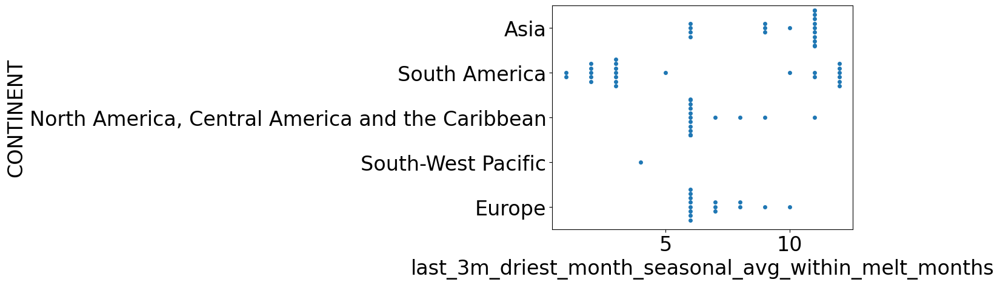

In [188]:
sns.swarmplot(data=basin_stats_driest, y='CONTINENT', x= 'last_3m_driest_month_seasonal_avg_within_melt_months')#, cut=0)

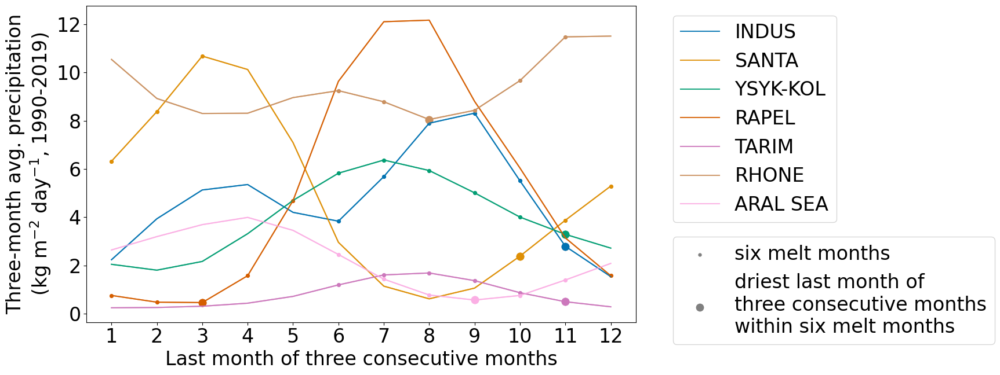

In [120]:
col_basins = sns.color_palette('colorblind')
plt.figure(figsize=(18,7))
for j,basin in enumerate(['INDUS', 'SANTA', 'YSYK-KOL (also ISSYK-KUL)', 'RAPEL',
              'TARIM HE (also TALIMU HE)', 'RHONE', 'ARAL SEA']):
    basin_id=pd_basin_num.loc[pd_basin_num.RIVER_BASI==basin]['MRBID'].values[0]
    basin_avg_pr_seasonal_sel = pd_pr_seasonality_basin.loc[pd_pr_seasonality_basin.basin==basin_id]
    if basin=='TARIM HE (also TALIMU HE)':
        basin = 'TARIM' # HE\n(also TALIMU HE)'
    elif basin =='YSYK-KOL (also ISSYK-KUL)':
        basin = 'YSYK-KOL'
    plt.plot(basin_avg_pr_seasonal_sel.month,
             basin_avg_pr_seasonal_sel.pr_3m_sum,
            label=basin, alpha = 0.9,ls='-', color=col_basins[j]) # TARIM HE
    #plt.title(basin)
    plt.scatter(pd_months_w_melt_above_eq_median.loc[pd_months_w_melt_above_eq_median.basin==str(basin_id)].month,
             pd_months_w_melt_above_eq_median.loc[pd_months_w_melt_above_eq_median.basin==str(basin_id)].pr_3m_sum,
             #label=basin, 
                marker='.', s=50, color=col_basins[j], label='six melt months') # TARIM HE
    m_sel = basin_stats_driest.loc[basin_stats_driest.MRBID==basin_id,'last_3m_driest_month_seasonal_avg_within_melt_months'].values.squeeze()
    plt.scatter(m_sel,basin_avg_pr_seasonal_sel.loc[basin_avg_pr_seasonal_sel.month==m_sel,'pr_3m_sum'],
               marker='o', s=80,color=col_basins[j], label='driest last month of\nthree consecutive months\nwithin six melt months')
    plt.xlabel('Last month of three consecutive months')
    plt.ylabel('Three-month avg. precipitation\n'+r'(kg m$^{-2}$ day$^{-1}$, 1990-2019)')
    pd_months_w_melt_above_eq_median
    plt.xticks(np.arange(1,12.1,1))
ax = plt.gca()
handles, labels = ax.get_legend_handles_labels()
handles_w = handles.copy()
leg = plt.legend(handles_w[::3], labels[::3], ncol=1, loc = 'upper left', bbox_to_anchor=(1.05,1))
for h in handles_w[1:3]:
    h.set_color('grey')
plt.legend(handles_w[1:3], labels[1:3],loc = 'upper left', bbox_to_anchor=(1.05,0.3))

### strange grey dots in legend
for j,basin in enumerate(['INDUS', 'SANTA', 'YSYK-KOL (also ISSYK-KUL)', 'RAPEL',
              'TARIM HE (also TALIMU HE)', 'RHONE', 'ARAL SEA']):
    basin_id=pd_basin_num.loc[pd_basin_num.RIVER_BASI==basin]['MRBID'].values[0]
    basin_avg_pr_seasonal_sel = pd_pr_seasonality_basin.loc[pd_pr_seasonality_basin.basin==basin_id]

    plt.plot(basin_avg_pr_seasonal_sel.month,
             basin_avg_pr_seasonal_sel.pr_3m_sum,
            label=basin, alpha = 0.7,ls='-', color=col_basins[j]) # TARIM HE
    #plt.title(basin)
    plt.scatter(pd_months_w_melt_above_eq_median.loc[pd_months_w_melt_above_eq_median.basin==str(basin_id)].month,
             pd_months_w_melt_above_eq_median.loc[pd_months_w_melt_above_eq_median.basin==str(basin_id)].pr_3m_sum,
             #label=basin, 
                marker='.', s=70, color=col_basins[j], label='six melt months') # TARIM HE
    m_sel = basin_stats_driest.loc[basin_stats_driest.MRBID==basin_id,'last_3m_driest_month_seasonal_avg_within_melt_months'].values.squeeze()
    plt.scatter(m_sel,basin_avg_pr_seasonal_sel.loc[basin_avg_pr_seasonal_sel.month==m_sel,'pr_3m_sum'],
               marker='o', s=80,color=col_basins[j], label='driest last month of\nthree consecutive months\nwithin six melt months')
    plt.xlabel('Last month of three consecutive months')
    plt.ylabel('Three-month avg. precipitation\n'+r'(kg m$^{-2}$ day$^{-1}$, 1990-2019)')
    pd_months_w_melt_above_eq_median
    plt.xticks(np.arange(1,12.1,1))

ax.add_artist(leg)
plt.tight_layout()
plt.savefig('figures/figures_basins/3_precipitation_cycle_selected_basins.png')

- could also put here as xaxis NDJ, DJF, ... 

In [121]:
#### only for monthly runoff ...
opt = 'last_3m_driest_month_seasonal_avg_within_melt_months'
#opt = 'last_3m_driest_month_seasonal_avg' ## this was the old option looking at all months

#### only for monthly runoff ...
df_scenario_common_basins_dry_m_runoff_l = []
for basin_id in df_scenario_common_basin.basin:
    sel_month = func_sel_months(basin_id, opt=opt)
    sel_yr_month = df_scenario_common_basins_runoff_drymonths.year_month.where(df_scenario_common_basins_runoff_drymonths.month==sel_month).dropna(dim='year_month')
    _df_scenario_common_basins_dry_m_runoff = df_scenario_common_basins_runoff_drymonths.sel(basin=basin_id).sel(year_month=sel_yr_month)
    _df_scenario_common_basins_dry_m_runoff.coords['last_month_of_three_driest_months'] = str(sel_month)
    _df_scenario_common_basins_dry_m_runoff = _df_scenario_common_basins_dry_m_runoff.swap_dims({'year_month':'year'}).reset_coords()
    df_scenario_common_basins_dry_m_runoff_l.append(_df_scenario_common_basins_dry_m_runoff)
df_scenario_common_basins_dry_m_runoff = xr.concat(df_scenario_common_basins_dry_m_runoff_l, dim='basin')
df_scenario_common_basins_dry_m_runoff['runoff_monthly_51_yr_avg'] = df_scenario_common_basins_dry_m_runoff.runoff_monthly.isel(year=slice(0,-1)).rolling(min_periods=51, #50 
                                                                                                                                                          year=51, center=True).mean()
pd_runoff_dry3m_scenario_rel_basin = (100*df_scenario_common_basins_dry_m_runoff.runoff_monthly_51_yr_avg/df_scenario_common_basins_dry_m_runoff.sel(year=2025).runoff_monthly_51_yr_avg).to_dataframe('runoff_dry3m_rel_2000_2050_%').reset_index()
# in the other plots year was always time, so easier to have it here as well:
pd_runoff_dry3m_scenario_rel_basin['time'] = pd_runoff_dry3m_scenario_rel_basin['year']

pd_runoff_dry3m_scenario_rel_basin['stab_vs_oversh'] = 'oversh'
pd_runoff_dry3m_scenario_rel_basin.loc[pd_runoff_dry3m_scenario_rel_basin['scenario'].apply(lambda x: 'stab' in x).values, 'stab_vs_oversh'] = 'stab'


In [122]:
# Definition:
# “Trough water” occurs if the 51-year average annual runoff from the 
# “Overshoot 3.0°C -> 1.5°C” scenario is at least 5\% smaller than (i) in the “Stabilisation 1.5°C” scenario for 20 years 
# and  (ii) than in the baseline period 
# (initial steady state for the idealised experiments, 2000--2020 or 2000--2050 climate for the projections with the ESM).
### --> the second condition just means it has to be smaller than or equal to 95% 
runoff_var = 'runoff_dry3m_rel_2000_2050_%'
water_trough_stats_basins_3m_driest = pd.DataFrame(index = pd_runoff_dry3m_scenario_rel_basin.basin.unique(),
                                  columns= ['yrs_with_trough_water',  'cumulative_runoff_diff_trough', 
                                            'trough_water_min_year', 'trough_water_max_diff',
                                            'trough_water_pot_start_end'])
for basin in pd_runoff_dry3m_scenario_rel_basin.basin.unique():
    pd_runoff_scenario_rel_basin_sel = pd_runoff_dry3m_scenario_rel_basin.loc[pd_runoff_dry3m_scenario_rel_basin.basin==basin]
    # overshoot runoff smaller than 0.95 times stabilisation runoff (both use 501r avg. runoff)
    sel_oversh = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='oversh_T30OS15']
    sel_stab = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='stab_T15']
    _output = get_basin_trough_water_stats(sel_stab, sel_oversh, 
                                 runoff_var = runoff_var)
    water_trough_stats_basins_3m_driest.loc[basin] = _output

In [123]:
old_def = False
if old_def: 
    # Definition:
    # “Trough water” occurs if the 51-year average annual runoff from the 
    # “Overshoot 3.0°C -> 1.5°C” scenario is at least 5\% smaller than (i) in the “Stabilisation 1.5°C” scenario for 20 years 
    # and  (ii) than in the baseline period 
    # (initial steady state for the idealised experiments, 2000--2020 or 2000--2050 climate for the projections with the ESM).
    ### --> the second condition just means it has to be smaller than or equal to 95% 

    water_trough_stats_basins_3m_driest = pd.DataFrame(index = pd_runoff_dry3m_scenario_rel_basin.basin.unique(),
                                      columns= ['yrs_with_water_trough',  'cumulative_runoff_diff_trough', 
                                                'water_trough_min_year', 'water_trough_max_diff',
                                                'water_trough_start_end'])
    for basin in pd_runoff_dry3m_scenario_rel_basin.basin.unique():
        pd_runoff_scenario_rel_basin_sel = pd_runoff_dry3m_scenario_rel_basin.loc[pd_runoff_dry3m_scenario_rel_basin.basin==basin]
        # overshoot runoff smaller than 0.95 times stabilisation runoff (both use 501r avg. runoff)
        sel_oversh = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='oversh_T30OS15']
        sel_oversh.index = sel_oversh.time
        sel_stab = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='stab_T15']
        sel_stab.index = sel_stab.time
        condi_i = (sel_stab['runoff_dry3m_rel_2000_2050_%'] - sel_oversh['runoff_dry3m_rel_2000_2050_%']) >= 5 #difference has to be larger thatn 5% 
        condi_ii = sel_oversh['runoff_dry3m_rel_2000_2050_%'].dropna()<=95
        condi = condi_i & condi_ii
        # estimate years with water trough
        yrs_trough = sel_stab.where(condi).dropna(how='all').index
        river_basi = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values.squeeze()
        # is the trough continuous??? 
        if len(yrs_trough)==0:
            continue
        elif np.abs((yrs_trough[-1] - yrs_trough[0]) - len(yrs_trough)<=20): # if it is within 20 years just define the entire range as trough ...
            pass
        else:
            print(pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values, (yrs_trough[-1] - yrs_trough[0]) - len(yrs_trough))
            yrs_miss = list(set(np.arange(yrs_trough[0], yrs_trough[-1]))-set(yrs_trough))
            yrs_miss.sort()
            arr =  np.diff(yrs_trough.values).copy() #np.array([5, 1, 1, 1, ...])  # Your array
            if len(yrs_miss)<1:
                pass
            elif len(arr[arr!=1])==1:
                if (yrs_miss[-1] - yrs_trough[0] < 10):
                    yrs_trough = np.arange(yrs_miss[-1]+1, yrs_trough[-1])
                elif (yrs_trough[-1] - yrs_miss[-1] < 10):
                    yrs_trough = np.arange(yrs_trough[0], yrs_miss[-1]-1)
            else:
                # partly ChatGPT
                # Find the differences between consecutive elements
                # Find indices where the elements are not equal to 1
                non_one_indices = np.where(arr != 1)[0]
                all_indices = np.concatenate([[0],non_one_indices,[len(arr)]]) #np.insert(non_one_indices, 0) -1)
                # Calculate lengths of sequences of ones
                sequence_lengths = np.diff(all_indices) - 1
                ind_max = sequence_lengths.argmax()
                ind_max_sequence = all_indices[ind_max] + 1 # 

                # Exclude sequences with non-1 values and get the longest sequence of ones
                #ones_sequences = [arr[i+1:j] for i, j in zip(np.insert(non_one_indices, 0, -1), non_one_indices)]
                #longest_sequence_of_ones = max(ones_sequences, key=len, default=[])
                yrs_trough = yrs_trough[ind_max_sequence:ind_max_sequence+sequence_lengths.max()]

        # CONDITION: yrs_trough 
        if len(yrs_trough) <20:
            #print(basin, len(yrs_trough))
            yrs_trough = []
        # estimate runoff differences inside of water trough
        diff = (sel_stab.loc[yrs_trough]['runoff_dry3m_rel_2000_2050_%'] - sel_oversh.loc[yrs_trough]['runoff_dry3m_rel_2000_2050_%'])
        try:
            assert np.all(diff >0)
            water_trough_min_yr = int(diff.idxmax())
            water_trough_max_diff = diff.max()
            yrs_trough_start_end = f'{yrs_trough[0]}_{yrs_trough[-1]}'
        except:
            water_trough_min_yr = np.NaN
            water_trough_max_diff = np.NaN
            yrs_trough_start_end = np.NaN

        runoff_diff_trough = diff.sum()
        water_trough_stats_basins_3m_driest.loc[basin] = np.array([len(yrs_trough), runoff_diff_trough,
                                                 water_trough_min_yr, water_trough_max_diff, yrs_trough_start_end]) #,river_basi])
        if basin == '2914':
            pass
            #print(water_trough_stats_basins_3m_driest.loc[basin])
            #assert basin !='2914'
    len(water_trough_stats_basins_3m_driest.dropna())#.loc[water_trough_stats_basins.dropna().yrs_with_water_trough.astype(int)>50]

In [124]:
water_trough_stats_basins_3m_driest_c = water_trough_stats_basins_3m_driest.copy()


Text(0.5, 1.0, 'TARIM HE (also TALIMU HE) 2914 - last month of 3m driest period in melt season: 11')

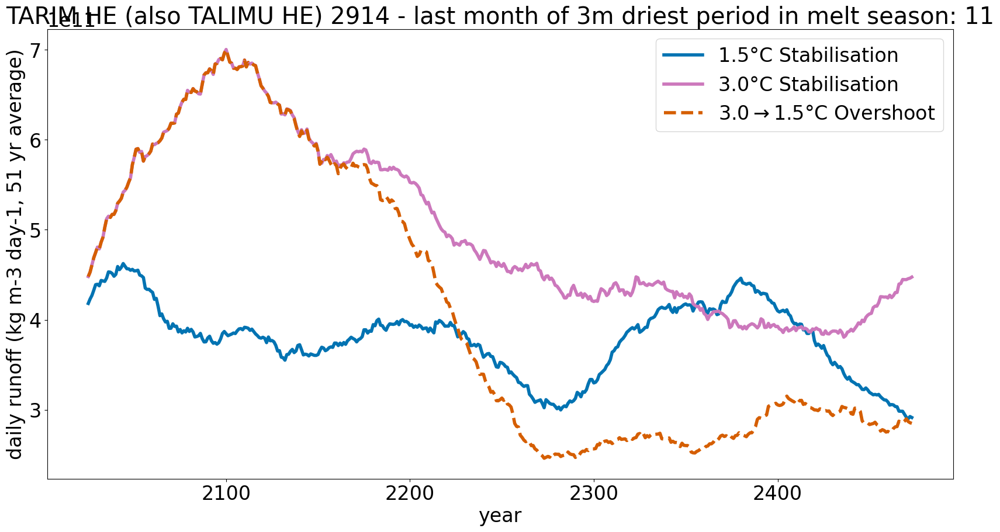

In [125]:
basins = pd_basins_arid_glac_num.MRBID.values

plt.figure(figsize=(20,10))
name = basin_stats_driest.loc[basin_stats_driest.MRBID==int(basins[4])]['RIVER_BASI'].values[0]
last_month_of3mdriest = int(basin_stats_driest.loc[basin_stats_driest.MRBID==int(basins[4])][opt].values[0])
for scenario in scenarios:
    _s = df_scenario_common_basins_dry_m_runoff.sel(basin=str(basins[4])).sel(scenario=scenario)
    sns.lineplot(data=_s.to_dataframe().reset_index(),
                x='year', y='runoff_monthly_51_yr_avg', lw=4,
                 ls = scenario_ls[scenario],
                color = color_scenario[scenario], label=label_scenario_david[scenario])
plt.ylabel('daily runoff (kg m-3 day-1, 51 yr average)')
plt.title(f'{name} {basins[4]} - last month of 3m driest period in melt season: {last_month_of3mdriest}')

In [126]:
sel_month_to_name_dict={}
months_n = 'NDJFMAMJJASOND'
ms = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14]
for j in np.arange(0,12,1):
    sel_month_to_name_dict[ms[j]+1] = months_n[ms[j]] + months_n[ms[j+1]] + months_n[ms[j+2]]


In [127]:
basin_stats_driest_c = basin_stats_driest.copy()
basin_stats_driest_c = basin_stats_driest_c.set_index('RIVER_BASI')

water_trough_stats_basins_3m_driest_c.index = water_trough_stats_basins_3m_driest_c.index.astype(int)
water_trough_stats_basins_3m_driest_c = water_trough_stats_basins_3m_driest_c.loc[basin_stats_driest_c.loc[pd_basins_arid_glac_num.index].MRBID]
water_trough_stats_basins_3m_driest_c['RIVER_BASI'] = pd_basins_arid_glac_num.index
water_trough_stats_basins_3m_driest_c = water_trough_stats_basins_3m_driest_c.set_index('RIVER_BASI')


pd_basins_arid_glac_num_all = pd.concat([pd_basins_arid_glac_num, water_trough_stats_basins_3m_driest_c,
                                         basin_stats_driest_c.loc[pd_basins_arid_glac_num.index,['last_3m_driest_month_seasonal_avg',
       'last_3m_driest_most_frequent_month',
       'perc_yrs_w_last_3m_driest_most_frequent_month',
       'last_3m_driest_month_seasonal_avg_within_melt_months']]], axis=1)
pd_basins_arid_glac_num_all.to_csv('seven_arid_basins_all_stats_06_2024.csv')
pd_runoff_dry3m_scenario_rel_basin.to_csv('seven_arid_basins_runoff_2000_2500_06_2024.csv')

**--> final updated fig. 4 plot is done here: http://localhost:7269/lab/tree/www_lschuster/provide/gfdl-esm2m_oversh_stab_uni_bern/analysis_notebooks/schuster_el_al_phd_paper_2_overshoot_glaciers/3_fig_4.ipynb**

**Some stats for the dry melt season runoff stuff**

In [128]:
water_trough_stats_basins_3m_driest_sel = water_trough_stats_basins_3m_driest.loc[basin_glac_ind].copy() #
water_trough_stats_basins_3m_driest_sel['trough_water_max_diff_no_NaNs'] = water_trough_stats_basins_3m_driest_sel['trough_water_max_diff'].copy()
water_trough_stats_basins_3m_driest_sel['yrs_with_trough_water_no_NaNs'] = water_trough_stats_basins_3m_driest_sel['yrs_with_trough_water'].copy()

water_trough_stats_basins_3m_driest_sel['cumulative_runoff_diff_trough_no_NaNs'] = water_trough_stats_basins_3m_driest_sel['cumulative_runoff_diff_trough'].astype(float)
water_trough_stats_basins_3m_driest_sel.loc[water_trough_stats_basins_3m_driest_sel.trough_water_max_diff_no_NaNs.isna(),'trough_water_max_diff_no_NaNs'] = 0
water_trough_stats_basins_3m_driest_sel.loc[water_trough_stats_basins_3m_driest_sel.yrs_with_trough_water_no_NaNs.isna(),'yrs_with_trough_water_no_NaNs'] = 0

water_trough_stats_basins_3m_driest_sel.loc[water_trough_stats_basins_3m_driest_sel.cumulative_runoff_diff_trough_no_NaNs.isna(),'cumulative_runoff_diff_trough_no_NaNs'] = 0


In [129]:
print(len(water_trough_stats_basins_sel.where(water_trough_stats_basins_sel['trough_water_max_diff'].astype(float)>0).dropna(how='all')))

32


In [130]:
condi_water_trough_dry_melt_season = water_trough_stats_basins_3m_driest_sel['trough_water_max_diff'].astype(float)>0
condi_water_trough_dry_melt_season
### basins 0.1% glaciated, that get an at least 10% larger glacier volume and create a trough water after the year 2170: 
print(len(water_trough_stats_basins_3m_driest_sel.where(condi_water_trough_dry_melt_season).dropna(how='all')))
print(len(water_trough_stats_basins_3m_driest_sel.where(condi_water_trough_dry_melt_season& condi_vol_diff).dropna(how='all')))

### basins 0.1% glaciated, that get an at least 10% larger glacier volume after the global overshoot (i.e., after the year 2150) and create a trough water after the year 2150:
print(len(water_trough_stats_basins_3m_driest_sel.where(condi_water_trough_dry_melt_season& condi_vol_diff& condi_after_2150).dropna(how='all')))

32
32
26


In [131]:
# check if water trough is always after 2150 
assert float(water_trough_stats_basins_3m_driest_sel.where(condi_water_trough_dry_melt_season).dropna(how='all')['trough_water_min_year'].min()) >= 2150 

**From here on it gets unsorted and potentially old**bit

In [132]:
# this is the same, so we can just copy it
water_trough_stats_basins_3m_driest_sel.loc[water_trough_stats_basins_sel.index,'max_volume_diff_perc_stab_T15_vs_oversh30'] = water_trough_stats_basins_sel.max_volume_diff_perc_stab_T15_vs_oversh30.astype(float)

<AxesSubplot:xlabel='max_volume_diff_perc_stab_T15_vs_oversh30', ylabel='trough_water_max_diff_no_NaNs'>

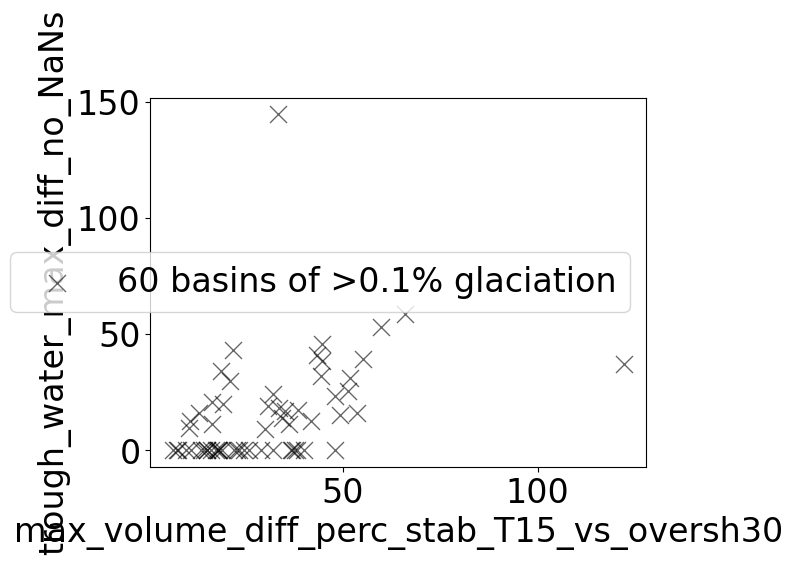

In [133]:
n = len(water_trough_stats_basins_3m_driest_sel.dropna(how='all'))
sns.scatterplot(data = water_trough_stats_basins_3m_driest_sel[['trough_water_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna().astype(float), #.where(condi_trough).dropna(),
                y='trough_water_max_diff_no_NaNs',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
                alpha = 0.6, marker='x', s= 150,
                label=f'{n} basins of >0.1% glaciation') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

**TODO** --> need to recompute the seasonal `mean_precip_change_perc_oversh_vs_stab_bef2350` values for each basin

In [219]:
# plot that we want to creaste ... at the moment just a copy from above ... 
plt.figure(figsize=(34,10))

condi_prcp_increase = water_trough_stats_basins_3m_driest_sel['mean_precip_change_perc_oversh_vs_stab_bef2350'] > 1  # 3% increase on average between 2050 and 2350
condi_prcp_decrease = water_trough_stats_basins_3m_driest_sel['mean_precip_change_perc_oversh_vs_stab_bef2350'] < -1
plt.subplot(131)
n=len(water_trough_stats_basins_sel[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(), #.where(condi_trough).dropna(),
                y='water_trough_max_diff_no_NaNs',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
                alpha = 0.6, marker='x', s= 150,
                label=f'{n} basins of >0.1% glaciation') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(), #.where(condi_trough).dropna(),
                y='water_trough_max_diff_no_NaNs',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
                alpha = 0.2, marker='s', s= 300,
                label=f'{n} basins of >0.1% glaciation with\n>10% regrowth after overshoot (after 2150)') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)


n=len(water_trough_stats_basins_sel.where(condi_prcp_increase)[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_increase)[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(),
                y='water_trough_max_diff_no_NaNs',s=60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='blue', label=f'{n} basins with >1% avg. precipitation\nincrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_prcp_decrease)[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_decrease)[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(),
                y='water_trough_max_diff_no_NaNs', s= 60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color='red', label=f'{n} basins  with >1% avg. precipitation\ndecrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation') 
leg = plt.legend(fontsize=18)
leg.remove()
plt.ylabel('Maximum relative runoff difference\n(Stabilisation 1.5°C - Overshoot 3.0°C->1.5°C)')


plt.subplot(132)
n=len(water_trough_stats_basins_sel[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel[['cumulative_runoff_diff_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(), #.where(condi_trough).dropna(),
                y='cumulative_runoff_diff_trough_no_NaNs',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
                alpha = 0.6, marker='x', s= 100,
                label=f'{n} basins of >0.1% glaciation') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[['water_trough_max_diff_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[['cumulative_runoff_diff_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(), #.where(condi_trough).dropna(),
                y='cumulative_runoff_diff_trough_no_NaNs',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
                alpha = 0.2, marker='s', s= 300,
                label=f'{n} basins of >0.1% glaciation with\n>10% regrowth after overshoot (after 2150)') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)
n=len(water_trough_stats_basins_sel.where(condi_prcp_increase)[['cumulative_runoff_diff_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_increase)[['cumulative_runoff_diff_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(),
                y='cumulative_runoff_diff_trough_no_NaNs',s=60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='blue', label=f'{n} basins with >1% avg. precipitation\nincrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_prcp_decrease)[['cumulative_runoff_diff_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_decrease)[['cumulative_runoff_diff_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(),
                y='cumulative_runoff_diff_trough_no_NaNs', s= 60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color='red', label=f'{n} basins  with >1% avg. precipitation\ndecrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation') 
leg = plt.legend(fontsize=18)
leg.remove()
plt.ylabel('Cumulative runoff difference\n(Stabilisation 1.5°C - Overshoot 3.0°C->1.5°C)')


plt.subplot(133)
n=len(water_trough_stats_basins_sel[['yrs_with_water_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel[['yrs_with_water_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(), #.where(condi_trough).dropna(),
                y='yrs_with_water_trough_no_NaNs',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
                alpha = 0.6, marker='x', s= 150,
                label=f'{n} basins of >0.1% glaciation') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[['yrs_with_water_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff&condi_after_2150)[['yrs_with_water_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(), #.where(condi_trough).dropna(),
                y='yrs_with_water_trough_no_NaNs',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', 
                alpha = 0.2, marker='s', s= 300,
                label=f'{n} basins of >0.1% glaciation with\n>10% regrowth after overshoot (after 2150)') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_prcp_increase&condi_vol_diff)[['yrs_with_water_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_increase&condi_vol_diff)[['yrs_with_water_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(),
                y='yrs_with_water_trough_no_NaNs',s=60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='blue', label=f'{n} basins with >1% avg. precipitation\nincrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_prcp_decrease&condi_vol_diff)[['yrs_with_water_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_prcp_decrease&condi_vol_diff)[['yrs_with_water_trough_no_NaNs','max_volume_diff_perc_stab_T15_vs_oversh30']].dropna(),
                y='yrs_with_water_trough_no_NaNs', s= 60,
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color='red', label=f'{n} basins  with >1% avg. precipitation\ndecrease in period 2050-2350 for\nOvershoot 3.0°C->1.5°C vs 1.5°C Stabilisation') 

plt.ylabel('Years with water trough (after year 2170)')
plt.legend(fontsize=18, bbox_to_anchor=(1,1), loc = 'upper left')
plt.tight_layout()

KeyError: 'mean_precip_change_perc_oversh_vs_stab_bef2350'

<Figure size 3400x1000 with 0 Axes>

**Not used: 21-year minimum runoff**

In [ ]:
# same for 20-yr minimum anual runoff ... 

var = 'precip_21yr_avg'
basins = pd_basins_arid_glac_num.MRBID.values


plt.rc('font', size=24)

plt.figure(figsize=(16,30)) #, sharey=True, sharex=True)
plt.subplot(5,2,1)
ax = plt.gca()

ax.set_ylabel('21-yr min annual runoff\n(% relative to 2000-2019)', weight='bold')

basin = basins[0]
basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()#[0]
continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
basin_name = f'{continent_n}: {basin_n}'
#ax.set_title(basin_name)
sns.lineplot(data=pd_runoff_scenario_rel_basin_21_yr_min.loc[pd_runoff_scenario_rel_basin_21_yr_min.basin == str(basin)],
             hue='scenario', x='time', y= 'runoff_min_rel_2000_2020_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=[0,25,50,75,100,125, 150, 175],
                   labels=[0,25,50,75,100,125, 150, 175], weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_21yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
if var != 'temp_21yr_avg':
    ticks = np.arange(70,131,10)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6) 
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

ax2.set_ylim([68,132]);

plt.setp(ax2.get_yticklabels(), visible=False, fontsize=10)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
ax.set_ylim([20,180]);


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                fontsize=20, title_fontsize=22,loc = 'lower left', bbox_to_anchor=(-0.02,1.11), ncol=4)
for l in leg.get_lines():
    l.set_linewidth(4)
    

leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                              r'precipitation changes (right)'],
                 loc='lower left', fontsize=20, bbox_to_anchor=(-0.02,0.98), ncol=2)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('black')
ax.add_artist(leg)

plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)


for j, basin in enumerate(basins[1:]):
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()[0]
    if basin_n=='TARIM HE (also TALIMU HE)':
        basin_n = 'TARIM HE\n(also TALIMU HE)'
    continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
    basin_name = f'{continent_n}: {basin_n}'
    plt.subplot(5,2,j+2)
    x_j = np.arange(1,20,2)
    x2_j = np.arange(0,20,2)

    ax = plt.gca()
    sns.lineplot(data=pd_runoff_scenario_rel_basin_21_yr_min.loc[pd_runoff_scenario_rel_basin_21_yr_min.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_min_rel_2000_2020_%', 
                 palette=color_scenario_poster.values(),
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

    #ax.set_title(f'{Preg}: {basin}')

    plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

    if j in x_j:
        #plt.ylabel(f'51-yr avg. annual runoff\n(% relative to 2000-2050)', weight='bold')
        plt.ylabel('21-yr min annual runoff\n(% relative to 2000-2019)', weight='bold')
        ax.set_yticks(ticks=[0,25,50,75,100,125, 150, 175],
                   labels=[0,25,50,75,100,125, 150, 175], weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=[0,25,50,75,100,125, 150, 175],
                   labels=['','','','','','','',''], weight='bold')
        #ax.set_yticklabels([])
        #ax.set_yticks(ticks=[0,25,50,75,100,125, 150, 175],
        #           labels=[0,25,50,75,100,125, 150, 175], weight='bold')

    #ax.set_ylim([70,1439.9]);


    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_21yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    if var != 'temp_21yr_avg':
        ticks = np.arange(70,131,10)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = 'near-glacier precipitation \n(% relative to 2000-2019)' #, glacier-area weighted)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

    if j in x2_j:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=10)

    #ax2.set_ylim([-0.9,5.9]);
    ax2.set_ylim([68,132]);

    if j >6:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([20,180]);
#plt.tight_layout()
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_21_yr_min_runoff_{bc}_vs_prcp_poster_iugg.png')


## Potentially old

NameError: name 'basin_stats_driest' is not defined

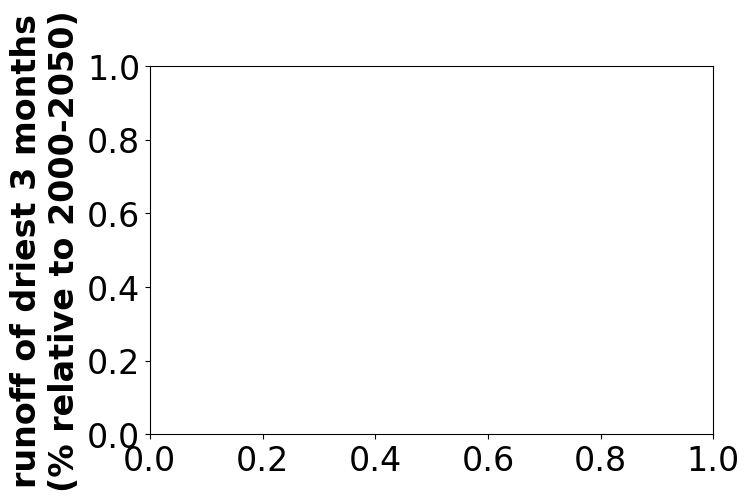

In [123]:
add_more = True
var = 'precip_3mdriest_avg_per_day_51yr_avg' #
basins = pd_basins_arid_glac_num.MRBID.values

plt.rc('font', size=24)

plt.figure(figsize=(16,22)) #, sharey=True, sharex=True)
plt.subplot(4,2,1)
ax = plt.gca()

ax.set_ylabel('runoff of driest 3 months\n(% relative to 2000-2050)', weight='bold')

basin = basins[0]
basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()#[0]
n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
glac_area = int(pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'RGI_AREA'].values.round(0))

continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
#basin_name = f'{continent_n}: {basin_n}'
basin_name = f'{basin_n}'
sel_month = int(basin_stats_driest.loc[basin_stats_driest.MRBID==int(basin)]['last_3m_driest_month_seasonal_avg'].values)
basin_name = basin_name + f'\ndriest melt\nmonths: {sel_month_to_name_dict[sel_month]}'
#ax.set_title(basin_name)
sns.lineplot(data=pd_runoff_dry3m_scenario_rel_basin.loc[pd_runoff_dry3m_scenario_rel_basin.basin == str(basin)],
             hue='scenario', x='time', y= 'runoff_dry3m_rel_2000_2050_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=np.arange(0,250,25),
              labels=np.arange(0,250,25), weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax.set_xlabel('')
ax.set_xlim([2000,2500])

ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

#ax.set_ylim([57,125]);
#ax.set_ylim([45,150]);
ax.set_ylim([0,190]);

if add_more:
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:
        pd_clim_scenario = pd_clim_basin_new.loc[pd_clim_basin_new.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        #precip_ref_g = pd_clim_scenario_g.loc[2000:2019]['precip_3mdriest_avg_per_day'].mean()
        #var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        precip_ref_g = pd_clim_scenario_g[var].dropna().iloc[0]

        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=0.8, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    if var != 'temp_20yr_avg':
        #ticks = np.arange(80,131,20)
        ticks = np.arange(60,151,20)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6) 
    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)

    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)


    ax2.set_ylim([51,151]);
    handles_2, labels_2 = ax2.get_legend_handles_labels()


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
if add_more:
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                    fontsize=20, title_fontsize=22,loc = 'lower left', bbox_to_anchor=(-0.02,1.11), ncol=3)
    for l in leg.get_lines():
        l.set_linewidth(4)


    leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left, 51-yr avg.)',
                                                  f'precipitation changes (right, 51-yr avg.)'],
                     loc='lower left', fontsize=22, bbox_to_anchor=(-0.15,0.98), ncol=2)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('black')
    # let's not show again the legend ...
    #ax.add_artist(leg)

plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

plt.text(0.995,0.005, f'{n_glaciers} glaciers\n{glac_area} km²',
     transform=ax.transAxes,ha='right',va='bottom',
     color='grey', fontsize=16, zorder=-1)
if add_more:
    y0,y1 = water_trough_stats_basins_3m_driest['water_trough_start_end'].loc[str(basin)].split('_')
    pd_basin_sel = pd_runoff_dry3m_scenario_rel_basin.loc[pd_runoff_dry3m_scenario_rel_basin.basin == str(basin)].dropna()
    pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
    pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
    pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
    pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time

    nyears,water_trough_max_diff  = water_trough_stats_basins_3m_driest[['yrs_with_water_trough',
                                                        'water_trough_max_diff']].loc[str(basin)]

    water_trough_max_diff = np.round(float(water_trough_max_diff),0)
    add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'
    ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time, 
                     pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'], 
                     pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'],
                     alpha = 0.1, color='cyan', zorder=-1, label='trough water\n'+add_label)
    handles_x, labels_x = ax.get_legend_handles_labels()
    leg3 = ax.legend([handles_x[-1]], [labels_x[-1]], loc='lower left',fontsize=16)
    ax.add_artist(leg3)
    ax.add_artist(leg2)



axs = []
for j, basin in enumerate(basins[1:]):
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()[0]
    n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
    glac_area = int(pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'RGI_AREA'].values.round(0))
    if basin_n=='TARIM HE (also TALIMU HE)':
        basin_n = 'TARIM HE\n(also TALIMU HE)'
    continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
    #basin_name = f'{continent_n}: {basin_n}'
    basin_name = f'{basin_n}'
    sel_month = int(basin_stats_driest.loc[basin_stats_driest.MRBID==int(basin)][opt].values)
    basin_name = basin_name + f'\ndriest melt\nmonths: {sel_month_to_name_dict[sel_month]}'
    
    plt.subplot(4,2,j+2)
    x_j = np.arange(1,20,2)
    x2_j = np.arange(0,20,2)

    ax = plt.gca()
    basin_runoff_sel = pd_runoff_dry3m_scenario_rel_basin.loc[pd_runoff_dry3m_scenario_rel_basin.basin == str(basin)]
    sns.lineplot(data=basin_runoff_sel,
             hue='scenario', x='time', y= 'runoff_dry3m_rel_2000_2050_%',  
                 palette=list(color_scenario_poster.values()),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)
    #ax.set_title(f'{Preg}: {basin}')

    plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)
    
    plt.text(0.995,0.005, f'{n_glaciers} glaciers\n{glac_area} km²',
     transform=ax.transAxes,ha='right',va='bottom',
     color='grey', fontsize=16, zorder=-1)
    ax.set_ylabel('')
    if j in x_j:
        #plt.ylabel(f'annual runoff\n(% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=np.arange(0,250,25),
                   labels=np.arange(0,250,25), weight='bold')
    else:
        ax.set_yticks(ticks=np.arange(0,250,25),
                   labels=np.arange(0,250,25), alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);

    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    
    if add_more:
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_basin_new.loc[pd_clim_basin_new.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            #precip_ref_g = pd_clim_scenario_g.loc[2000:2019]['precip_3mdriest_avg_per_day'].mean()
            precip_ref_g = pd_clim_scenario_g[var].dropna().iloc[0]
            #var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g
            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 1, 
                     ls = '--',
                     lw=0.8, color = color_scenario_poster[scenario], label=label_scenario[scenario])
        if var != 'temp_20yr_avg':
            ticks = np.arange(60,151,20)
            ax2.set_yticks(ticks=ticks,
                            labels=ticks, alpha=0.6)  
            ylabel = 'near-glacier precipitation \n(% relative to 2003±25)' #, glacier-area weighted)'

        else:
            ax2.set_yticks(ticks=[0,1,2,3,4,5],
                       labels=[0,1,2,3,4,5], alpha=0.6)
            ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

        if j in x2_j:
            pass
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
        if j == 0:
            ax2.set_ylabel(ylabel,
                          alpha = 0.6)
        #ax2.set_ylim([-0.9,5.9]);

    if j >4:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax.set_ylim([0,190]);

    if add_more:
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
        ax2.set_ylim([51,151]);
    if add_more:
        try:
            y0,y1 = water_trough_stats_basins_3m_driest['water_trough_start_end'].loc[str(basin)].split('_')
            pd_basin_sel = pd_runoff_dry3m_scenario_rel_basin.loc[pd_runoff_dry3m_scenario_rel_basin.basin == str(basin)].dropna()
            pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
            pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
            pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
            pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time

            nyears,water_trough_max_diff  = water_trough_stats_basins_3m_driest[['yrs_with_water_trough',
                                                        'water_trough_max_diff']].loc[str(basin)]
            water_trough_max_diff = np.round(float(water_trough_max_diff),0)
            add_label = f'for {int(nyears)} years,\n' + r'$\Delta_{max}$=-'+f'{int(water_trough_max_diff)}%'
            ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time, 
                             pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'], 
                             pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_dry3m_rel_2000_2050_%'],
                             alpha = 0.1, color='cyan', zorder=-1, label='trough water\n'+add_label)
            if (basin_n == 'RAPEL') or (basin_n == 'SANTA'):
                leg_t=ax.legend(loc='upper left', fontsize=16)        
            else:
                leg_t = ax.legend(loc='lower left', fontsize=16, framealpha = 0.5)
        except:
            print(f'no trough water: {basin}')
    axs.append(ax)
#plt.tight_layout()

from matplotlib.lines import Line2D
lines = []
for k in scenario_ls.keys():
    line = Line2D([0], [0], ls=scenario_ls[k], label=label_scenario_david[k], color=color_scenario_poster[k], lw=4)
    lines.append(line)
axs[-2].set_xlabel('Year')

for k in scenario_ls.keys():
    line = Line2D([0], [0], ls=scenario_ls[k], label=label_scenario_david[k], color=color_scenario_poster[k], lw=4)
    lines.append(line)
ax.legend(handles=lines, loc = 'lower left', bbox_to_anchor=(1.3,0.02), title = 'Scenarios')
ax.add_artist(leg_t)
plt.savefig(f'figures/figures_basins/old_3_most_arid_glaciated_basin_51yr_dry3m_avg_runoff_{bc}_vs_prcp_precip_51yr_avg.png')
plt.savefig(f'figures/figures_basins/old_3_most_arid_glaciated_basin_51yr_dry3m_avg_runoff_{bc}_vs_prcp_precip_51yr_avg.pdf')


In [2]:
bc = 'bc_1980_2019' #'bc_1980_2019'
#df_scenario = xr.open_dataset('filled_sum_all_provide_reg_oversh_stab_2000_2500.nc').sel(bias_correction=bc)
#df_scenario = xr.open_dataset(f'common_running_sum_all_provide_reg_oversh_stab_2000_2500.nc').sel(bias_correction=bc)
df_scenario = xr.open_dataset(f'common_running_sum_all_provide_reg_oversh_stab_2000_2500_bc_1980_2019.nc')

df_scenario['runoff_50_yr_avg'] = df_scenario.runoff.isel(time=slice(0,-1)).rolling(min_periods=50, time=50, center=True).mean()
df_scenario_glob = df_scenario.sum(dim='provide_region', min_count=13)
pd_runoff_scenario_rel = (100*df_scenario/df_scenario.sel(time=2025)).runoff_50_yr_avg.to_dataframe('runoff_rel_2000_2050_%').reset_index()
pd_runoff_scenario_rel_glob = (100*df_scenario_glob/df_scenario_glob.sel(time=2025)).runoff_50_yr_avg.to_dataframe('runoff_rel_2000_2050_%').reset_index()

pd_vol_scenario_rel = (100*df_scenario/df_scenario.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()
pd_vol_scenario_glob = (100*df_scenario_glob/df_scenario_glob.sel(time=2020)).volume.to_dataframe('volume_rel_2020_%').reset_index()

pd_clim_all = pd.read_csv('../annual_glob_rgi_reg_basin_temp_precip_timeseries_oversh_stab.csv', index_col = 'Unnamed: 0')
pd_clim_all['precip_50yr_avg'] = pd_clim_all['precip'].rolling(50,center=True, min_periods=50).mean()
scenarios = list(color_scenario_poster.keys())

In [11]:
#scenarios = ['stab_T15', 'oversh_T20OS15',
#                     'oversh_T25OS15',
#                     'oversh_T30OS15']

In [22]:
pd_clim_all['precip_50yr_avg'] = pd_clim_all['precip_50yr_avg'].where((pd_clim_all.year>=2025) & (pd_clim_all.year<=2474))

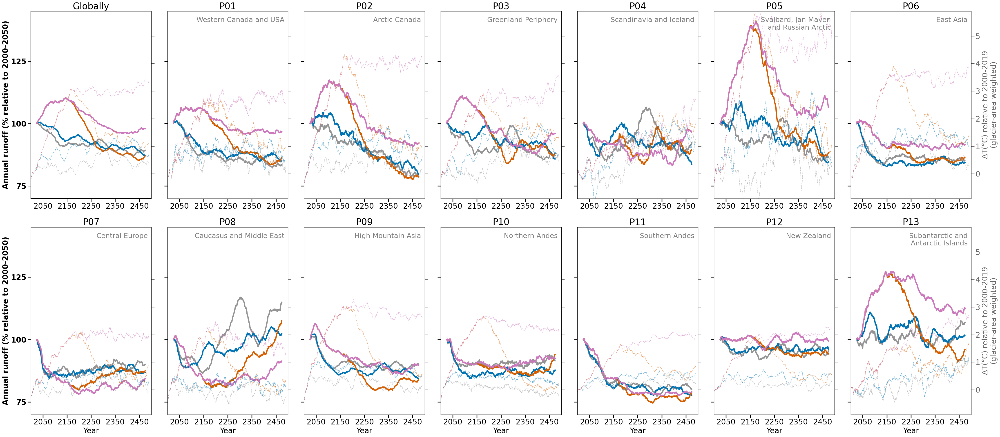

In [4]:
var = 'temp_20yr_avg'

plt.rc('font', size=24)

plt.figure(figsize=(45,20)) #, sharey=True, sharex=True)
plt.subplot(2,7,1)
ax = plt.gca()
ax.set_title('Globally')

ax.set_ylabel('Annual runoff (% relative to 2000-2050)', weight='bold')

sns.lineplot(data=pd_runoff_scenario_rel_glob,
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 0.6, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)
ax2.set_ylim([-0.9,5.9]);

plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
ax.set_ylim([70,145]);

for j, pi in enumerate(np.arange(1,14,1)):
    if pi<10:
        Preg = f'P0{pi}'
    else:
        Preg = f'P{pi}'
    plt.subplot(2,7,j+2)
    ax = plt.gca()
    pd_runoff_scenario_rel_reg = pd_runoff_scenario_rel.loc[pd_runoff_scenario_rel.provide_region==Preg]
    sns.lineplot(data=pd_runoff_scenario_rel_reg.loc[pd_runoff_scenario_rel_reg.bias_correction==bc],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=list(color_scenario_poster.values()),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)
    
    ax.set_title(f'{Preg}')
    plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22)

    if j in [6]:
        plt.ylabel(f'Annual runoff (% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);
    

    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'provide_reg_{Preg}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 0.6, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)
    if j in [5,12]:
        ax2.set_ylabel(r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)',
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

    ax2.set_ylim([-0.9,5.9]);
    if j >5:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([70,145]);
plt.tight_layout()
plt.savefig(f'provide_reg_runoff_{bc}.pdf')

**same but instead for 20-yr average precipitation**:

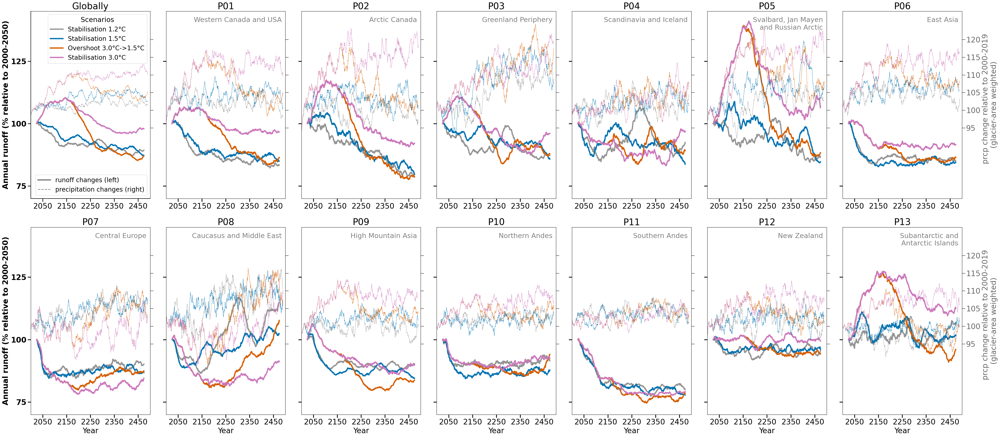

In [6]:
var = 'precip_20yr_avg'

plt.rc('font', size=24)

plt.figure(figsize=(45,20)) #, sharey=True, sharex=True)
plt.subplot(2,7,1)
ax = plt.gca()
ax.set_title('Globally')

ax.set_ylabel('Annual runoff (% relative to 2000-2050)', weight='bold')

sns.lineplot(data=pd_runoff_scenario_rel_glob,
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(95,125,5)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6)  
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

ax2.set_ylim([75,128]);
plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
ax.set_ylim([70,145]);


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios', fontsize=20, title_fontsize=22)
for l in leg.get_lines():
    l.set_linewidth(4)
leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                              r'precipitation changes (right)'],
                 loc='lower right', ncol=1, fontsize=20)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('grey')
ax.add_artist(leg)


for j, pi in enumerate(np.arange(1,14,1)):
    if pi<10:
        Preg = f'P0{pi}'
    else:
        Preg = f'P{pi}'
    plt.subplot(2,7,j+2)
    ax = plt.gca()
    pd_runoff_scenario_rel_reg = pd_runoff_scenario_rel.loc[pd_runoff_scenario_rel.provide_region==Preg]
    sns.lineplot(data=pd_runoff_scenario_rel_reg.loc[pd_runoff_scenario_rel_reg.bias_correction==bc],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=list(color_scenario_poster.values()),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)
    
    ax.set_title(f'{Preg}')
    plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22)

    if j in [6]:
        plt.ylabel(f'Annual runoff (% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);
    

    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'provide_reg_{Preg}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    if var != 'temp_20yr_avg':
        ticks = np.arange(95,125,5)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = '     prcp change relative to 2000-2019\n(glacier-area weighted)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

    if j in [5,12]:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

    #ax2.set_ylim([-0.9,5.9]);
    ax2.set_ylim([75,128]);

    if j >5:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([70,145]);
plt.tight_layout()
plt.savefig(f'3_provide_reg_runoff_{bc}_vs_prcp_poster_iugg.pdf')
plt.savefig(f'3_provide_reg_runoff_{bc}_vs_prcp_poster_iugg.png')

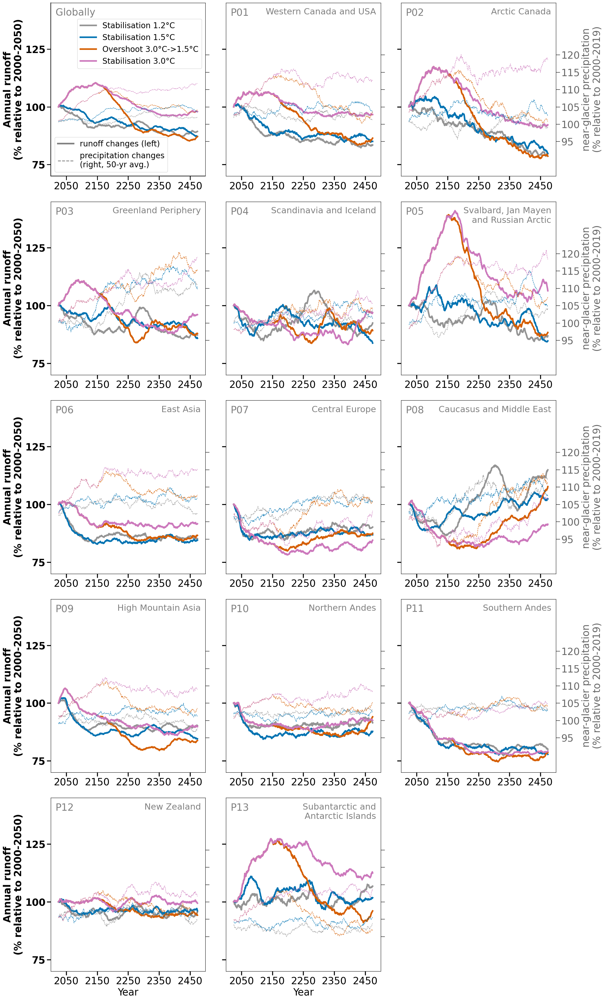

In [24]:
var = 'precip_50yr_avg'

plt.rc('font', size=25)

plt.figure(figsize=(22,36)) #, sharey=True, sharex=True)
plt.subplot(5,3,1)
ax = plt.gca()
plt.text(0.03,0.97, 'Globally',
         transform=ax.transAxes,ha='left',va='top',
         color='grey', fontsize=25)
ax.set_ylabel('Annual runoff\n(% relative to 2000-2050)', weight='bold')

sns.lineplot(data=pd_runoff_scenario_rel_glob,
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(95,125,5)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6)  
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

ax2.set_ylim([85,135]);


plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
ax.set_ylim([70,145]);


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], fontsize=20, title_fontsize=22, bbox_to_anchor=(1,0.93), loc='upper right')
for l in leg.get_lines():
    l.set_linewidth(4)
leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                              f'precipitation changes\n(right, 50-yr avg.)'],
                 loc='lower left', ncol=1, fontsize=20)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('grey')
ax.add_artist(leg)


for j, pi in enumerate(np.arange(1,14,1)):
    if pi<10:
        Preg = f'P0{pi}'
    else:
        Preg = f'P{pi}'
    plt.subplot(5,3,j+2)
    x_j = np.arange(2,15,3)
    x2_j = np.arange(1,15,3)
    year_xlabel_condi = j>10
    
    ax = plt.gca()
    pd_runoff_scenario_rel_reg = pd_runoff_scenario_rel.loc[pd_runoff_scenario_rel.provide_region==Preg]
    sns.lineplot(data=pd_runoff_scenario_rel_reg.loc[pd_runoff_scenario_rel_reg.bias_correction==bc],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=list(color_scenario_poster.values()),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)
        
    plt.text(0.03,0.97, Preg,
                 transform=ax.transAxes,ha='left',va='top',
                 color='grey', fontsize=25)
    plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22)

    if j in x_j:
        plt.ylabel(f'Annual runoff\n(% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);
    

    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'provide_reg_{Preg}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    if var != 'temp_20yr_avg':
        ticks = np.arange(95,125,5)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = 'near-glacier precipitation\n(% relative to 2000-2019)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

    if j in x2_j:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

    #ax2.set_ylim([-0.9,5.9]);
    ax2.set_ylim([85,135]);

    if j >10:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([70,145]);
plt.tight_layout()
plt.savefig(f'3_provide_reg_runoff_{bc}_vs_prcp_poster_iugg_portrait_3col_precip50yr_avg.pdf')
plt.savefig(f'3_provide_reg_runoff_{bc}_vs_prcp_poster_iugg_portrait_3col_precip50yr_avg.png')

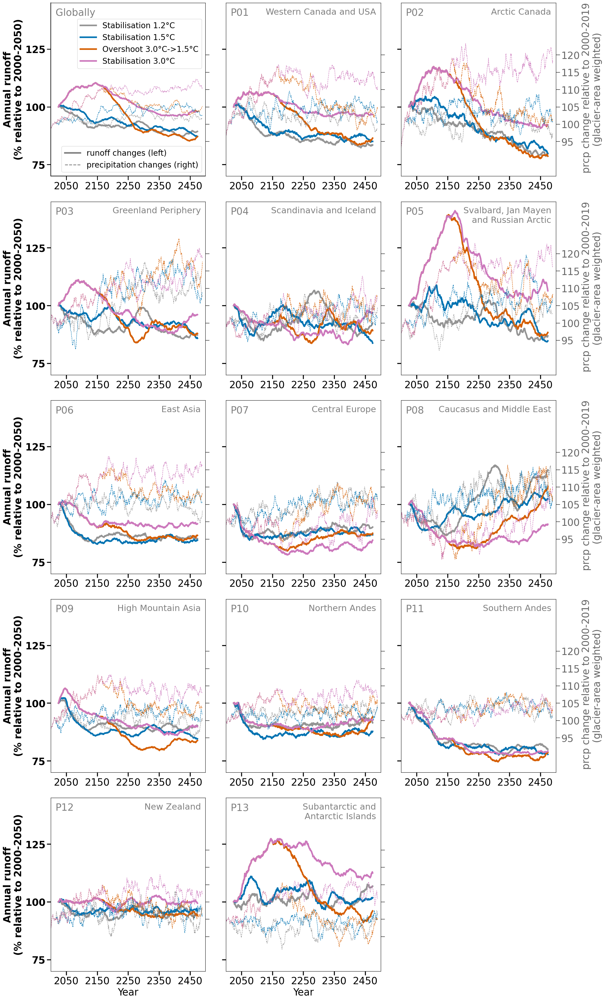

In [7]:
var = 'precip_20yr_avg'

plt.rc('font', size=25)

plt.figure(figsize=(22,36)) #, sharey=True, sharex=True)
plt.subplot(5,3,1)
ax = plt.gca()
plt.text(0.03,0.97, 'Globally',
         transform=ax.transAxes,ha='left',va='top',
         color='grey', fontsize=25)
ax.set_ylabel('Annual runoff\n(% relative to 2000-2050)', weight='bold')

sns.lineplot(data=pd_runoff_scenario_rel_glob,
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == 'global_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(95,125,5)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6)  
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

ax2.set_ylim([85,135]);


plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
ax.set_ylim([70,145]);


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], fontsize=20, title_fontsize=22, bbox_to_anchor=(1,0.93), loc='upper right')
for l in leg.get_lines():
    l.set_linewidth(4)
leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                              r'precipitation changes (right)'],
                 loc='lower right', ncol=1, fontsize=20)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('grey')
ax.add_artist(leg)


for j, pi in enumerate(np.arange(1,14,1)):
    if pi<10:
        Preg = f'P0{pi}'
    else:
        Preg = f'P{pi}'
    plt.subplot(5,3,j+2)
    x_j = np.arange(2,15,3)
    x2_j = np.arange(1,15,3)
    year_xlabel_condi = j>10
    
    ax = plt.gca()
    pd_runoff_scenario_rel_reg = pd_runoff_scenario_rel.loc[pd_runoff_scenario_rel.provide_region==Preg]
    sns.lineplot(data=pd_runoff_scenario_rel_reg.loc[pd_runoff_scenario_rel_reg.bias_correction==bc],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=list(color_scenario_poster.values()),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)
        
    plt.text(0.03,0.97, Preg,
                 transform=ax.transAxes,ha='left',va='top',
                 color='grey', fontsize=25)
    plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22)

    if j in x_j:
        plt.ylabel(f'Annual runoff\n(% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=[0,25,50,75,100,125],
                   labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);
    

    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'provide_reg_{Preg}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    if var != 'temp_20yr_avg':
        ticks = np.arange(95,125,5)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = ' prcp change relative to 2000-2019\n(glacier-area weighted)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

    if j in x2_j:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

    #ax2.set_ylim([-0.9,5.9]);
    ax2.set_ylim([85,135]);

    if j >10:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([70,145]);
plt.tight_layout()
plt.savefig(f'3_provide_reg_runoff_{bc}_vs_prcp_poster_iugg_portrait_3col.pdf')
plt.savefig(f'3_provide_reg_runoff_{bc}_vs_prcp_poster_iugg_portrait_3col.png')

In [5]:
water_trough_stats = pd.DataFrame(index = pd_runoff_scenario_rel.provide_region.unique(),
                                  columns= ['yrs_with_water_trough',  'cumulative_runoff_diff_trough', 
                                            'water_trough_min_year', 'water_trough_max_diff', 'water_trough_start_end'])
for Preg in pd_runoff_scenario_rel.provide_region.unique():

    pd_runoff_scenario_rel_reg = pd_runoff_scenario_rel.loc[pd_runoff_scenario_rel.provide_region==Preg]
    # overshoot runoff smaller than 0.9 times stabilisation runoff (both use 50yr avg. runoff)
    sel_oversh = pd_runoff_scenario_rel_reg.loc[pd_runoff_scenario_rel_reg.scenario=='oversh_T30OS15']
    sel_oversh.index = sel_oversh.time
    sel_stab = pd_runoff_scenario_rel_reg.loc[pd_runoff_scenario_rel_reg.scenario=='stab_T15']
    sel_stab.index = sel_stab.time
    condi = sel_stab['runoff_rel_2000_2050_%'] - sel_oversh['runoff_rel_2000_2050_%'] > 5 #difference has to be larger thatn 5% 

    # estimate years with water trough
    yrs_trough = sel_stab.where(condi).dropna(how='all').index
    if len(yrs_trough)==0:
        continue
    elif (yrs_trough[-1] - yrs_trough[0]) == len(yrs_trough):
        pass
    else:
        yrs_miss = list(set(np.arange(yrs_trough[0], yrs_trough[-1]))-set(yrs_trough))
        yrs_miss.sort()
        if len(yrs_miss)<1:
            pass
        elif (yrs_miss[-1] - yrs_trough[0] < 10):
            yrs_trough = np.arange(yrs_miss[-1]+1, yrs_trough[-1])
        elif (yrs_trough[-1] - yrs_miss[-1] < 10):
            yrs_trough = np.arange(yrs_trough[0], yrs_miss[-1]-1)

    # estimate runoff differences inside of water trough
    diff = (sel_stab.loc[yrs_trough]['runoff_rel_2000_2050_%'] - sel_oversh.loc[yrs_trough]['runoff_rel_2000_2050_%'])
    try:
        assert np.all(diff >0)
        water_trough_min_yr = int(diff.idxmax())
        water_trough_max_diff = diff.max()
        yrs_trough_start_end = f'{yrs_trough[0]}_{yrs_trough[-1]}'
    except:
        water_trough_min_yr = np.NaN
        water_trough_max_diff = np.NaN
        yrs_trough_start_end = np.NaN

    runoff_diff_trough = diff.sum()
    water_trough_stats.loc[Preg] = np.array([len(yrs_trough), runoff_diff_trough,
                                             water_trough_min_yr, water_trough_max_diff, yrs_trough_start_end])

In [6]:
water_trough_stats.dropna()

,yrs_with_water_trough,cumulative_runoff_diff_trough,water_trough_min_year,water_trough_max_diff,water_trough_start_end
P02,27,162.91495,2430,7.116218566894531,2415.0_2441.0
P03,45,338.4786,2270,9.574012756347656,2258.0_2302.0
P04,134,812.8479,2267,9.57855224609375,2151.0_2284.0
P05,10,58.881798,2410,6.41455078125,2406.0_2415.0
P07,67,385.5148,2197,6.947273254394531,2170.0_2236.0
P08,318,3208.5972,2171,17.0972900390625,2125.0_2443.0
P09,113,887.75574,2351,9.846305847167969,2275.0_2387.0
P13,98,729.91064,2451,9.674903869628906,2337.0_2474.0


In [7]:
water_trough_stats.dropna().loc[water_trough_stats.dropna().yrs_with_water_trough.astype(int)>50]

,yrs_with_water_trough,cumulative_runoff_diff_trough,water_trough_min_year,water_trough_max_diff,water_trough_start_end
P04,134,812.8479,2267,9.57855224609375,2151.0_2284.0
P07,67,385.5148,2197,6.947273254394531,2170.0_2236.0
P08,318,3208.5972,2171,17.0972900390625,2125.0_2443.0
P09,113,887.75574,2351,9.846305847167969,2275.0_2387.0
P13,98,729.91064,2451,9.674903869628906,2337.0_2474.0


In [8]:
water_trough_stats.loc[Preg]

yrs_with_water_trough            NaN
cumulative_runoff_diff_trough    NaN
water_trough_min_year            NaN
water_trough_max_diff            NaN
water_trough_start_end           NaN
Name: P01, dtype: object

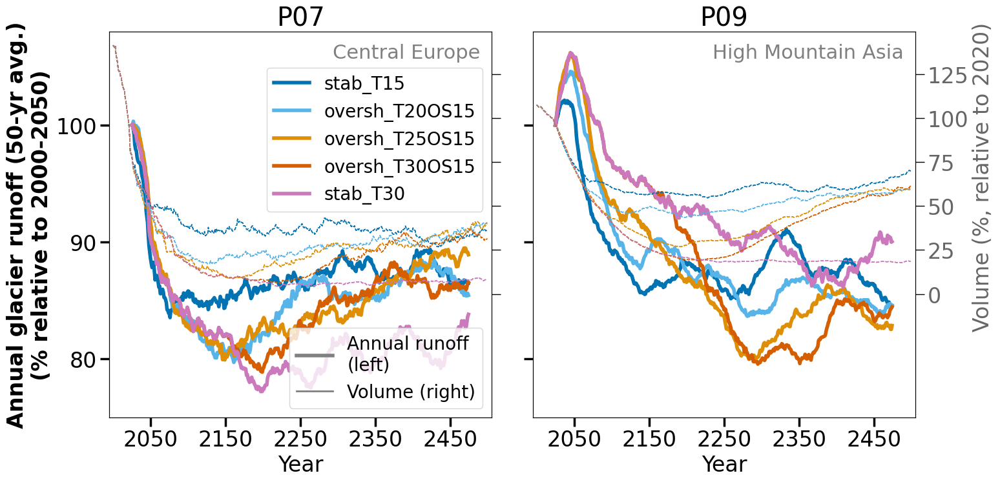

In [38]:
var = 'temp_20yr_avg'

plt.rc('font', size=24)

plt.figure(figsize=(16,8)) #, sharey=True, sharex=True)

for j, Preg in enumerate(['P07', 'P09']):
    plt.subplot(1,2,j+1)
    ax = plt.gca()
    pd_runoff_scenario_rel_reg = pd_runoff_scenario_rel.loc[pd_runoff_scenario_rel.provide_region==Preg]
    sns.lineplot(data=pd_runoff_scenario_rel_reg.loc[pd_runoff_scenario_rel_reg.bias_correction==bc],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
    
    ax.set_title(f'{Preg}')
    plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22)

    plt.ylabel(f'Annual glacier runoff (50-yr avg.)\n(% relative to 2000-2050)', weight='bold')
    ax.set_yticks(np.arange(70,125,10), weight='bold')
   

    ax.set_ylim([75,108]);

    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    
    #####################
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:
        pd_vol_scenario_rel_reg = pd_vol_scenario_rel.loc[pd_vol_scenario_rel.provide_region==Preg]
        sns.lineplot(data=pd_vol_scenario_rel_reg.loc[pd_vol_scenario_rel_reg.bias_correction=='bc_2000_2019'],
                     hue='scenario', x='time', y= 'volume_rel_2020_%', 
                     palette=color_scenario_poster.values(),
                 hue_order=scenarios, legend=True,
                 ax = ax2, lw=1, alpha = 0.6, ls='--')
        

    

        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    

    ax2.set_ylim([-70,149]);
    ax2.set_yticks([0,25,50,75,100], [0,25,50,75,100])
    ax.set_xlabel('Year')

    ax.set_xlim([1995,2505])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([1995,2505])
    ax2.set_yticks(ticks=[0,25,50,75,100,125],
               labels=[0,25,50,75,100,125], alpha=0.6)
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    
    if j ==1:
        ax2.set_ylabel(f'              Volume (%, relative to 2020)',
                      alpha = 0.6)
        ax.set_ylabel('')
        plt.setp(ax.get_yticklabels(), visible=False, fontsize=1)
    else:
        ax2.set_ylabel('')
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
        ax.set_ylabel(f'Annual glacier runoff (50-yr avg.)\n(% relative to 2000-2050)', weight='bold')
        
        
    if j ==0:
        ### add legends
        handles, labels = ax.get_legend_handles_labels()
        ax.get_legend().remove()
        # we take label_2 and handles_2 from the plots above
        handles_2, _ = ax2.get_legend_handles_labels()
        ax2.get_legend().remove()
        leg = ax.legend(handles[:len(scenarios)], scenarios, fontsize=20, loc = 'upper right', bbox_to_anchor=(1,0.93))
        for l in leg.get_lines():
            l.set_linewidth(4)
            
        leg2 = ax.legend([handles[0], handles_2[0]],
                  ['Annual runoff\n(left)', 'Volume '+'(right)'], loc='lower right', fontsize=20, ncol=1)
        leg2.get_lines()[0].set_linewidth(4)
        leg2.get_lines()[1].set_linewidth(1)
        for l in leg2.get_lines():
            l.set_color('grey')
            l.set_linestyle('--')
        ax.add_artist(leg)
    else:
        ax.get_legend().remove()
        ax2.get_legend().remove()

plt.tight_layout()
#plt.savefig('test_provide_reg_runoff_select_vol.pdf')

### Seasonal runoff

In [8]:
bc = 'bc_1980_2019' #'bc_2000_2019'
#df_scenario = xr.open_dataset('filled_sum_all_provide_reg_oversh_stab_2000_2500.nc').sel(bias_correction=bc)
df_scenario['runoff_m_50_yr_avg'] = df_scenario.runoff_monthly.isel(time=slice(0,-1)).rolling(min_periods=50, time=50, center=True).mean()

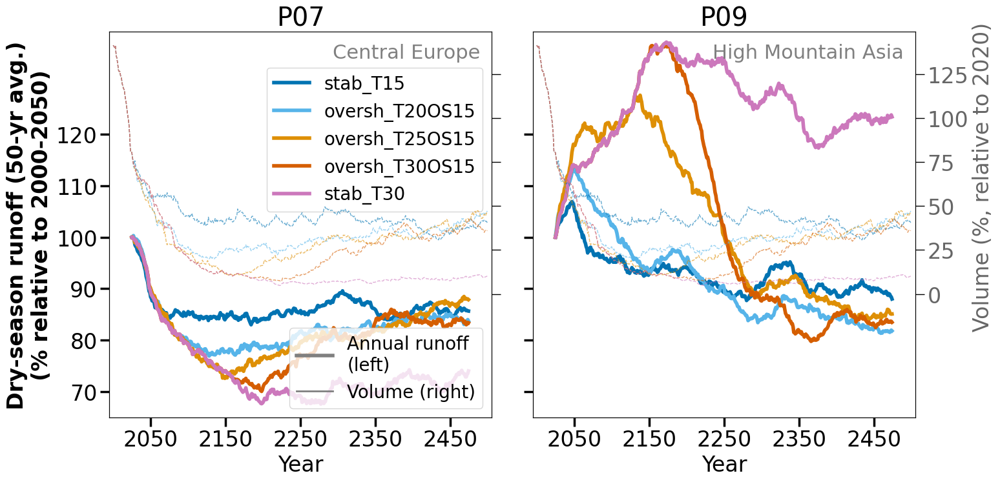

In [89]:
var = 'temp_20yr_avg'

plt.rc('font', size=24)

plt.figure(figsize=(16,8)) #, sharey=True, sharex=True)

for j, Preg in enumerate(['P07', 'P09']):
    plt.subplot(1,2,j+1)
    ax = plt.gca()
    if Preg in ['P09']:
        # in summer monsoon, driest months are Mar-May, Sep-Nov
        dry_m = [3,4,5,9,10,11] #[6,7,8,9] #[1,2,12] #[3,4,5,9,10,11] #[1,2,12] #
    else:
        dry_m = [6,7,8,9]
    df_scenario_m_sel = df_scenario.sel(provide_region=Preg)
    df_scenario_m_sel = df_scenario_m_sel.sel(month_2d =dry_m)
    #print(df_scenario_m_sel.month_2d)
    df_scenario_m_sel = df_scenario_m_sel.sum(dim='month_2d', skipna=True, min_count=len(dry_m))
    pd_runoff_scenario_rel_reg = (100*df_scenario_m_sel/df_scenario_m_sel.sel(time=2025)).runoff_m_50_yr_avg.to_dataframe('runoff_rel_2000_2050_%').reset_index()

    sns.lineplot(data=pd_runoff_scenario_rel_reg.loc[pd_runoff_scenario_rel_reg.bias_correction==bc],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
    
    ax.set_title(f'{Preg}')
    plt.text(0.97,0.97, provide_reg_full_name_dict[Preg],
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22)

    plt.ylabel(f'Dry-season runoff (50-yr avg.)\n(% relative to 2000-2050)', weight='bold')
    ax.set_yticks(np.arange(70,125,10), weight='bold')
   

    ax.set_ylim([65,140]);

    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    
    #####################
    ax2 = ax.twinx()  
    #for scenario in scenarios:
    #                #'stab_T30']:
    sns.lineplot(data=pd_vol_scenario_rel_reg.loc[pd_vol_scenario_rel_reg.bias_correction==bc],
                 hue='scenario', x='time', y= 'volume_rel_2020_%', 
                 palette=color_scenario_poster.values(),
             hue_order=scenarios, legend=True,
             ax = ax2, lw=1, alpha = 0.6, ls='--')
        

    

        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    

    ax2.set_ylim([-70,149]);
    ax2.set_yticks([0,25,50,75,100], [0,25,50,75,100])
    ax.set_xlabel('Year')

    ax.set_xlim([1995,2505])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([1995,2505])
    ax2.set_yticks(ticks=[0,25,50,75,100,125],
               labels=[0,25,50,75,100,125], alpha=0.6)
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    
    if j ==1:
        ax2.set_ylabel(f'              Volume (%, relative to 2020)',
                      alpha = 0.6)
        ax.set_ylabel('')
        plt.setp(ax.get_yticklabels(), visible=False, fontsize=1)
    else:
        ax2.set_ylabel('')
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
        ax.set_ylabel(f'Dry-season runoff (50-yr avg.)\n(% relative to 2000-2050)', weight='bold')
        
        
    if j ==0:
        ### add legends
        handles, labels = ax.get_legend_handles_labels()
        ax.get_legend().remove()
        # we take label_2 and handles_2 from the plots above
        handles_2, _ = ax2.get_legend_handles_labels()
        ax2.get_legend().remove()
        leg = ax.legend(handles[:len(scenarios)], scenarios, fontsize=20, loc = 'upper right', bbox_to_anchor=(1,0.93))
        for l in leg.get_lines():
            l.set_linewidth(4)
            
        leg2 = ax.legend([handles[0], handles_2[0]],
                  ['Annual runoff\n(left)', 'Volume '+'(right)'], loc='lower right', fontsize=20, ncol=1)
        leg2.get_lines()[0].set_linewidth(4)
        leg2.get_lines()[1].set_linewidth(2)
        for l in leg2.get_lines():
            l.set_color('grey')
        ax.add_artist(leg)
    else:
        ax.get_legend().remove()
        ax2.get_legend().remove()

plt.tight_layout()
#plt.savefig('test_provide_reg_runoff_select_vol.pdf')

### Basin plots

In [29]:
import geopandas as gpd
bc = 'bc_1980_2019'
df_scenario_common_basin = xr.open_dataset(f'common_running_sum_all_basins_oversh_stab_2000_2500_bc_1980_2019.nc').sel(bias_correction=bc)
pd_basin_num = gpd.read_file('/home/www/fmaussion/misc/magicc/basins_shape/glacier_basins.shp')
f = open('/home/www/lschuster/provide/provide_glacier_regions/basin_ids_per_provide_region.json')
basins_per_preg = json.load(f)

df_scenario_common_basin['runoff_50_yr_avg'] = df_scenario_common_basin.runoff.isel(time=slice(0,-1)).rolling(min_periods=50, time=50, center=True).mean()
df_scenario_common_basin['runoff_20_yr_min'] = df_scenario_common_basin.runoff.isel(time=slice(0,-1)).rolling(min_periods=20, time=20, center=True).min()
df_scenario_common_basin['runoff_m_50_yr_avg'] = df_scenario_common_basin.runoff_monthly.isel(time=slice(0,-1)).rolling(min_periods=50, time=50, center=True).mean()
pd_runoff_scenario_rel_basin = (100*df_scenario_common_basin/df_scenario_common_basin.sel(time=2025)).runoff_50_yr_avg.to_dataframe('runoff_rel_2000_2050_%').reset_index()

pd_runoff_scenario_rel_basin_20_yr_min = (100*df_scenario_common_basin/df_scenario_common_basin.sel(time=2010)).runoff_20_yr_min.to_dataframe('runoff_min_rel_2000_2020_%').reset_index()
assert np.all(df_scenario_common_basin.runoff.sel(time=slice(2000,2019)).min(dim='time') == df_scenario_common_basin.sel(time=2010).runoff_20_yr_min)

In [32]:
var = 'precip_50yr_avg'
for Preg in df_scenario.provide_region.values:
    basins = basins_per_preg[Preg]
    if len(basins)<1:
        continue
        
    plt.rc('font', size=24)

    plt.figure(figsize=(30,35)) #, sharey=True, sharex=True)
    plt.subplot(5,4,1)
    ax = plt.gca()

    ax.set_ylabel('Annual runoff\n(% relative to 2000-2050)', weight='bold')

    basin = basins[0]
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]
    basin_name = f'{Preg}: {basin_n} ({basin})'
    ax.set_title(basin_name)
    sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=color_scenario_poster.values(),
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    if var != 'temp_20yr_avg':
        ticks = np.arange(95,125,5)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)

    ax2.set_ylim([75,128]);
    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax.set_ylim([60,145]);


    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios', fontsize=20, title_fontsize=22)
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                                  'precipitation changes\n(right, 50-yr avg)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('grey')
    ax.add_artist(leg)


    for j, basin in enumerate(basins[1:]):
        basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]

        plt.subplot(5,4,j+2)
        x_j = np.arange(3,20,4)
        x2_j = np.arange(2,20,4)
            
        ax = plt.gca()
        sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
                     hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                     palette=list(color_scenario_poster.values()),
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        ax.set_title(f'{Preg}: {basin}')

        plt.text(0.97,0.97, basin_n,
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)

        if j in x_j:
            plt.ylabel(f'Annual runoff\n(% relative to 2000-2050)', weight='bold')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        #ax.set_ylim([70,1439.9]);


        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            if var == 'temp_20yr_avg':
                var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
            else:
                var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 1, 
                     ls = '--',
                     lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
        if var != 'temp_20yr_avg':
            ticks = np.arange(95,125,5)
            ax2.set_yticks(ticks=ticks,
                            labels=ticks, alpha=0.6)  
            ylabel = 'near-glacier precipitation (% relative to 2000-2019)'

        else:
            ax2.set_yticks(ticks=[0,1,2,3,4,5],
                       labels=[0,1,2,3,4,5], alpha=0.6)
            ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

        if j in x2_j:
            ax2.set_ylabel(ylabel,
                          alpha = 0.6)
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        #ax2.set_ylim([-0.9,5.9]);
        ax2.set_ylim([75,128]);

        if j >5:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
        ax.set_ylim([60,145]);
    plt.tight_layout()
    plt.savefig(f'figures/figures_basins/3_{Preg}_basin_runoff_{bc}_vs_prcp_poster_iugg_precip_50yr_avg.png')
    plt.close()

In [11]:
var = 'precip_20yr_avg'
for Preg in df_scenario.provide_region.values:
    basins = basins_per_preg[Preg]
    if len(basins)<1:
        continue
        
    plt.rc('font', size=24)

    plt.figure(figsize=(30,35)) #, sharey=True, sharex=True)
    plt.subplot(5,4,1)
    ax = plt.gca()

    ax.set_ylabel('Annual runoff\n(% relative to 2000-2050)', weight='bold')

    basin = basins[0]
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]
    basin_name = f'{Preg}: {basin_n} ({basin})'
    ax.set_title(basin_name)
    sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=color_scenario_poster.values(),
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    if var != 'temp_20yr_avg':
        ticks = np.arange(95,125,5)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)

    ax2.set_ylim([75,128]);
    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax.set_ylim([60,145]);


    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios', fontsize=20, title_fontsize=22)
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                                  r'precipitation changes (right)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('grey')
    ax.add_artist(leg)


    for j, basin in enumerate(basins[1:]):
        basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]

        plt.subplot(5,4,j+2)
        x_j = np.arange(3,20,4)
        x2_j = np.arange(2,20,4)
            
        ax = plt.gca()
        sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
                     hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                     palette=list(color_scenario_poster.values()),
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        ax.set_title(f'{Preg}: {basin}')

        plt.text(0.97,0.97, basin_n,
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)

        if j in x_j:
            plt.ylabel(f'Annual runoff\n(% relative to 2000-2050)', weight='bold')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        #ax.set_ylim([70,1439.9]);


        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            if var == 'temp_20yr_avg':
                var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
            else:
                var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 1, 
                     ls = '--',
                     lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
        if var != 'temp_20yr_avg':
            ticks = np.arange(95,125,5)
            ax2.set_yticks(ticks=ticks,
                            labels=ticks, alpha=0.6)  
            ylabel = 'precipitation relative to 2000-2019\n(glacier-area weighted)'

        else:
            ax2.set_yticks(ticks=[0,1,2,3,4,5],
                       labels=[0,1,2,3,4,5], alpha=0.6)
            ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

        if j in x2_j:
            ax2.set_ylabel(ylabel,
                          alpha = 0.6)
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        #ax2.set_ylim([-0.9,5.9]);
        ax2.set_ylim([75,128]);

        if j >5:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
        ax.set_ylim([60,145]);
    plt.tight_layout()
    plt.savefig(f'figures/figures_basins/3_{Preg}_basin_runoff_{bc}_vs_prcp_poster_iugg.png')
    plt.close()

In [13]:
var = 'precip_20yr_avg'
for Preg in df_scenario.provide_region.values:
    basins = basins_per_preg[Preg]
    if len(basins)<1:
        continue
        
    plt.rc('font', size=24)

    plt.figure(figsize=(30,35)) #, sharey=True, sharex=True)
    plt.subplot(5,4,1)
    ax = plt.gca()

    ax.set_ylabel('50-yr avg. annual runoff\n(% relative to 2000-2050)', weight='bold')

    basin = basins[0]
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]
    basin_name = f'{Preg}: {basin_n} ({basin})'
    ax.set_title(basin_name)
    sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
                 palette=color_scenario_poster.values(),
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    if var != 'temp_20yr_avg':
        ticks = np.arange(95,125,5)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)

    ax2.set_ylim([75,128]);
    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax.set_ylim([60,145]);


    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios', fontsize=20, title_fontsize=22)
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                                  r'precipitation changes (right)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('grey')
    ax.add_artist(leg)


    for j, basin in enumerate(basins[1:]):
        basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]

        plt.subplot(5,4,j+2)
        x_j = np.arange(3,20,4)
        x2_j = np.arange(2,20,4)
            
        ax = plt.gca()
        sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_rel_2000_2050_%',  
                     palette=list(color_scenario_poster.values()),
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        ax.set_title(f'{Preg}: {basin}')

        plt.text(0.97,0.97, basin_n,
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)

        if j in x_j:
            plt.ylabel(f'50-yr avg. annual runoff\n(% relative to 2000-2050)', weight='bold')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        #ax.set_ylim([70,1439.9]);


        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            if var == 'temp_20yr_avg':
                var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
            else:
                var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 1, 
                     ls = '--',
                     lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
        if var != 'temp_20yr_avg':
            ticks = np.arange(95,125,5)
            ax2.set_yticks(ticks=ticks,
                            labels=ticks, alpha=0.6)  
            ylabel = 'precipitation relative to 2000-2019\n(glacier-area weighted)'

        else:
            ax2.set_yticks(ticks=[0,1,2,3,4,5],
                       labels=[0,1,2,3,4,5], alpha=0.6)
            ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

        if j in x2_j:
            ax2.set_ylabel(ylabel,
                          alpha = 0.6)
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        #ax2.set_ylim([-0.9,5.9]);
        ax2.set_ylim([75,128]);

        if j >5:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
        ax.set_ylim([60,145]);
    plt.tight_layout()
    plt.savefig(f'figures/figures_basins/3_{Preg}_basin_50yr_avg_runoff_{bc}_vs_prcp_poster_iugg.png')
    plt.close()

**20-yr minimum annual runoff analysis**

In [14]:
var = 'precip_20yr_avg'
for Preg in df_scenario.provide_region.values:
    basins = basins_per_preg[Preg]
    if len(basins)<1:
        continue
        
    plt.rc('font', size=24)

    plt.figure(figsize=(30,35)) #, sharey=True, sharex=True)
    plt.subplot(5,4,1)
    ax = plt.gca()

    ax.set_ylabel('20-yr min annual runoff\n(% relative to 2000-2019)', weight='bold')

    basin = basins[0]
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]
    basin_name = f'{Preg}: {basin_n} ({basin})'
    ax.set_title(basin_name)
    sns.lineplot(data=pd_runoff_scenario_rel_basin_20_yr_min.loc[pd_runoff_scenario_rel_basin_20_yr_min.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_min_rel_2000_2020_%', 
                 palette=color_scenario_poster.values(),
                 hue_order=scenarios,lw=4, legend=True,
                 ax = ax)
    #ax.set_xlabel('Year')
    #ax.grid(axis='x')
    ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')

    for axis in 'left', 'bottom':
        ax.spines[axis].set_linewidth(1.5)

    # set the parameters for both axis: label size in font points, the line tick line 
    # width and length in pixels
    ax.tick_params(axis='both', which='major', width=2, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
    ax2.set_ylabel('')
    if var != 'temp_20yr_avg':
        ticks = np.arange(95,125,5)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)

    ax2.set_ylim([75,128]);
    plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
    ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax.set_ylim([60,145]);


    ### add legends
    handles, labels = ax.get_legend_handles_labels()
    ax.get_legend().remove()
    handles_2, labels_2 = ax2.get_legend_handles_labels()
    leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], title='Scenarios', fontsize=20, title_fontsize=22)
    for l in leg.get_lines():
        l.set_linewidth(4)
    leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                                  r'precipitation changes (right)'],
                     loc='lower right', ncol=1, fontsize=20)
    leg2.get_lines()[0].set_linewidth(4)
    leg2.get_lines()[1].set_linewidth(2)
    for l in leg2.get_lines():
        l.set_color('grey')
    ax.add_artist(leg)


    for j, basin in enumerate(basins[1:]):
        basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0].split()[0]

        plt.subplot(5,4,j+2)
        x_j = np.arange(3,20,4)
        x2_j = np.arange(2,20,4)
            
        ax = plt.gca()
        sns.lineplot(data=pd_runoff_scenario_rel_basin_20_yr_min.loc[pd_runoff_scenario_rel_basin_20_yr_min.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_min_rel_2000_2020_%',  
                     palette=list(color_scenario_poster.values()),
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

        ax.set_title(f'{Preg}: {basin}')

        plt.text(0.97,0.97, basin_n,
                 transform=ax.transAxes,ha='right',va='top',
                 color='grey', fontsize=22)

        if j in x_j:
            plt.ylabel(f'20-yr min annual runoff\n(% relative to 2000-2019)', weight='bold')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], weight='bold')
        else:
            plt.ylabel('')
            ax.set_yticks(ticks=[0,25,50,75,100,125],
                       labels=[0,25,50,75,100,125], alpha=0, fontsize=1) #visible=False) 
            #plt.setp(ax.get_yticklabels(), visible=False)

        #ax.set_ylim([70,1439.9]);


        ax.tick_params(axis='both', which='major', width=2.5, length=10)
        ax2 = ax.twinx()  
        for scenario in scenarios:
                        #'stab_T30']:

            pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
            pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
            pd_clim_scenario_g.index = pd_clim_scenario_g.year
            temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
            if var == 'temp_20yr_avg':
                var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
            else:
                var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

            ax2.plot(pd_clim_scenario_g.year,
                     var_g_to_ref,
                     alpha = 1, 
                     ls = '--',
                     lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
        if var != 'temp_20yr_avg':
            ticks = np.arange(95,125,5)
            ax2.set_yticks(ticks=ticks,
                            labels=ticks, alpha=0.6)  
            ylabel = 'precipitation relative to 2000-2019\n(glacier-area weighted)'

        else:
            ax2.set_yticks(ticks=[0,1,2,3,4,5],
                       labels=[0,1,2,3,4,5], alpha=0.6)
            ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

        if j in x2_j:
            ax2.set_ylabel(ylabel,
                          alpha = 0.6)
            #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
        else:
            ax2.set_ylabel('')
            #ax2.set_yticks([])
            plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

        #ax2.set_ylim([-0.9,5.9]);
        ax2.set_ylim([75,128]);

        if j >5:
            ax.set_xlabel('Year')
        else:
            ax.set_xlabel('')
        ax.set_xlim([2000,2500])
        ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
        ax2.set_xlim([2000,2500])
        ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
        ax.set_ylim([60,145]);
    plt.tight_layout()
    plt.savefig(f'figures/figures_basins/3_{Preg}_basin_20yr_min_runoff_{bc}_vs_prcp_poster_iugg.png')
    plt.close()

dry season basin plots...

## Basin statistics:

In [36]:
#pd_basins.loc['basin_ind'] = pd_basin_num.loc[pd_basins.index, 'MRBID']

#### get water volume difference, water trough and climate difference statistics for every basin:

In [37]:
water_trough_stats_basins = pd.DataFrame(index = pd_runoff_scenario_rel_basin.basin.unique(),
                                  columns= ['yrs_with_water_trough',  'cumulative_runoff_diff_trough', 
                                            'water_trough_min_year', 'water_trough_max_diff', 'water_trough_start_end'])
for basin in pd_runoff_scenario_rel_basin.basin.unique():

    pd_runoff_scenario_rel_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin==basin]
    # overshoot runoff smaller than 0.9 times stabilisation runoff (both use 50yr avg. runoff)
    sel_oversh = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='oversh_T30OS15']
    sel_oversh.index = sel_oversh.time
    sel_stab = pd_runoff_scenario_rel_basin_sel.loc[pd_runoff_scenario_rel_basin_sel.scenario=='stab_T15']
    sel_stab.index = sel_stab.time
    condi = sel_stab['runoff_rel_2000_2050_%'] - sel_oversh['runoff_rel_2000_2050_%'] > 5 #difference has to be larger thatn 5% 

    # estimate years with water trough
    yrs_trough = sel_stab.where(condi).dropna(how='all').index
    if len(yrs_trough)==0:
        continue
    elif (yrs_trough[-1] - yrs_trough[0]) == len(yrs_trough):
        pass
    else:
        yrs_miss = list(set(np.arange(yrs_trough[0], yrs_trough[-1]))-set(yrs_trough))
        yrs_miss.sort()
        if len(yrs_miss)<1:
            pass
        elif (yrs_miss[-1] - yrs_trough[0] < 10):
            yrs_trough = np.arange(yrs_miss[-1]+1, yrs_trough[-1])
        elif (yrs_trough[-1] - yrs_miss[-1] < 10):
            yrs_trough = np.arange(yrs_trough[0], yrs_miss[-1]-1)

    # estimate runoff differences inside of water trough
    diff = (sel_stab.loc[yrs_trough]['runoff_rel_2000_2050_%'] - sel_oversh.loc[yrs_trough]['runoff_rel_2000_2050_%'])
    try:
        assert np.all(diff >0)
        water_trough_min_yr = int(diff.idxmax())
        water_trough_max_diff = diff.max()
        yrs_trough_start_end = f'{yrs_trough[0]}_{yrs_trough[-1]}'
    except:
        water_trough_min_yr = np.NaN
        water_trough_max_diff = np.NaN
        yrs_trough_start_end = np.NaN

    runoff_diff_trough = diff.sum()
    water_trough_stats_basins.loc[basin] = np.array([len(yrs_trough), runoff_diff_trough,
                                             water_trough_min_yr, water_trough_max_diff, yrs_trough_start_end])
    
water_trough_stats_basins.dropna().loc[water_trough_stats_basins.dropna().yrs_with_water_trough.astype(int)>50]

,yrs_with_water_trough,cumulative_runoff_diff_trough,water_trough_min_year,water_trough_max_diff,water_trough_start_end
4125,184,1104.867,2368,8.377464294433594,2282.0_2465.0
6101,149,1580.526,2267,18.136337280273438,2149.0_2303.0
6104,161,1605.8828,2267,16.247329711914062,2139.0_2300.0
6237,124,619.0812,2230,6.8180084228515625,2141.0_2264.0
6254,126,812.5245,2267,9.349685668945312,2150.0_2295.0
6202,62,362.95703,2199,6.902671813964844,2168.0_2229.0
6241,153,1004.70166,2197,9.585929870605469,2106.0_2258.0
6243,138,672.8556,2201,6.99407958984375,2171.0_2308.0
6223,330,3241.8457,2171,15.326812744140625,2110.0_2440.0
2108,292,2442.0889,2407,12.041473388671875,2155.0_2446.0


In [129]:
from sklearn.linear_model import LinearRegression

for basin in water_trough_stats_basins.index:
    pd_clim_sel_basin = pd_clim_all.loc[pd_clim_all.region ==f'basin_{basin}_glacier']
    pd_clim_sel_basin_oversh = pd_clim_sel_basin.loc[pd_clim_sel_basin.scenario=='oversh_T30OS15'].dropna()
    pd_clim_sel_basin_oversh.index = pd_clim_sel_basin_oversh.year
    pd_clim_sel_basin_stab = pd_clim_sel_basin.loc[pd_clim_sel_basin.scenario=='stab_T15'].dropna()
    pd_clim_sel_basin_stab.index = pd_clim_sel_basin_stab.year
    
    cumsum_temp_diff_oversh_stab_bef2350 = (pd_clim_sel_basin_oversh['temp_20yr_avg'].loc[2100:2350] - pd_clim_sel_basin_stab['temp_20yr_avg'].loc[2100:2350]).sum()
    cumsum_temp_diff_oversh_stab_aft2350 = (pd_clim_sel_basin_oversh['temp_20yr_avg'].loc[2350:] - pd_clim_sel_basin_stab['temp_20yr_avg'].loc[2350:]).sum()
    regional_warming_aft2350 = pd_clim_sel_basin_stab['temp_20yr_avg'].loc[2350:].mean()  - pd_clim_sel_basin_stab['temp_20yr_avg'].loc[2010].mean()
    diff = (pd_clim_sel_basin_oversh['temp_20yr_avg'].loc[2050:2350] - pd_clim_sel_basin_stab['temp_20yr_avg'].loc[2050:2350])
    yr_max = diff.idxmax()
    peak_temp_diff_oversh_vs_stab_bef2350 = diff.loc[yr_max]

    water_trough_stats_basins.loc[basin, 'peak_temp_diff_oversh_vs_stab_bef2350'] = peak_temp_diff_oversh_vs_stab_bef2350
    water_trough_stats_basins.loc[basin, 'yr_peak_temp_diff_oversh_vs_stab_bef2350'] = yr_max
    water_trough_stats_basins.loc[basin, 'regional_warming_aft2350'] = regional_warming_aft2350

    water_trough_stats_basins.loc[basin, 'cumsum_temp_diff_oversh_stab_bef2350']= cumsum_temp_diff_oversh_stab_bef2350
    water_trough_stats_basins.loc[basin, 'cumsum_temp_diff_oversh_stab_aft2350'] = cumsum_temp_diff_oversh_stab_aft2350
    #cumsum_precip_diff_oversh_stab_bef2350 = (pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2050:2350] - pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2050:2350]).sum()
    #cumsum_precip_diff_oversh_stab_aft2350 = (pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2350:] - pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2350:]).sum()

    mean_precip_change_perc_oversh_vs_stab_bef2350 = ((pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2100:2350] / pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2100:2350]).mean() -1)*100
    mean_precip_change_perc_oversh_vs_stab_aft2350 = ((pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2350:] / pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2350:]).mean() - 1)*100
    
    water_trough_stats_basins.loc[basin, 'mean_precip_change_perc_oversh_vs_stab_bef2350'] = mean_precip_change_perc_oversh_vs_stab_bef2350
    water_trough_stats_basins.loc[basin, 'mean_precip_change_perc_oversh_vs_stab_aft2350'] = mean_precip_change_perc_oversh_vs_stab_aft2350
    
    
    water_trough_stats_basins.loc[basin, 'corr_coef_oversh_temp_precip'] = np.corrcoef(pd_clim_sel_basin_oversh['temp_20yr_avg'], pd_clim_sel_basin_oversh['precip_20yr_avg'])[0][1]
    
    model = LinearRegression()
    model.fit(pd_clim_sel_basin_oversh['temp_20yr_avg'].values.reshape(-1,1), pd_clim_sel_basin_oversh['precip_20yr_avg'])
    slope = model.coef_[0]
    water_trough_stats_basins.loc[basin, 'slope_oversh_temp_precip'] = slope
    #ratio_change = (pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2050:2350] / pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2050:2350]) - 1
    #yr_ratio_max = np.abs(ratio_change).idxmax()
    #peak_precip_change_perc_oversh_stab_bef2350 = (ratio_change.loc[yr_ratio_max])*100

    #ratio_change = (pd_clim_sel_basin_oversh['precip_20yr_avg'].loc[2400:] / pd_clim_sel_basin_stab['precip_20yr_avg'].loc[2400:]) - 1
    #yr_ratio_max = np.abs(ratio_change).idxmax()
    #peak_precip_change_perc_oversh_stab_aft2400 = (ratio_change.loc[yr_ratio_max])*100
    
# to compute basins where overshoot creates at least 10 % volume difference 
df_scenario_common_basin['melt_off_on_50yr_avg'] = df_scenario_common_basin.melt_off_on.isel(time=slice(0,-1)).rolling(min_periods=50, time=50, center=True).mean()
df_volume_rel = 100 * df_scenario_common_basin.volume.dropna(dim='time') / df_scenario_common_basin.volume.dropna(dim='time').sel(time=2020)
df_runoff_rel = 100 * df_scenario_common_basin.runoff_50_yr_avg.dropna(dim='time') / df_scenario_common_basin.runoff_50_yr_avg.dropna(dim='time').isel(time=0)
df_melt_off_on_rel = 100 * df_scenario_common_basin.melt_off_on_50yr_avg.dropna(dim='time') / df_scenario_common_basin.melt_off_on_50yr_avg.dropna(dim='time').isel(time=0)
df_runoff_rel_sel = df_runoff_rel.drop_sel(scenario='stab_T12')

rel_volume_basin = 100*df_scenario_common_basin.volume/df_scenario_common_basin.volume.sel(time=2020)
# only select those years where overshoot results in smaller volume
max_volume_diff = (rel_volume_basin.sel(scenario='stab_T15') - rel_volume_basin.sel(scenario='oversh_T30OS15')).max(dim='time').squeeze().to_dataframe('Values')
yr_w_max_volume_diff = (rel_volume_basin.sel(scenario='stab_T15') - rel_volume_basin.sel(scenario='oversh_T30OS15')).idxmax(dim='time').squeeze().to_dataframe('Values')

final_volume_diff_stab_T15_T30 = (rel_volume_basin.sel(scenario='stab_T15') - rel_volume_basin.sel(scenario='stab_T30')).sel(time=2499).squeeze().to_dataframe('Values')
water_trough_stats_basins.loc[max_volume_diff.index, 'max_volume_diff_perc_stab_T15_vs_oversh30'] = max_volume_diff['Values']
water_trough_stats_basins.loc[yr_w_max_volume_diff.index, 'yr_with_max_volume_diff_stab_T15_vs_oversh30'] = yr_w_max_volume_diff['Values']

water_trough_stats_basins.loc[max_volume_diff.index, 'final_volume_diff_stab_T15_T30'] = final_volume_diff_stab_T15_T30['Values']

water_trough_stats_basins['water_trough_max_diff'] = water_trough_stats_basins.water_trough_max_diff.astype(float)
water_trough_stats_basins['max_volume_diff_perc_stab_T15_vs_oversh30'] = water_trough_stats_basins.max_volume_diff_perc_stab_T15_vs_oversh30.astype(float)
water_trough_stats_basins['yrs_with_water_trough'] = water_trough_stats_basins.yrs_with_water_trough.astype(float)
water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350'] = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] / water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_aft2350']

water_trough_stats_basins.loc[pd_basin_num.MRBID.values.astype(str), 'basin_name'] = pd_basin_num.index


# at least 0.1% glaciation 
basin_glac_ind = pd_basin_num.where(pd_basin_num['RGI_AREA'] / pd_basin_num['AREA_CALC']> 0.001).dropna().MRBID.astype(int).astype(str).values
water_trough_stats_basins_sel = water_trough_stats_basins.loc[basin_glac_ind]
print(f'basins 0.1% glaciated:n = {len(water_trough_stats_basins_sel)}')


condi_after_2150 = water_trough_stats_basins['yr_with_max_volume_diff_stab_T15_vs_oversh30']>2080
condi_vol_diff = water_trough_stats_basins_sel['max_volume_diff_perc_stab_T15_vs_oversh30']>10
print('basins that get a larger glacier volume after the overshoot:')
print(len(water_trough_stats_basins_sel['max_volume_diff_perc_stab_T15_vs_oversh30'].where(condi_vol_diff & condi_after_2150).dropna()))

# check if the water trough occurs after overshoot ... 
assert np.all(water_trough_stats_basins_sel.water_trough_min_year.astype(float).dropna() > 2170)

condi_trough = water_trough_stats_basins_sel.yrs_with_water_trough>=20
# all that have a trough and have at least 10%  lager glacier volume 
print('basins that are 0.1% glaciated, have at least a volume difference of 10% and create a water trough after 2170:')
print(len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff & condi_after_2150).dropna()))

assert len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff & condi_after_2150).dropna()) == len(water_trough_stats_basins_sel.where(condi_trough).dropna())


basins 0.1% glaciated:n = 60
basins that get a larger glacier volume after the overshoot:
55
basins that are 0.1% glaciated, have at least a volume difference of 10% and create a water trough after 2170:
32


### let's just choose the most arid basins and the most glaciated ones:

In [43]:
pd_basins_arid_glac = pd_basins.loc[(pd_basins.aridity_index<2) & (pd_basins.glaciated_perc >0.8)]
pd_basins_arid_glac_num = pd_basin_num.loc[pd_basins_arid_glac.index.values]
pd_basins_arid_glac_num['RGI6_vs_basin_area'] = 100*pd_basins_arid_glac_num['RGI_AREA']/pd_basins_arid_glac_num['AREA_CALC']
pd_basins_arid_glac_num['glaciated_perc'] = pd_basins_arid_glac.glaciated_perc
pd_basins_arid_glac_num['aridity_index'] = pd_basins_arid_glac.aridity_index

df_itmix = pd.read_hdf(oggm.utils.get_demo_file('rgi62_itmix_df.h5'))
print(len(df_itmix))
f = open('/home/www/fmaussion/misc/magicc/rgi_ids_per_basin.json')
t = json.load(f)

frgi = utils.file_downloader('https://cluster.klima.uni-bremen.de/~oggm/rgi/rgi62_stats.h5')
#frgi = '/home/users/lschuster/glacierMIP/rgi62_stats.h5'
odf = pd.read_hdf(frgi, index_col=0)
rgi_ids_per_basin_dict = {}
for basin in pd_basins_arid_glac_num.MRBID:

    rgis_basin = t[str(basin)]
    # remove connectivity level 2 glaciers only important for P03 (Greenland)
    rgis_basin = odf.loc[rgis_basin].loc[odf.loc[rgis_basin].Connect <2].index.values
    rgis_basin = list(set(rgis_basin))

    pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==basin,'n glaciers'] = int(len(rgis_basin))
    vol_ratio = 100*df_itmix.loc[rgis_basin]['vol_itmix_m3'].sum()/df_itmix['vol_itmix_m3'].sum()
    pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==basin,'Initial volume relative'] = vol_ratio

    rgi_ids_per_basin_dict[str(basin)] = rgis_basin
pd_basins_arid_glac_num['Initial volume relative'] = pd_basins_arid_glac_num['Initial volume relative'].round(2).values
pd_basins_arid_glac_num['n glaciers'] = pd_basins_arid_glac_num['n glaciers'].astype(int)

    #import dataframe_image as dfi
    #dfi.export(pd_provide_reg, "table_basin.png", table_conversion='matplotlib')

In [49]:
len(rgi_ids_per_basin_dict['3423'])

246

In [50]:
pd_basins_arid_glac_num

,MRBID,RIVER_BASI,CONTINENT,OCEAN,SEA,AREA_CALC,Shape_Leng,Shape_Area,RGI_AREA,geometry,RGI6_vs_basin_area,glaciated_perc,aridity_index,n glaciers,Initial volume relative
INDUS,2309,INDUS,Asia,Indian Ocean,Arabian Sea,865012.6,81.286291,82.852275,27206.546,"MULTIPOLYGON (((67.44167 23.97006, 67.44028 23...",3.145220,2.361021,0.54,23424,1.49
TARIM,2914,TARIM HE (also TALIMU HE),Asia,---,---,1563201.7,93.222224,163.124573,26142.022,"POLYGON ((98.90833 38.28750, 98.88924 38.28715...",1.672338,2.343318,0.64,20791,1.22
ARAL SEA,2902,ARAL SEA,Asia,---,---,1372516.9,126.456933,146.833583,12558.726,"POLYGON ((60.03750 48.56250, 60.02674 48.56215...",0.915014,1.230728,0.45,16211,0.53
GANGES,2306,GANGES,Asia,Indian Ocean,Bay of Bengal,1006558.6,122.349983,90.946880,7906.081,"MULTIPOLYGON (((88.02555 21.57150, 88.02361 21...",0.785457,1.094819,0.78,6552,0.30
BALKHASH,2910,LAKE BALKHASH,Asia,---,---,414761.4,52.448948,47.963010,2328.337,"POLYGON ((81.64583 47.35833, 81.62258 47.35798...",0.561368,0.931272,0.55,3142,0.08
SALWEEN,2319,SALWEEN,Asia,Indian Ocean,Andaman Sea,266292.8,74.305674,23.925588,1265.390,"POLYGON ((94.15000 32.44583, 94.15221 32.44527...",0.475187,0.888248,1.80,2134,0.04
ISSYK-KUL,2919,YSYK-KOL (also ISSYK-KUL),Asia,---,---,21918.0,8.855285,2.401350,507.862,"POLYGON ((79.21667 42.41667, 79.21250 42.41667...",2.317100,0.878020,0.55,807,0.01
RHONE,6243,RHONE,Europe,Atlantic Ocean,Mediterranean Sea,96637.6,28.004916,11.197342,917.302,"POLYGON ((6.84167 47.82083, 6.84167 47.81667, ...",0.949219,0.927527,1.90,1169,0.04
RAPEL,3423,RAPEL,South America,Pacific Ocean,South Pacific,13784.5,6.920319,1.351493,234.273,"POLYGON ((-70.02917 -34.28750, -70.02864 -34.2...",1.699539,1.517624,0.67,246,0.01
SANTA,3425,SANTA,South America,Pacific Ocean,South Pacific,11979.2,8.161008,0.980699,354.427,"POLYGON ((-77.18750 -9.83750, -77.18715 -9.856...",2.958687,1.673961,1.50,409,0.01


In [51]:
water_trough_stats_basins.loc[pd_basins_arid_glac_num.MRBID.values.astype(str), 'basin_name'] = pd_basins_arid_glac_num.index

In [52]:
water_trough_stats_basins.loc[pd_basins_arid_glac_num.MRBID.values.astype(str)].dropna().sort_values(by='water_trough_max_diff')

,yrs_with_water_trough,cumulative_runoff_diff_trough,water_trough_min_year,water_trough_max_diff,water_trough_start_end,max_volume_diff_perc_stab_T15_vs_oversh30,yr_with_max_volume_diff_stab_T15_vs_oversh30,final_volume_diff_stab_T15_T30,basin_name
6243,138.0,672.8556,2201,6.994080,2171.0_2308.0,41.848953,2217.0,35.657036,RHONE
2306,89.0,614.71075,2295,8.328995,2275.0_2363.0,38.497173,2183.0,42.534599,GANGES
2309,177.0,1231.7578,2351,10.177536,2269.0_2445.0,30.702286,2218.0,40.473907,INDUS
2910,74.0,497.31525,2429,10.716347,2233.0_2456.0,44.399117,2163.0,51.054722,BALKHASH
2902,293.0,3904.2534,2322,19.000633,2182.0_2474.0,51.783379,2214.0,74.979805,ARAL SEA
2914,211.0,2831.3276,2339,22.318489,2236.0_2470.0,44.537819,2195.0,57.278992,TARIM
3423,298.0,4701.5776,2173,25.726288,2081.0_2458.0,59.652992,2300.0,84.155975,RAPEL


In [53]:
pd_basins_arid_glac_num = pd_basins_arid_glac_num.sort_values(by='aridity_index')

In [54]:
len(pd_basins_arid_glac_num.MRBID)

10

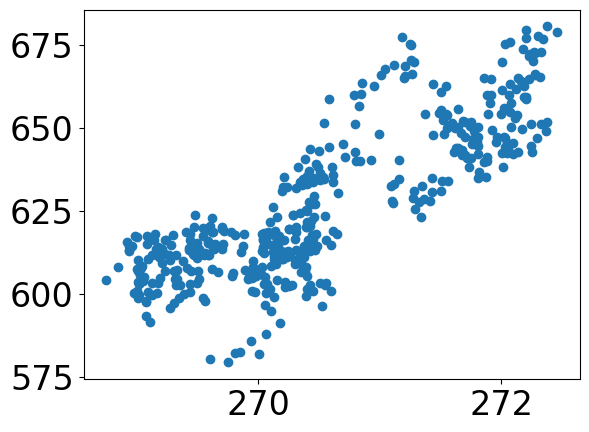

In [55]:
plt.plot(pd_clim_sel_basin_oversh['temp_20yr_avg'] , pd_clim_sel_basin_oversh['precip_20yr_avg'], 'o')

In [56]:

yrs_trough_water = pd_basin_sel_stab_T15_runoff.where(pd_basin_sel_stab_T15_runoff['runoff_rel_2000_2050_%'] - pd_basin_sel_oversh_T30OS15_runoff['runoff_rel_2000_2050_%'] > 5).dropna().index

NameError: name 'pd_basin_sel_stab_T15_runoff' is not defined

In [57]:
yrs_trough_water

NameError: name 'yrs_trough_water' is not defined

In [58]:
pd_basin_sel#['runoff_rel_2000_2050_%']

NameError: name 'pd_basin_sel' is not defined

In [59]:
condi_trough = water_trough_stats_basins_sel.yrs_with_water_trough>=20
water_trough_stats_basins_sel.loc[

SyntaxError: incomplete input (770297797.py, line 2)

no trough water: 2919
no trough water: 3425
no trough water: 2319


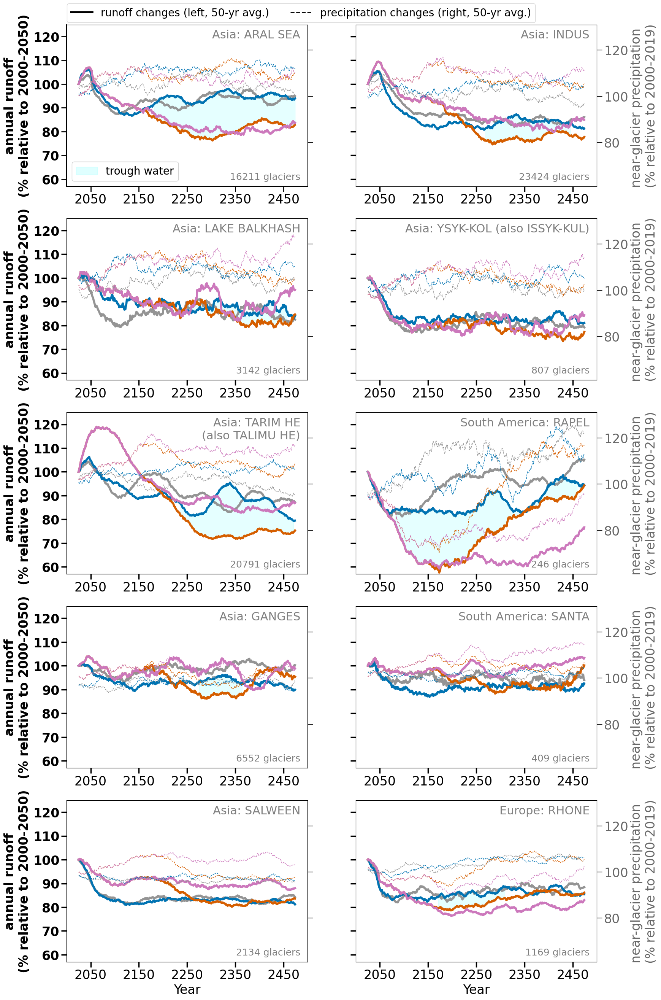

In [61]:
var = 'precip_50yr_avg'
basins = pd_basins_arid_glac_num.MRBID.values

plt.rc('font', size=24)

plt.figure(figsize=(18,32)) #, sharey=True, sharex=True)
plt.subplot(5,2,1)
ax = plt.gca()

ax.set_ylabel('annual runoff\n(% relative to 2000-2050)', weight='bold')

basin = basins[0]
basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()#[0]
n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
basin_name = f'{continent_n}: {basin_n}'
#ax.set_title(basin_name)
sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True, alpha = 0.8,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=np.arange(0,150,10),
              labels=np.arange(0,150,10), weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(80,131,20)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6) 
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

ax.set_ylim([57,125]);
ax2.set_ylim([61,131]);


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                fontsize=20, title_fontsize=22,loc = 'lower left', bbox_to_anchor=(-0.02,1.11), ncol=3)
for l in leg.get_lines():
    l.set_linewidth(4)
    

leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left, 50-yr avg.)',
                                              f'precipitation changes (right, 50-yr avg.)'],
                 loc='lower left', fontsize=20, bbox_to_anchor=(-0.02,0.98), ncol=2)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('black')
# let's not show again the legend ...
#ax.add_artist(leg)

plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

plt.text(0.97,0.03, f'{n_glaciers} glaciers',
     transform=ax.transAxes,ha='right',va='bottom',
     color='grey', fontsize=18, zorder=-1)

y0,y1 = water_trough_stats_basins['water_trough_start_end'].loc[str(basin)].split('_')
pd_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)].dropna()
pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time

ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time, 
                 pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'], 
                 pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'],
                 alpha = 0.1, color='cyan', zorder=-1, label='trough water')
handles_x, labels_x = ax.get_legend_handles_labels()
leg3 = ax.legend([handles_x[-1]], [labels_x[-1]], loc='lower left',fontsize=20)
ax.add_artist(leg3)
ax.add_artist(leg2)


for j, basin in enumerate(basins[1:]):
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()[0]
    n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
    if basin_n=='TARIM HE (also TALIMU HE)':
        basin_n = 'TARIM HE\n(also TALIMU HE)'
    continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
    basin_name = f'{continent_n}: {basin_n}'
    plt.subplot(5,2,j+2)
    x_j = np.arange(1,20,2)
    x2_j = np.arange(0,20,2)

    ax = plt.gca()
    basin_runoff_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)]
    sns.lineplot(data=basin_runoff_sel,
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%',  
                 palette=list(color_scenario_poster.values()),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)

    #ax.set_title(f'{Preg}: {basin}')

    plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)
    plt.text(0.97,0.03, f'{n_glaciers} glaciers',
         transform=ax.transAxes,ha='right',va='bottom',
         color='grey', fontsize=18, zorder=-1)

    if j in x_j:
        plt.ylabel(f'annual runoff\n(% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=np.arange(0,150,10),
                   labels=np.arange(0,150,10), weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=np.arange(0,150,10),
                   labels=np.arange(0,150,10), alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);


    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g
        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    if var != 'temp_20yr_avg':
        ticks = np.arange(80,131,20)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = 'near-glacier precipitation \n(% relative to 2000-2019)' #, glacier-area weighted)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

    if j in x2_j:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

    #ax2.set_ylim([-0.9,5.9]);

    if j >6:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([57,125]);
    ax2.set_ylim([61,131]);

    try:
        y0,y1 = water_trough_stats_basins['water_trough_start_end'].loc[str(basin)].split('_')
        pd_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)].dropna()
        pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
        pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time

        ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time, 
                         pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'], 
                         pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'],
                         alpha = 0.1, color='cyan', zorder=-1)
    except:
        print(f'no trough water: {basin}')
#plt.tight_layout()
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_50yr_avg_runoff_{bc}_vs_prcp_poster_iugg_precip_50yr_avg.png')
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_50yr_avg_runoff_{bc}_vs_prcp_poster_iugg_precip_50yr_avg.pdf')


no trough water: 2919
no trough water: 3425
no trough water: 2319


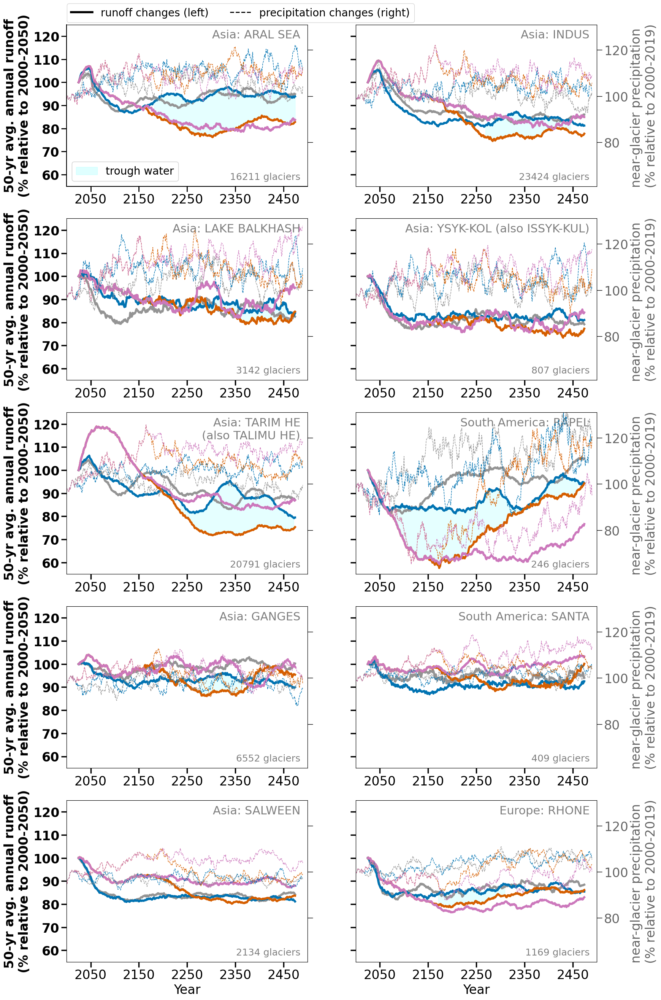

In [525]:
var = 'precip_20yr_avg'
basins = pd_basins_arid_glac_num.MRBID.values

plt.rc('font', size=24)

plt.figure(figsize=(18,32)) #, sharey=True, sharex=True)
plt.subplot(5,2,1)
ax = plt.gca()

ax.set_ylabel('50-yr avg. annual runoff\n(% relative to 2000-2050)', weight='bold')

basin = basins[0]
basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()#[0]
n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
basin_name = f'{continent_n}: {basin_n}'
#ax.set_title(basin_name)
sns.lineplot(data=pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)],
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=np.arange(0,150,10),
              labels=np.arange(0,150,10), weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(80,131,20)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6) 
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])

ax.set_ylim([55,125]);
ax2.set_ylim([61,131]);


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                fontsize=20, title_fontsize=22,loc = 'lower left', bbox_to_anchor=(-0.02,1.11), ncol=3)
for l in leg.get_lines():
    l.set_linewidth(4)
    

leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                              r'precipitation changes (right)'],
                 loc='lower left', fontsize=20, bbox_to_anchor=(-0.02,0.98), ncol=2)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('black')
# let's not show again the legend ...
#ax.add_artist(leg)

plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

plt.text(0.97,0.03, f'{n_glaciers} glaciers',
     transform=ax.transAxes,ha='right',va='bottom',
     color='grey', fontsize=18, zorder=-1)

y0,y1 = water_trough_stats_basins['water_trough_start_end'].loc[str(basin)].split('_')
pd_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)].dropna()
pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time

ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time, 
                 pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'], 
                 pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'],
                 alpha = 0.1, color='cyan', zorder=-1, label='trough water')
handles_x, labels_x = ax.get_legend_handles_labels()
leg3 = ax.legend([handles_x[-1]], [labels_x[-1]], loc='lower left',fontsize=20)
ax.add_artist(leg3)
ax.add_artist(leg2)


for j, basin in enumerate(basins[1:]):
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()[0]
    n_glaciers = pd_basins_arid_glac_num.loc[pd_basins_arid_glac_num.MRBID==int(basin), 'n glaciers'].values[0]
    if basin_n=='TARIM HE (also TALIMU HE)':
        basin_n = 'TARIM HE\n(also TALIMU HE)'
    continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
    basin_name = f'{continent_n}: {basin_n}'
    plt.subplot(5,2,j+2)
    x_j = np.arange(1,20,2)
    x2_j = np.arange(0,20,2)

    ax = plt.gca()
    basin_runoff_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)]
    sns.lineplot(data=basin_runoff_sel,
             hue='scenario', x='time', y= 'runoff_rel_2000_2050_%',  
                 palette=list(color_scenario_poster.values()),
             hue_order=scenarios,lw=4, legend=False,
             ax = ax)

    #ax.set_title(f'{Preg}: {basin}')

    plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)
    plt.text(0.97,0.03, f'{n_glaciers} glaciers',
         transform=ax.transAxes,ha='right',va='bottom',
         color='grey', fontsize=18, zorder=-1)

    if j in x_j:
        plt.ylabel(f'50-yr avg. annual runoff\n(% relative to 2000-2050)', weight='bold')
        ax.set_yticks(ticks=np.arange(0,150,10),
                   labels=np.arange(0,150,10), weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=np.arange(0,150,10),
                   labels=np.arange(0,150,10), alpha=0, fontsize=1) #visible=False) 
        #plt.setp(ax.get_yticklabels(), visible=False)

    #ax.set_ylim([70,1439.9]);


    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g
        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    if var != 'temp_20yr_avg':
        ticks = np.arange(80,131,20)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = 'near-glacier precipitation \n(% relative to 2000-2019)' #, glacier-area weighted)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

    if j in x2_j:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=1)

    #ax2.set_ylim([-0.9,5.9]);

    if j >6:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([55,125]);
    ax2.set_ylim([61,131]);

    try:
        y0,y1 = water_trough_stats_basins['water_trough_start_end'].loc[str(basin)].split('_')
        pd_basin_sel = pd_runoff_scenario_rel_basin.loc[pd_runoff_scenario_rel_basin.basin == str(basin)].dropna()
        pd_basin_sel_stab_T15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='stab_T15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_stab_T15_runoff.index = pd_basin_sel_stab_T15_runoff.time
        pd_basin_sel_oversh_T30OS15_runoff = pd_basin_sel.loc[pd_basin_sel.scenario=='oversh_T30OS15'] #['runoff_rel_2000_2050_%']
        pd_basin_sel_oversh_T30OS15_runoff.index = pd_basin_sel_oversh_T30OS15_runoff.time

        ax.fill_between(pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1].time, 
                         pd_basin_sel_stab_T15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'], 
                         pd_basin_sel_oversh_T30OS15_runoff.loc[float(y0):float(y1)+1]['runoff_rel_2000_2050_%'],
                         alpha = 0.1, color='cyan', zorder=-1)
    except:
        print(f'no trough water: {basin}')
#plt.tight_layout()
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_50yr_avg_runoff_{bc}_vs_prcp_poster_iugg.png')
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_50yr_avg_runoff_{bc}_vs_prcp_poster_iugg.pdf')


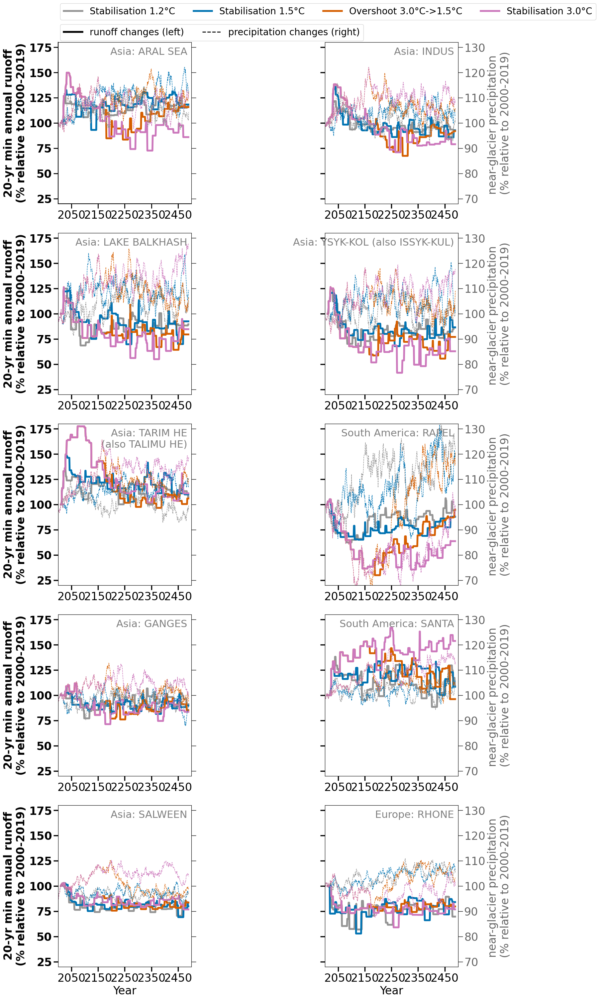

In [41]:
# same for 50-yr minimum anual runoff ... 

var = 'precip_20yr_avg'
basins = pd_basins_arid_glac_num.MRBID.values


plt.rc('font', size=24)

plt.figure(figsize=(16,30)) #, sharey=True, sharex=True)
plt.subplot(5,2,1)
ax = plt.gca()

ax.set_ylabel('20-yr min annual runoff\n(% relative to 2000-2019)', weight='bold')

basin = basins[0]
basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()#[0]
continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
basin_name = f'{continent_n}: {basin_n}'
#ax.set_title(basin_name)
sns.lineplot(data=pd_runoff_scenario_rel_basin_20_yr_min.loc[pd_runoff_scenario_rel_basin_20_yr_min.basin == str(basin)],
             hue='scenario', x='time', y= 'runoff_min_rel_2000_2020_%', 
             palette=color_scenario_poster.values(),
             hue_order=scenarios,lw=4, legend=True,
             ax = ax)
#ax.set_xlabel('Year')
#ax.grid(axis='x')
ax.set_yticks(ticks=[0,25,50,75,100,125, 150, 175],
                   labels=[0,25,50,75,100,125, 150, 175], weight='bold')

for axis in 'left', 'bottom':
    ax.spines[axis].set_linewidth(1.5)

# set the parameters for both axis: label size in font points, the line tick line 
# width and length in pixels
ax.tick_params(axis='both', which='major', width=2, length=10)
ax2 = ax.twinx()  
for scenario in scenarios:
                #'stab_T30']:

    pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
    pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
    pd_clim_scenario_g.index = pd_clim_scenario_g.year
    temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
    if var == 'temp_20yr_avg':
        var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
    else:
        var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

    ax2.plot(pd_clim_scenario_g.year,
             var_g_to_ref,
             alpha = 1, 
             ls = '--',
             lw=1, color = color_scenario[scenario], label=label_scenario[scenario])
ax2.set_ylabel('')
if var != 'temp_20yr_avg':
    ticks = np.arange(70,131,10)
    ax2.set_yticks(ticks=ticks,
                    labels=ticks, alpha=0.6) 
else:
    ax2.set_yticks(ticks=[0,1,2,3,4,5],
               labels=[0,1,2,3,4,5], alpha=0.6)

ax2.set_ylim([68,132]);

plt.setp(ax2.get_yticklabels(), visible=False, fontsize=10)
ax.set_xlabel('')
ax.set_xlim([2000,2500])
ax2.set_xlim([2000,2500])
ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
ax.set_ylim([20,180]);


### add legends
handles, labels = ax.get_legend_handles_labels()
ax.get_legend().remove()
handles_2, labels_2 = ax2.get_legend_handles_labels()
leg = ax.legend(handles[:len(scenarios)], labels_2[:len(scenarios)], #title='Scenarios',
                fontsize=20, title_fontsize=22,loc = 'lower left', bbox_to_anchor=(-0.02,1.11), ncol=4)
for l in leg.get_lines():
    l.set_linewidth(4)
    

leg2 = ax.legend([handles[0], handles_2[0]], ['runoff changes (left)',
                                              r'precipitation changes (right)'],
                 loc='lower left', fontsize=20, bbox_to_anchor=(-0.02,0.98), ncol=2)
leg2.get_lines()[0].set_linewidth(4)
leg2.get_lines()[1].set_linewidth(2)
for l in leg2.get_lines():
    l.set_color('black')
ax.add_artist(leg)

plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)


for j, basin in enumerate(basins[1:]):
    basin_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['RIVER_BASI'].values[0]#.split()[0]
    if basin_n=='TARIM HE (also TALIMU HE)':
        basin_n = 'TARIM HE\n(also TALIMU HE)'
    continent_n = pd_basin_num.loc[pd_basin_num.MRBID==int(basin)]['CONTINENT'].values[0]#.split()#[0]
    basin_name = f'{continent_n}: {basin_n}'
    plt.subplot(5,2,j+2)
    x_j = np.arange(1,20,2)
    x2_j = np.arange(0,20,2)

    ax = plt.gca()
    sns.lineplot(data=pd_runoff_scenario_rel_basin_20_yr_min.loc[pd_runoff_scenario_rel_basin_20_yr_min.basin == str(basin)],
                 hue='scenario', x='time', y= 'runoff_min_rel_2000_2020_%', 
                 palette=color_scenario_poster.values(),
                 hue_order=scenarios,lw=4, legend=False,
                 ax = ax)

    #ax.set_title(f'{Preg}: {basin}')

    plt.text(0.97,0.97, basin_name,
             transform=ax.transAxes,ha='right',va='top',
             color='grey', fontsize=22, zorder=-1)

    if j in x_j:
        #plt.ylabel(f'50-yr avg. annual runoff\n(% relative to 2000-2050)', weight='bold')
        plt.ylabel('20-yr min annual runoff\n(% relative to 2000-2019)', weight='bold')
        ax.set_yticks(ticks=[0,25,50,75,100,125, 150, 175],
                   labels=[0,25,50,75,100,125, 150, 175], weight='bold')
    else:
        plt.ylabel('')
        ax.set_yticks(ticks=[0,25,50,75,100,125, 150, 175],
                   labels=['','','','','','','',''], weight='bold')
        #ax.set_yticklabels([])
        #ax.set_yticks(ticks=[0,25,50,75,100,125, 150, 175],
        #           labels=[0,25,50,75,100,125, 150, 175], weight='bold')

    #ax.set_ylim([70,1439.9]);


    ax.tick_params(axis='both', which='major', width=2.5, length=10)
    ax2 = ax.twinx()  
    for scenario in scenarios:
                    #'stab_T30']:

        pd_clim_scenario = pd_clim_all.loc[pd_clim_all.scenario==scenario]
        pd_clim_scenario_g = pd_clim_scenario.loc[pd_clim_scenario.region == f'basin_{basin}_glacier']
        pd_clim_scenario_g.index = pd_clim_scenario_g.year
        temp_ref_g, precip_ref_g = pd_clim_scenario_g.loc[2000:2019][['temp','precip']].mean()
        if var == 'temp_20yr_avg':
            var_g_to_ref = pd_clim_scenario_g[var] - temp_ref_g
        else:
            var_g_to_ref = 100*pd_clim_scenario_g[var]/precip_ref_g

        ax2.plot(pd_clim_scenario_g.year,
                 var_g_to_ref,
                 alpha = 1, 
                 ls = '--',
                 lw=1, color = color_scenario_poster[scenario], label=label_scenario[scenario])
    if var != 'temp_20yr_avg':
        ticks = np.arange(70,131,10)
        ax2.set_yticks(ticks=ticks,
                        labels=ticks, alpha=0.6)  
        ylabel = 'near-glacier precipitation \n(% relative to 2000-2019)' #, glacier-area weighted)'

    else:
        ax2.set_yticks(ticks=[0,1,2,3,4,5],
                   labels=[0,1,2,3,4,5], alpha=0.6)
        ylabel = r'$\Delta$T'+'(°C) relative to 2000-2019\n(glacier-area weighted)'

    if j in x2_j:
        ax2.set_ylabel(ylabel,
                      alpha = 0.6)
        #ax2.set_yticks(labels=[0,1,2,3,4], alpha=0.6)
    else:
        ax2.set_ylabel('')
        #ax2.set_yticks([])
        plt.setp(ax2.get_yticklabels(), visible=False, fontsize=10)

    #ax2.set_ylim([-0.9,5.9]);
    ax2.set_ylim([68,132]);

    if j >6:
        ax.set_xlabel('Year')
    else:
        ax.set_xlabel('')
    ax.set_xlim([2000,2500])
    ax.set_xticks([2050,2150,2250,2350,2450],[2050,2150,2250,2350,2450])
    ax2.set_xlim([2000,2500])
    ax2.tick_params(axis='both', which='major', width=1, length=10, grid_alpha =0.6)
    ax.set_ylim([20,180]);
#plt.tight_layout()
plt.savefig(f'figures/figures_basins/3_most_arid_glaciated_basin_20_yr_min_runoff_{bc}_vs_prcp_poster_iugg.png')


In [ ]:
pd_basins.loc[(pd_basins.aridity_index<4) & (pd_basins.glaciated_perc >2)]

,basin_glacier_area_km2,basin_total_area_km2,aridity_index,glaciated_perc
INDUS,26893.8,1139075,0.54,2.361021
TARIM,24645.4,1051731,0.64,2.343318
BRAHMAPUTRA,16606.7,518011,2.70,3.205859
SANTA CRUZ,3027.8,30599,3.47,9.895095
SKAGIT,159.5,7961,2.36,2.003517


**Some additional analysis of basin statistics...**

In [80]:
condi_after_2100 = ((rel_volume_basin.sel(scenario='stab_T15') - rel_volume_basin.sel(scenario='oversh_T30OS15')).idxmax(dim='time')>2100).to_dataframe()
condi_after_2100 = condi_after_2100.loc[condi_after_2100.time == True].index

In [66]:
len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff).dropna())


32

32

In [42]:
water_trough_stats_basins['water_trough_max_diff'] = water_trough_stats_basins.water_trough_max_diff.astype(float)
water_trough_stats_basins['max_volume_diff_perc_stab_T15_vs_oversh30'] = water_trough_stats_basins.max_volume_diff_perc_stab_T15_vs_oversh30.astype(float)
water_trough_stats_basins['yrs_with_water_trough'] = water_trough_stats_basins.yrs_with_water_trough.astype(float)

In [398]:
water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350'] = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] / water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_aft2350']

In [399]:
water_trough_stats_basins.loc[pd_basin_num.MRBID.values.astype(str), 'basin_name'] = pd_basin_num.index

In [400]:
water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350'].min()

-35.945219451549946

In [31]:
# at least 0.1% glaciation 
basin_glac_ind = pd_basin_num.where(pd_basin_num['RGI_AREA'] / pd_basin_num['AREA_CALC']> 0.001).dropna().MRBID.astype(int).astype(str).values
water_trough_stats_basins_sel = water_trough_stats_basins.loc[basin_glac_ind]
print(f'basins 0.1% glaciated:n = {len(water_trough_stats_basins_sel)}')

condi_vol_diff = water_trough_stats_basins_sel['max_volume_diff_perc_stab_T15_vs_oversh30']>10 
len(water_trough_stats_basins_sel.where(condi_vol_diff).dropna())


basins 0.1% glaciated:n = 60


In [35]:
water_trough_stats_basins_sel.columns

Index(['yrs_with_water_trough', 'cumulative_runoff_diff_trough',
       'water_trough_min_year', 'water_trough_max_diff',
       'water_trough_start_end'],
      dtype='object')

In [34]:
len(water_trough_stats_basins_sel.dropna())

32

In [401]:
# at least 0.1% glaciation 
basin_glac_ind = pd_basin_num.where(pd_basin_num['RGI_AREA'] / pd_basin_num['AREA_CALC']> 0.001).dropna().MRBID.astype(int).astype(str).values
water_trough_stats_basins_sel = water_trough_stats_basins.loc[basin_glac_ind]
print(len(water_trough_stats_basins_sel))

60


In [402]:
condi_vol_diff = water_trough_stats_basins_sel['max_volume_diff_perc_stab_T15_vs_oversh30']>10 
len(water_trough_stats_basins_sel.where(condi_vol_diff).dropna())


41

In [403]:

condi_trough = water_trough_stats_basins_sel.yrs_with_water_trough>=20
assert len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff).dropna()) == len(water_trough_stats_basins_sel.where(condi_trough).dropna())
len(water_trough_stats_basins_sel.where(condi_trough & condi_vol_diff).dropna())


32

In [130]:
condi_slope_clear = water_trough_stats_basins.corr_coef_oversh_temp_precip**2>0.3
condi_slope_pos = water_trough_stats_basins['slope_oversh_temp_precip'] > 10  # 3% increase on average between 2050 and 2350
condi_slope_neg = water_trough_stats_basins['slope_oversh_temp_precip'] < -10

print(len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_slope_pos& condi_slope_clear).dropna()), len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_slope_neg& condi_slope_clear).dropna()))

13 14


In [131]:
# precipitation decreases with increasing temperatures 
water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna().where(water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna()['slope_oversh_temp_precip']<0)['water_trough_max_diff'].quantile([0.25,0.5,0.75])

0.25    11.992409
0.50    16.354097
0.75    21.622621
Name: water_trough_max_diff, dtype: float64

In [437]:
# precipitation increases with increasing temperatures 
water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna().where(water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna()['slope_oversh_temp_precip']>0)['water_trough_max_diff'].quantile([0.25,0.5,0.75])

0.25     6.818008
0.50     8.725777
0.75    10.716347
Name: water_trough_max_diff, dtype: float64

13
16
32
water trough intensity ratio of decreasing vs increasing prcp basins:
1.963513947996607


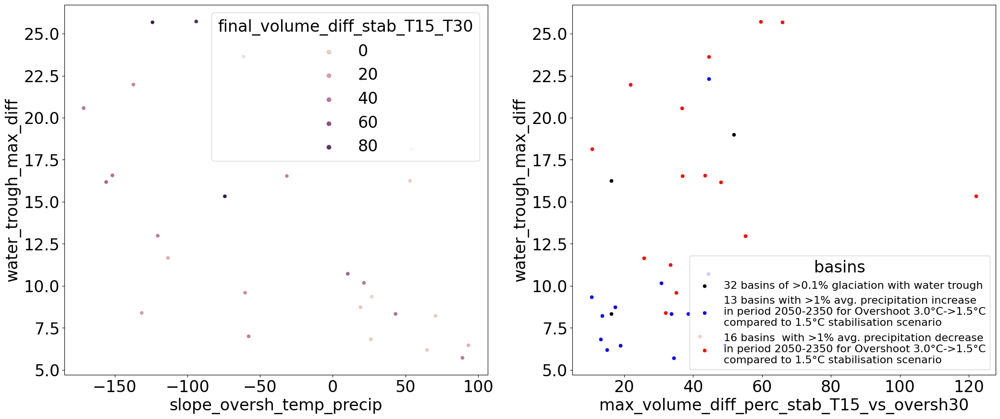

In [151]:
plt.figure(figsize=(25,10))
plt.subplot(121)
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough& condi_slope_clear).dropna(),
                y='water_trough_max_diff',
                x='slope_oversh_temp_precip',
                color='red', hue= 'final_volume_diff_stab_T15_T30') #, label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 

condi_prcp_increase = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] > 1  # 3% increase on average between 2050 and 2350
condi_prcp_decrease = water_trough_stats_basins['mean_precip_change_perc_oversh_vs_stab_bef2350'] < -1

print(len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna()))
print(len(water_trough_stats_basins_sel.where(condi_vol_diff &  condi_prcp_decrease).dropna()))
print(len(water_trough_stats_basins_sel.water_trough_max_diff.dropna()))

plt.subplot(122)
n=len(water_trough_stats_basins_sel.where(condi_trough).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough).dropna(),
                y='water_trough_max_diff',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black', label=f'{n} basins of >0.1% glaciation with water trough') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_trough & condi_prcp_increase).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough & condi_prcp_increase).dropna(),
                y='water_trough_max_diff',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='blue', label=f'{n} basins with >1% avg. precipitation increase\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_trough & condi_prcp_decrease).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough & condi_prcp_decrease).dropna(),
                y='water_trough_max_diff',
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color='red', label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 
#, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax

plt.legend(title='basins', fontsize=16)
print(f'water trough intensity ratio of decreasing vs increasing prcp basins:')
print(water_trough_stats_basins_sel.where(condi_trough & condi_prcp_decrease).dropna().water_trough_max_diff.median() / water_trough_stats_basins_sel.where(condi_trough & condi_prcp_increase).dropna().water_trough_max_diff.median())

<AxesSubplot:xlabel='mean_precip_change_perc_oversh_vs_stab_bef2350', ylabel='water_trough_max_diff'>

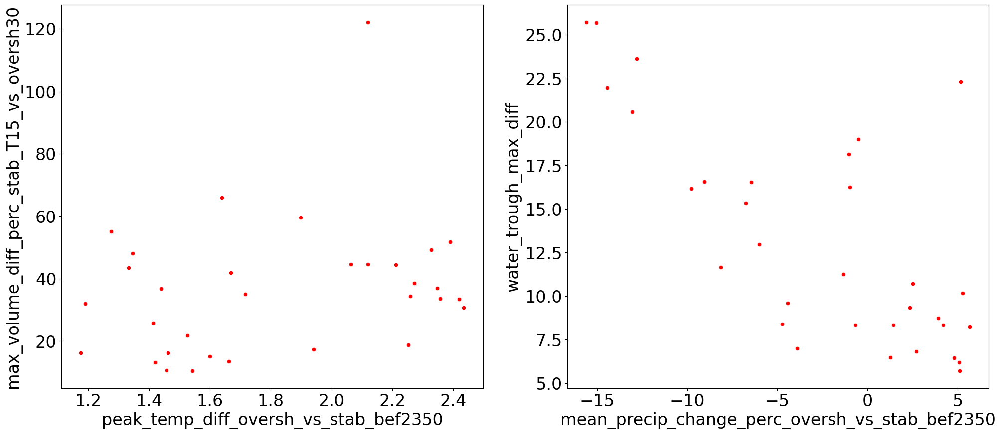

In [146]:
plt.figure(figsize=(24,10))
plt.subplot(121)
#no relation ... 
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough).dropna(),
                y='max_volume_diff_perc_stab_T15_vs_oversh30',
                x='peak_temp_diff_oversh_vs_stab_bef2350',
                color='red') 
plt.subplot(122)
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_trough).dropna(),
                y='water_trough_max_diff',
                x='mean_precip_change_perc_oversh_vs_stab_bef2350',
                color='red') #, 
#label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 f
#or Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 

#, label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 

In [137]:
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna().water_trough_max_diff.median()

8.328994750976562

In [138]:
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna().water_trough_max_diff.median()

16.354097366333008

In [139]:
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna().water_trough_max_diff.median() / water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna().water_trough_max_diff.median()

1.963513947996607

In [152]:
water_trough_stats_basins_sel['cumulative_runoff_diff_trough'] = water_trough_stats_basins_sel.cumulative_runoff_diff_trough.astype(float)
water_trough_stats_basins_sel['yrs_with_water_trough'] = water_trough_stats_basins_sel.yrs_with_water_trough.astype(float)
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna().cumulative_runoff_diff_trough.median() / water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna().cumulative_runoff_diff_trough.median()

5.474030004107053

**The water trough maximum is around 2 times larger for basins where precipitation decreases for warmer temperatures and the cumulative runoff difference is 5 times larger ...** 

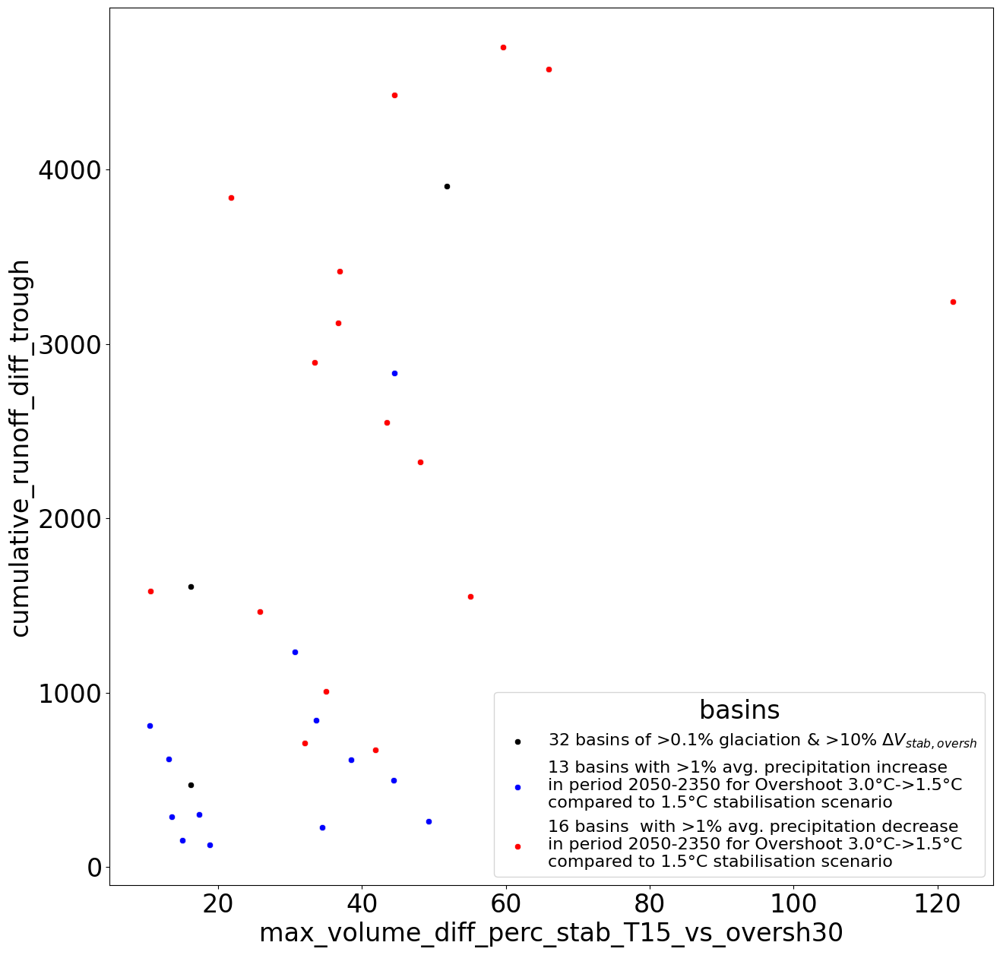

In [153]:
plt.figure(figsize=(15,15))
n=len(water_trough_stats_basins_sel.where(condi_vol_diff).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff).dropna(),
                y='cumulative_runoff_diff_trough',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='black',
                label=f'{n} basins of >0.1% glaciation & >10%'+r' $\Delta V_{stab,oversh}$') #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_increase).dropna(),
                y='cumulative_runoff_diff_trough',
                x='max_volume_diff_perc_stab_T15_vs_oversh30', color='blue',
                label=f'{n} basins with >1% avg. precipitation increase\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario')  #, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax)

n=len(water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna())
sns.scatterplot(data = water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna(),
                y='cumulative_runoff_diff_trough',
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                color='red', label=f'{n} basins  with >1% avg. precipitation decrease\nin period 2050-2350 for Overshoot 3.0°C->1.5°C\ncompared to 1.5°C stabilisation scenario') 
#, hue='mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350') #, ax=ax

plt.legend(title='basins', fontsize=16)

### FROM HERE ON IT SEEMS TO BE OLD CODE ...

In [154]:
water_trough_stats_basins_sel.where(condi_vol_diff & condi_prcp_decrease).dropna()

,yrs_with_water_trough,cumulative_runoff_diff_trough,water_trough_min_year,water_trough_max_diff,water_trough_start_end,max_volume_diff_perc_stab_T15_vs_oversh30,yr_with_max_volume_diff_stab_T15_vs_oversh30,final_volume_diff_stab_T15_T30,peak_temp_diff_oversh_vs_stab_bef2350,yr_peak_temp_diff_oversh_vs_stab_bef2350,regional_warming_aft2350,cumsum_temp_diff_oversh_stab_bef2350,cumsum_temp_diff_oversh_stab_aft2350,mean_precip_change_perc_oversh_vs_stab_bef2350,mean_precip_change_perc_oversh_vs_stab_aft2350,corr_coef_oversh_temp_precip,slope_oversh_temp_precip,mean_precip_change_perc_oversh_vs_stab_bef_vs_aft2350,basin_name
2909,353.0,2895.39600,2407,11.241627,2112.0_2470.0,33.421940,2154.0,25.565689,2.419950,2164.0,0.483426,301.577620,-2.190100,-1.335242,0.128943,0.262851,3.288455,-10.355299,HAR US NUUR
3209,194.0,1464.44090,2208,11.663727,2103.0_2296.0,25.798849,2177.0,13.070430,1.412949,2178.0,0.567756,204.610183,5.009656,-8.141271,1.603344,-0.732688,-113.363468,-5.077683,CHICO
3212,295.0,4427.03200,2173,23.636547,2087.0_2457.0,44.552452,2178.0,55.638535,2.063244,2171.0,0.316435,278.730822,11.968445,-12.810940,0.606532,-0.896785,-61.300748,-21.121610,COLORADO
3401,109.0,710.72064,2193,8.387779,2115.0_2223.0,31.992180,2166.0,20.777956,1.189806,2178.0,0.525136,174.179683,2.941940,-4.726392,1.641886,-0.570223,-131.416933,-2.878636,AISEN
3405,302.0,4574.17330,2174,25.678833,2077.0_2457.0,65.934631,2285.0,93.128883,1.638638,2171.0,0.367808,233.996894,18.726630,-15.070321,0.599683,-0.820148,-123.987459,-25.130467,BIOBIO
3408,191.0,1551.70560,2193,12.978455,2098.0_2295.0,55.086338,2166.0,37.772625,1.275042,2178.0,0.507151,188.767569,2.064581,-6.001937,2.154311,-0.670942,-120.400474,-2.786013,CISNES
3409,365.0,3417.83030,2185,16.533489,2099.0_2463.0,36.897240,2155.0,33.946598,2.347154,2173.0,0.386136,312.980983,-1.156826,-6.451371,4.564056,-0.864830,-31.570167,-1.413517,COPIAPO
3419,236.0,2549.24120,2193,16.568794,2071.0_2306.0,43.419678,2156.0,43.874416,1.332042,2143.0,0.449496,201.636040,6.210392,-9.067946,2.465719,-0.741414,-151.576045,-3.677608,PALENA (also CORCOVADO)
3422,237.0,3120.42160,2174,20.573715,2075.0_2311.0,36.730953,2156.0,41.052319,1.438635,2171.0,0.377590,218.539764,13.600243,-13.078610,2.174788,-0.780447,-171.345921,-6.013740,PUELO
3423,298.0,4701.57760,2173,25.726288,2081.0_2458.0,59.652992,2300.0,84.155975,1.897436,2171.0,0.323204,264.655361,18.651938,-15.610957,-0.111305,-0.857665,-93.923691,140.254202,RAPEL


In [157]:
# 60 glaciers left ...
# only basins where we see differences in the temperature scenarios
water_trough_stats_basins_sel = water_trough_stats_basins_sel.loc[water_trough_stats_basins.final_volume_diff_stab_T15_T30>5].dropna()
print(len(water_trough_stats_basins_sel))
                                              

25


In [158]:
df_runoff_rel_sel = df_runoff_rel.sel(scenario=['stab_T20','stab_T25','stab_T30'])
for y in np.arange(2025,2480,20):
    t = df_runoff_rel_sel.where(df_runoff_rel_sel.sel(time=y).max(dim='scenario') <= 100).dropna(dim='basin')
    tnon = df_runoff_rel_sel.where(df_runoff_rel_sel.sel(time=y).max(dim='scenario') > 100).dropna(dim='basin')

    print(y, len(t.basin), tnon.basin.values)
    if y > 2200:
        print(water_trough_stats_basins.loc[tnon.basin.values].basin_name.values)

2025 71 ['2433' '2902' '3404' '5406']
2045 37 ['4125' '4401' '4406' '4408' '4410' '4414' '4416' '4426' '4427' '4428'
 '4430' '4431' '4435' '6101' '6104' '6110' '6209' '6213' '6219' '6227'
 '6254' '2413' '2108' '2302' '2306' '2309' '2433' '2902' '2905' '2910'
 '2914' '3227' '3425' '3212' '3403' '3409' '3412' '5406']
2065 57 ['4401' '4408' '4428' '4430' '4435' '6104' '6110' '6254' '2413' '2306'
 '2309' '2902' '2914' '3227' '3403' '3412' '3420' '5406']
2085 64 ['4401' '4408' '4430' '4435' '6110' '2413' '2914' '3227' '3403' '3420'
 '5406']
2105 65 ['4401' '4408' '4430' '4435' '6110' '2413' '2914' '3227' '3403' '3420']
2125 66 ['4401' '4408' '4430' '4431' '4435' '2914' '3227' '3403' '3420']
2145 67 ['4401' '4408' '4430' '4435' '2914' '3227' '3403' '3420']
2165 69 ['4401' '4408' '4430' '4435' '3227' '3403']
2185 70 ['4401' '4408' '4435' '3227' '3403']
2205 67 ['4401' '4408' '4435' '6101' '6104' '6110' '3227' '3403']
['ALSEK' 'COPPER' 'YUKON' 'JOKULSA A FJOLLUM' 'LAGARFLJOT' 'SVARTA'
 'MAGDAL

In [90]:
df_melt_off_on_rel_sel = df_melt_off_on_rel.sel(scenario=['stab_T15','stab_T20','stab_T25','stab_T30'])
for y in np.arange(2025,2480,20):
    t = df_melt_off_on_rel_sel.where(df_melt_off_on_rel_sel.sel(time=y).max(dim='scenario') <= 100).dropna(dim='basin')
    tnon = df_melt_off_on_rel_sel.where(df_melt_off_on_rel_sel.sel(time=y).max(dim='scenario') > 100).dropna(dim='basin')

    print(y, len(t.basin), tnon.basin.values, )
    print(water_trough_stats_basins.loc[tnon.basin.values].basin_name.values)

2025 74 ['6110']
['SVARTA']
2045 52 ['4401' '4406' '4408' '4428' '4430' '4435' '6101' '6104' '6110' '6209'
 '6213' '6219' '6227' '6254' '2413' '2108' '2309' '2902' '2914' '3212'
 '3403' '3409' '3412']
['ALSEK' 'COLUMBIA' 'COPPER' 'STIKINE' 'SUSITNA' 'YUKON'
 'JOKULSA A FJOLLUM' 'LAGARFLJOT' 'SVARTA' 'DRAMSELVA' 'GLOMAA'
 'KALIXALVEN' 'LULEALVEN' 'THJORSA' 'KAMCHATKA' 'OB' 'INDUS' 'ARAL SEA'
 'TARIM' 'COLORADO' 'AZOPARDO' 'COPIAPO' 'HUASCO']
2065 64 ['4401' '4408' '4430' '4435' '6104' '6110' '6254' '2413' '2914' '3403'
 '3412']
['ALSEK' 'COPPER' 'SUSITNA' 'YUKON' 'LAGARFLJOT' 'SVARTA' 'THJORSA'
 'KAMCHATKA' 'TARIM' 'AZOPARDO' 'HUASCO']
2085 68 ['4401' '4408' '4430' '4435' '6110' '2914' '3403']
['ALSEK' 'COPPER' 'SUSITNA' 'YUKON' 'SVARTA' 'TARIM' 'AZOPARDO']
2105 70 ['4401' '4408' '4430' '4435' '2914']
['ALSEK' 'COPPER' 'SUSITNA' 'YUKON' 'TARIM']
2125 73 ['4408' '4435']
['COPPER' 'YUKON']
2145 73 ['4408' '4435']
['COPPER' 'YUKON']
2165 73 ['4408' '4435']
['COPPER' 'YUKON']
2185 74 ['6101

In [60]:
df_melt_off_on_rel_sel = df_melt_off_on_rel.drop_sel(scenario='stab_T12')
for y in np.arange(2025,2480,20):
    t = df_melt_off_on_rel_sel.where(df_melt_off_on_rel_sel.sel(time=y).max(dim='scenario') <= 100).dropna(dim='basin')
    tnon = df_melt_off_on_rel_sel.where(df_melt_off_on_rel_sel.sel(time=y).max(dim='scenario') > 100).dropna(dim='basin')

    print(y, len(t.basin), tnon.basin.values)
    if y > 2200:
        print(water_trough_stats_basins.loc[tnon.basin.values].basin_name.values)

2025 73 ['6110' '2902']
2045 52 ['4401' '4406' '4408' '4428' '4430' '4435' '6101' '6104' '6110' '6209'
 '6213' '6219' '6227' '6254' '2413' '2108' '2309' '2902' '2914' '3212'
 '3403' '3409' '3412']
2065 64 ['4401' '4408' '4430' '4435' '6104' '6110' '6254' '2413' '2914' '3403'
 '3412']
2085 68 ['4401' '4408' '4430' '4435' '6110' '2914' '3403']
2105 70 ['4401' '4408' '4430' '4435' '2914']
2125 73 ['4408' '4435']
2145 73 ['4408' '4435']
2165 73 ['4408' '4435']
2185 74 ['6101']
2205 75 []
[]
2225 74 ['6101']
['JOKULSA A FJOLLUM']
2245 75 []
[]
2265 75 []
[]
2285 75 []
[]
2305 75 []
[]
2325 74 ['6223']
['KUBAN']
2345 74 ['6223']
['KUBAN']
2365 74 ['6223']
['KUBAN']
2385 75 []
[]
2405 74 ['3232']
['NEGRO (Atlantic Ocean)']
2425 72 ['6223' '3232' '3405']
['KUBAN' 'NEGRO (Atlantic Ocean)' 'BIOBIO']
2445 74 ['6223']
['KUBAN']
2465 74 ['6223']
['KUBAN']


In [293]:
water_trough_stats_basins.loc[water_trough_stats_basins['max_volume_diff_perc_stab_T15_vs_oversh30']>50]

,yrs_with_water_trough,cumulative_runoff_diff_trough,water_trough_min_year,water_trough_max_diff,water_trough_start_end,peak_temp_diff_oversh_vs_stab_bef2350,yr_peak_temp_diff_oversh_vs_stab_bef2350,cumsum_temp_diff_oversh_stab_bef2350,cumsum_temp_diff_oversh_stab_aft2350,mean_precip_change_perc_oversh_vs_stab_bef2350,mean_precip_change_perc_oversh_vs_stab_aft2350,max_volume_diff_perc_stab_T15_vs_oversh30,yr_with_max_volume_diff_stab_T15_vs_oversh30,final_volume_diff_stab_T15_T30,basin_name
6223,330,3241.8457,2171,15.326813,2110.0_2440.0,2.119093,2168.0,299.847849,0.909798,-6.376446,-0.743856,122.140999,2157.0,98.385727,KUBAN
2902,293,3904.2534,2322,19.000633,2182.0_2474.0,2.389387,2158.0,339.130773,8.714569,0.407523,-2.539464,51.783379,2214.0,74.979805,ARAL SEA
3227,90.0,296.363342,NaN,NaN,NaN,1.907332,2180.0,278.796083,-11.569546,0.454599,-0.938512,76.577713,2224.0,81.663742,MAGDALENA
3425,NaN,NaN,NaN,NaN,NaN,2.199201,2180.0,312.211826,-25.579590,5.295378,1.473310,53.553417,2185.0,61.560760,SANTA
3232,304,4962.279,2174,26.577209,2077.0_2454.0,1.619332,2171.0,259.978330,18.434467,-13.558532,0.688460,62.023376,2178.0,86.826294,NEGRO (Atlantic Ocean)
3405,302,4574.1733,2174,25.678833,2077.0_2457.0,1.638638,2171.0,260.594433,18.726630,-13.702734,0.599683,65.934631,2285.0,93.128883,BIOBIO
3408,191,1551.7056,2193,12.978455,2098.0_2295.0,1.275042,2178.0,205.365761,2.064581,-5.268447,2.154311,55.086338,2166.0,37.772625,CISNES
3423,298,4701.5776,2173,25.726288,2081.0_2458.0,1.897436,2171.0,300.581765,18.651938,-14.891399,-0.111305,59.652992,2300.0,84.155975,RAPEL
5406,17,95.89895,2342,6.145584,2332.0_2348.0,1.529353,2164.0,230.867325,-9.461777,2.117205,0.948581,51.330902,2195.0,48.868553,CLUTHA


<AxesSubplot:xlabel='max_volume_diff_perc_stab_T15_vs_oversh30', ylabel='water_trough_max_diff'>

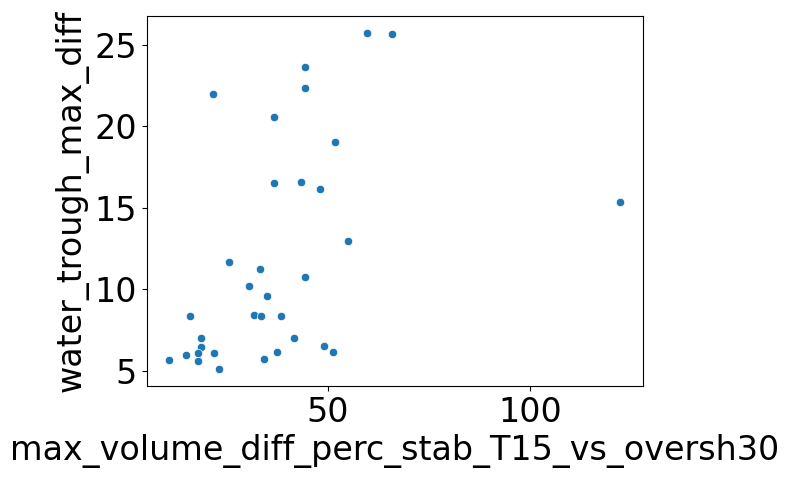

In [294]:
sns.scatterplot(data=water_trough_stats_basins_sel,
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                y='water_trough_max_diff')

In [ ]:
sns.scatterplot(data=water_trough_stats_basins.where(water_trough_stats_basins['cumsum_temp_diff_oversh_stab_bef2350'] / water_trough_stats_basins['cumsum_temp_diff_oversh_stab_aft2350'] > 2).dropna(),
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                y='water_trough_max_diff')

<AxesSubplot:xlabel='max_volume_diff_perc_stab_T15_vs_oversh30', ylabel='water_trough_max_diff'>

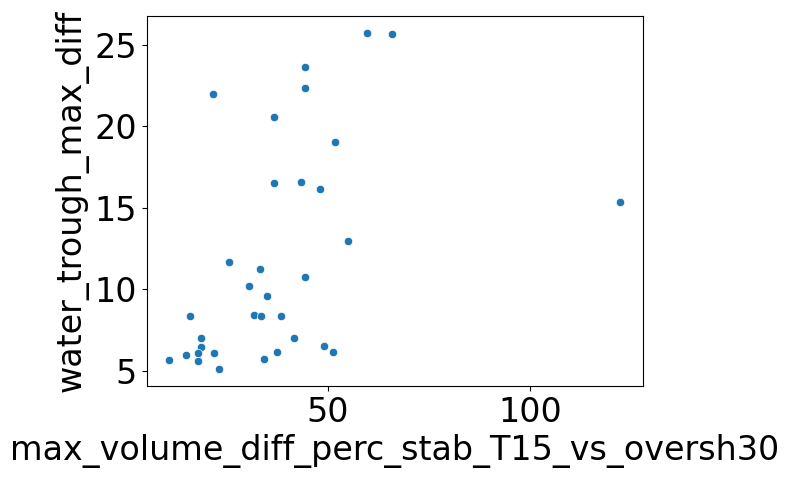

In [295]:
sns.scatterplot(data=water_trough_stats_basins_sel,
                x='max_volume_diff_perc_stab_T15_vs_oversh30',
                y='water_trough_max_diff')

In [297]:
water_trough_stats_basins_sel.columns

Index(['yrs_with_water_trough', 'cumulative_runoff_diff_trough',
       'water_trough_min_year', 'water_trough_max_diff',
       'water_trough_start_end', 'peak_temp_diff_oversh_vs_stab_bef2350',
       'yr_peak_temp_diff_oversh_vs_stab_bef2350',
       'cumsum_temp_diff_oversh_stab_bef2350',
       'cumsum_temp_diff_oversh_stab_aft2350',
       'mean_precip_change_perc_oversh_vs_stab_bef2350',
       'mean_precip_change_perc_oversh_vs_stab_aft2350',
       'max_volume_diff_perc_stab_T15_vs_oversh30',
       'yr_with_max_volume_diff_stab_T15_vs_oversh30',
       'final_volume_diff_stab_T15_T30', 'basin_name'],
      dtype='object')

<AxesSubplot:xlabel='peak_temp_diff_oversh_vs_stab_bef2350', ylabel='mean_precip_change_perc_oversh_vs_stab_bef2350'>

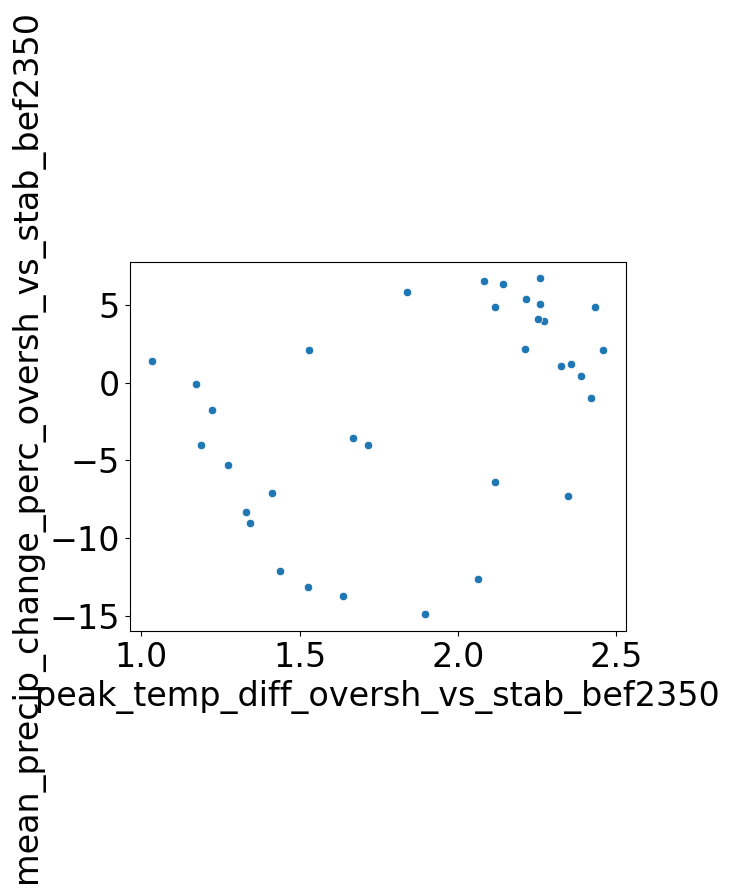

In [298]:
sns.scatterplot(data=water_trough_stats_basins_sel,
                x='peak_temp_diff_oversh_vs_stab_bef2350',
                y='mean_precip_change_perc_oversh_vs_stab_bef2350')

<AxesSubplot:xlabel='peak_temp_diff_oversh_vs_stab_bef2350', ylabel='max_volume_diff_perc_stab_T15_vs_oversh30'>

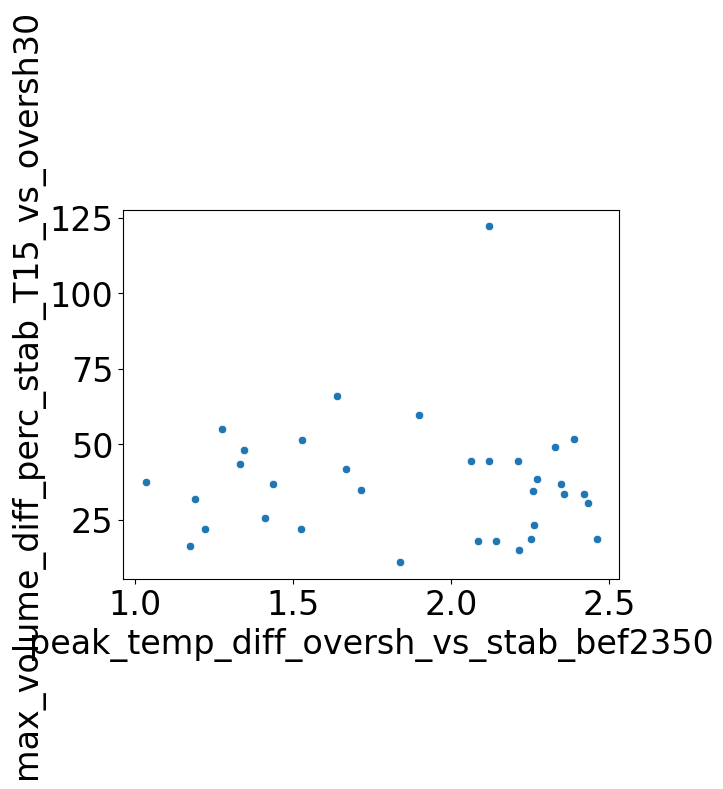

In [296]:
sns.scatterplot(data=water_trough_stats_basins_sel,
                x='peak_temp_diff_oversh_vs_stab_bef2350',
                y='max_volume_diff_perc_stab_T15_vs_oversh30')

<AxesSubplot:xlabel='peak_temp_diff_oversh_vs_stab_bef2350', ylabel='max_volume_diff_perc_stab_T15_vs_oversh30'>

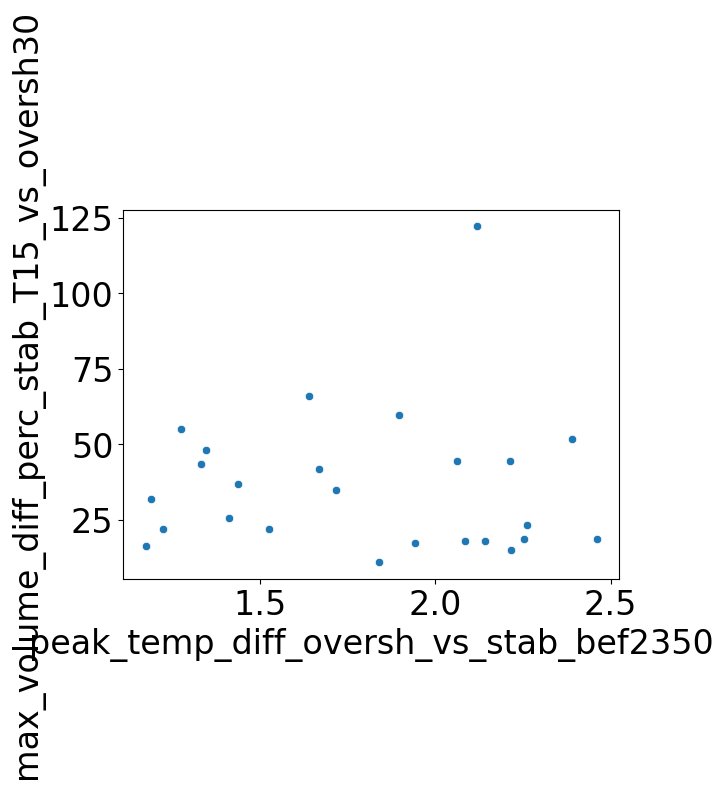

In [262]:
sns.scatterplot(data=water_trough_stats_basins.where(water_trough_stats_basins['cumsum_temp_diff_oversh_stab_bef2350'] / water_trough_stats_basins['cumsum_temp_diff_oversh_stab_aft2350'] > 2).dropna(),
                x='peak_temp_diff_oversh_vs_stab_bef2350',
                y='max_volume_diff_perc_stab_T15_vs_oversh30')

<AxesSubplot:xlabel='peak_temp_diff_oversh_vs_stab_bef2350'>

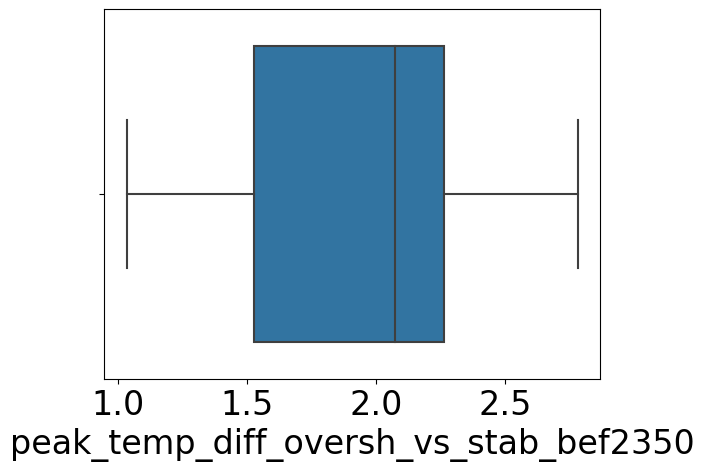

In [264]:
sns.boxplot(data= water_trough_stats_basins, x='peak_temp_diff_oversh_vs_stab_bef2350')

{'whiskers': [<matplotlib.lines.Line2D at 0x7fcf31edda50>,
 'caps': [<matplotlib.lines.Line2D at 0x7fcf31eddff0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fcf31edd780>],
 'medians': [<matplotlib.lines.Line2D at 0x7fcf31ede590>],
 'fliers': [<matplotlib.lines.Line2D at 0x7fcf31ede860>],
 'means': []}

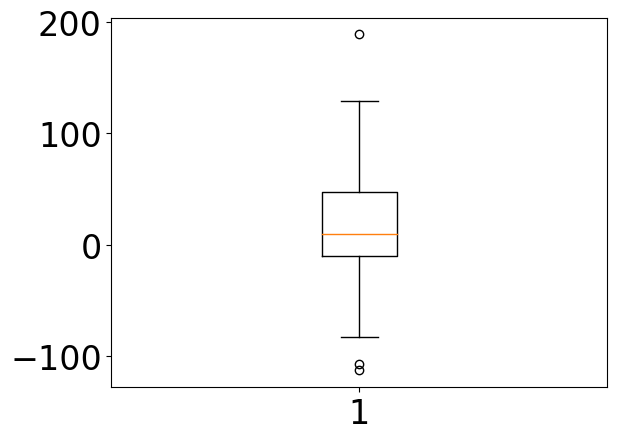

In [270]:
plt.boxplot(water_trough_stats_basins['yr_with_max_volume_diff_stab_T15_vs_oversh30'] - water_trough_stats_basins['yr_peak_temp_diff_oversh_vs_stab_bef2350'])

<AxesSubplot:xlabel='yr_peak_temp_diff_oversh_vs_stab_bef2350', ylabel='yr_with_max_volume_diff_stab_T15_vs_oversh30'>

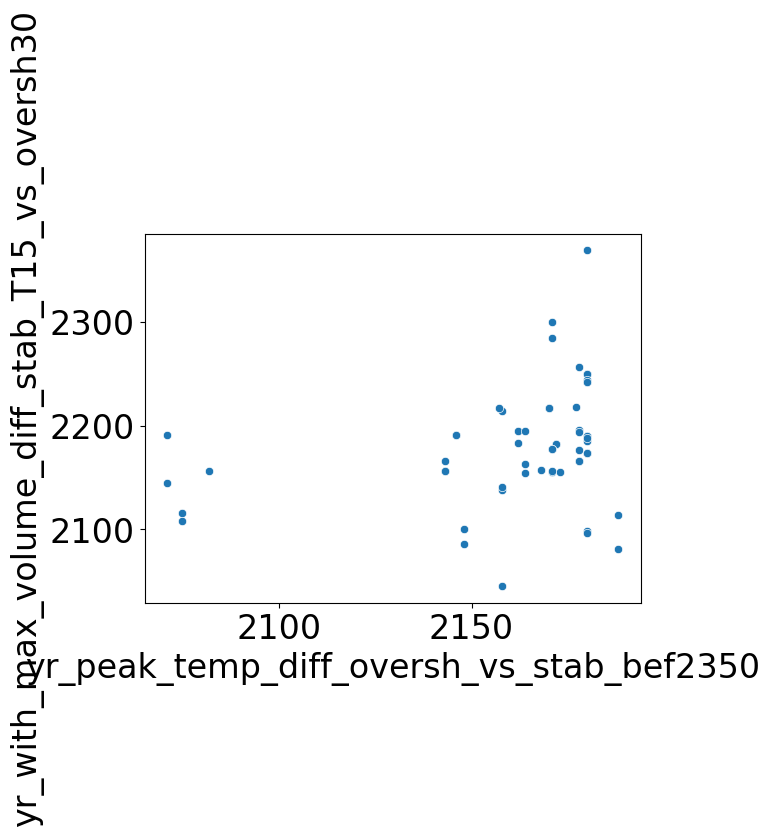

In [267]:
sns.scatterplot(data= water_trough_stats_basins, x='yr_peak_temp_diff_oversh_vs_stab_bef2350', y='yr_with_max_volume_diff_stab_T15_vs_oversh30')

<AxesSubplot:ylabel='peak_temp_diff_oversh_vs_stab_bef2350'>

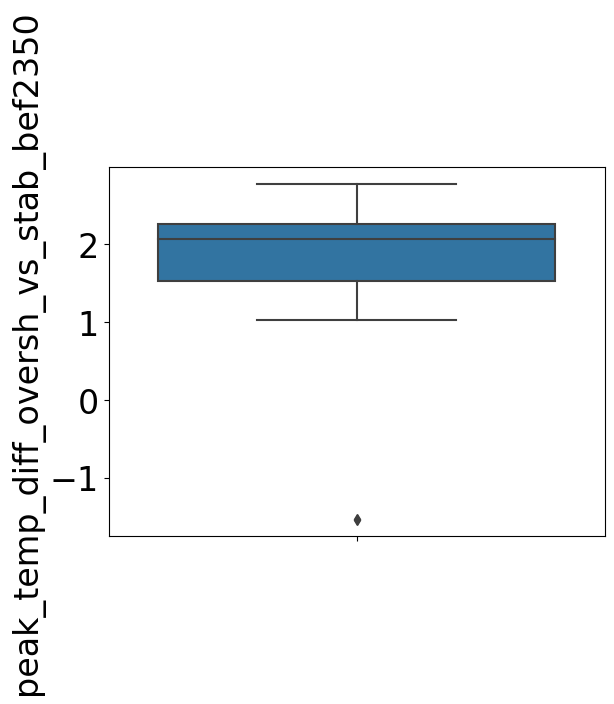

In [248]:
sns.boxplot(data= water_trough_stats_basins, y='peak_temp_diff_oversh_vs_stab_bef2350')

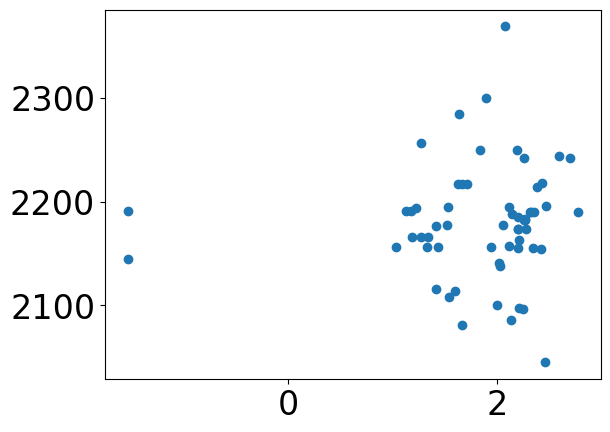

In [239]:
plt.plot(water_trough_stats_basins['peak_temp_diff_oversh_vs_stab_bef2350'], water_trough_stats_basins['yr_with_max_volume_diff_stab_T15_vs_oversh30'], 'o')

plt.plot(water_trough_stats_basins['peak_temp_diff_oversh_vs_stab_bef2350'], water_trough_stats_basins['yr_with_max_volume_diff_stab_T15_vs_oversh30'], 'o')

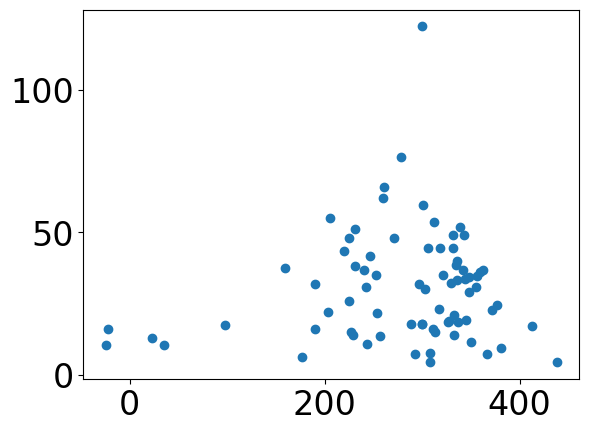

In [194]:
plt.plot(water_trough_stats_basins['peak_temp_diff_oversh_vs_stab_bef2350'], water_trough_stats_basins['max_volume_diff_perc_stab_T15_vs_oversh30'], 'o')

In [96]:
basin = '3403'
#region.unique()

In [102]:
pd_clim_sel_basin.scenario.unique()

array(['stab_T12', 'stab_T15', 'oversh_T20OS15', 'oversh_T25OS15',
       'oversh_T30OS15', 'stab_T20', 'stab_T25', 'stab_T30'], dtype=object)

In [90]:
water_trough_stats_basins

,yrs_with_water_trough,cumulative_runoff_diff_trough,water_trough_min_year,water_trough_max_diff,water_trough_start_end,basin_name
4110,NaN,NaN,NaN,NaN,NaN,NaN
4123,NaN,NaN,NaN,NaN,NaN,NaN
4125,184,1104.867,2368,8.377464294433594,2282.0_2465.0,NaN
4401,13,64.50666,2424,5.667045593261719,2417.0_2429.0,NaN
4406,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...
3423,298,4701.5776,2173,25.726287841796875,2081.0_2458.0,RAPEL
3426,NaN,NaN,NaN,NaN,NaN,NaN
3428,274,3841.2285,2174,21.97225570678711,2071.0_2430.0,NaN
3429,222,2323.8857,2193,16.174705505371094,2085.0_2306.0,NaN
